### basic initialization

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import re
import json
import ast
from matplotlib.ticker import FuncFormatter
import glob
from matplotlib import animation
from scipy.spatial.distance import pdist, squareform
from itertools import combinations
import scipy
from scipy.stats import entropy
from sklearn import manifold
from adjustText import adjust_text
from mpl_toolkits import mplot3d
import networkx as nx
from scipy.spatial import distance
import dask.dataframe as dd

In [106]:
# use this to keep the cells wider, very nice on wide screens, set the percentage as you like it
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:70% !important; }</style>"))

In [2]:
plt.style.available

['bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'seaborn-bright',
 'seaborn-colorblind',
 'seaborn-dark-palette',
 'seaborn-dark',
 'seaborn-darkgrid',
 'seaborn-deep',
 'seaborn-muted',
 'seaborn-notebook',
 'seaborn-paper',
 'seaborn-pastel',
 'seaborn-poster',
 'seaborn-talk',
 'seaborn-ticks',
 'seaborn-white',
 'seaborn-whitegrid',
 'seaborn',
 'Solarize_Light2',
 'tableau-colorblind10',
 '_classic_test']

In [12]:
#plt.rcParams.update(mpl.rcParamsDefault)  # for recovering from xkcd

#plt.style.use('seaborn-white')
#plt.style.use('seaborn-deep')
plt.style.use('seaborn')
#plt.style.use('classic')
# for matplotlib xkcd I need to install new font without root, like this: 
#https://community.linuxmint.com/tutorial/view/29
# and then ivalidate cache like this: 
#https://stackoverflow.com/questions/19663986/getting-xkcd-plots-using-matplotlib/22812176#22812176
# or by deleting by: rm ~/.cache/matplotlib -r
# the font ttf file must be in ~/.fonts/fonts/truetype/humor-sans directory

# to recover from xkcd
#mpl.rcParams.update(saved_state)

# to save state and go to xkcd
#saved_state = mpl.rcParams.copy()
plt.xkcd()
conf = {
    'font.size': 14.0,
    'figure.titlesize': 'x-large',
    'axes.titlesize': 'x-large',
    'axes.labelsize': 'large',
#    'xtick.labelsize': 'medium',
#    'ytick.labelsize': 'medium',
#    'legend.fontsize': 'medium',
    'xtick.labelsize': 'large',
    'ytick.labelsize': 'large',
    'legend.fontsize': 'large',
}

plt.rcParams.update(conf)


### data loading and preparation

In [7]:
animes = pd.read_csv('anime_cleaned.csv')
users = pd.read_csv('users_cleaned.csv')
animelists = pd.read_csv('animelists_cleaned.csv')

In [8]:
users['birth_date'] = pd.to_datetime(users['birth_date'])
users['last_online'] = pd.to_datetime(users['last_online'])
users['join_date'] = pd.to_datetime(users['join_date'])
# renaming possibly array-like columns to end with -s
animes = animes.rename(columns={'genre': 'genres', 'studio': 'studios'})

In [9]:
# setting index for primary identifiers
animes = animes.set_index('anime_id')
users = users.set_index('username')


In [10]:
# having even dirty data which are more complete, for simpler analysis where I don't need so clean data
animes_all = pd.read_csv('anime_filtered.csv')
animes_all = animes_all.rename(columns={'genre': 'genres', 'studio': 'studios'})
animes_all = animes_all.set_index('anime_id')
# calculating year which is already calculated for cleaned data
animes_all['aired_from_year'] = pd.to_datetime(animes['aired'].apply(lambda x: ast.literal_eval(x.replace('\'', '"'))['from']), errors='coerce').dt.year
years_from_string = animes_all['aired_string'].str.extract(r'(\d{4})')
animes_all.loc[animes_all['aired_from_year'].isnull(), 'aired_from_year'] = years_from_string[animes_all['aired_from_year'].isnull()]

In [187]:
animes_dd = dd.from_pandas(animes, npartitions=2)
users_dd = dd.from_pandas(users, npartitions=2)
animelists_dd = dd.from_pandas(animelists, npartitions=2)
animes_all_dd = dd.from_pandas(animes_all, npartitions=2)

### starting analysis

In [12]:
animes.columns

Index(['title', 'title_english', 'title_japanese', 'title_synonyms',
       'image_url', 'type', 'source', 'episodes', 'status', 'airing',
       'aired_string', 'aired', 'duration', 'rating', 'score', 'scored_by',
       'rank', 'popularity', 'members', 'favorites', 'background', 'premiered',
       'broadcast', 'related', 'producer', 'licensor', 'studios', 'genres',
       'opening_theme', 'ending_theme', 'duration_min', 'aired_from_year'],
      dtype='object')

In [13]:
animes.head()

,title,title_english,title_japanese,title_synonyms,image_url,type,source,episodes,status,airing,...,broadcast,related,producer,licensor,studios,genres,opening_theme,ending_theme,duration_min,aired_from_year
anime_id,,,,,,,,,,,,,,,,,,,,,
11013,Inu x Boku SS,Inu X Boku Secret Service,妖狐×僕SS,Youko x Boku SS,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,12,Finished Airing,False,...,Fridays at Unknown,"{'Adaptation': [{'mal_id': 17207, 'type': 'man...","Aniplex, Square Enix, Mainichi Broadcasting Sy...",Sentai Filmworks,David Production,"Comedy, Supernatural, Romance, Shounen","['""Nirvana"" by MUCC']","['#1: ""Nirvana"" by MUCC (eps 1, 11-12)', '#2: ...",24.0,2012.0
2104,Seto no Hanayome,My Bride is a Mermaid,瀬戸の花嫁,The Inland Sea Bride,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,26,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 759, 'type': 'manga...","TV Tokyo, AIC, Square Enix, Sotsu",Funimation,Gonzo,"Comedy, Parody, Romance, School, Shounen","['""Romantic summer"" by SUN&LUNAR']","['#1: ""Ashita e no Hikari (明日への光)"" by Asuka Hi...",24.0,2007.0
5262,Shugo Chara!! Doki,Shugo Chara!! Doki,しゅごキャラ！！どきっ,"Shugo Chara Ninenme, Shugo Chara! Second Year",https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,51,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 101, 'type': 'manga...","TV Tokyo, Sotsu",NaN,Satelight,"Comedy, Magic, School, Shoujo","['#1: ""Minna no Tamago (みんなのたまご)"" by Shugo Cha...","['#1: ""Rottara Rottara (ロッタラ ロッタラ)"" by Buono! ...",24.0,2008.0
721,Princess Tutu,Princess Tutu,プリンセスチュチュ,NaN,https://myanimelist.cdn-dena.com/images/anime/...,TV,Original,38,Finished Airing,False,...,Fridays at Unknown,"{'Adaptation': [{'mal_id': 1581, 'type': 'mang...","Memory-Tech, GANSIS, Marvelous AQL",ADV Films,Hal Film Maker,"Comedy, Drama, Magic, Romance, Fantasy","['""Morning Grace"" by Ritsuko Okazaki']","['""Watashi No Ai Wa Chiisaikeredo"" by Ritsuko ...",16.0,2002.0
12365,Bakuman. 3rd Season,Bakuman.,バクマン。,Bakuman Season 3,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,25,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 9711, 'type': 'mang...","NHK, Shueisha",NaN,J.C.Staff,"Comedy, Drama, Romance, Shounen","['#1: ""Moshimo no Hanashi (もしもの話)"" by nano.RIP...","['#1: ""Pride on Everyday"" by Sphere (eps 1-13)...",24.0,2012.0


In [14]:
animes[['title', 'type', 'source', 'episodes', 'status',
       'airing', 'aired_string', 'aired', 'duration', 'background',
       'premiered', 'broadcast', 'related', 'producer', 'licensor', 'studios',
       'genres', 'opening_theme', 'ending_theme', 'duration_min']].head()

,title,type,source,episodes,status,airing,aired_string,aired,duration,background,premiered,broadcast,related,producer,licensor,studios,genres,opening_theme,ending_theme,duration_min
anime_id,,,,,,,,,,,,,,,,,,,,
11013,Inu x Boku SS,TV,Manga,12,Finished Airing,False,"Jan 13, 2012 to Mar 30, 2012","{'from': '2012-01-13', 'to': '2012-03-30'}",24 min. per ep.,Inu x Boku SS was licensed by Sentai Filmworks...,Winter 2012,Fridays at Unknown,"{'Adaptation': [{'mal_id': 17207, 'type': 'man...","Aniplex, Square Enix, Mainichi Broadcasting Sy...",Sentai Filmworks,David Production,"Comedy, Supernatural, Romance, Shounen","['""Nirvana"" by MUCC']","['#1: ""Nirvana"" by MUCC (eps 1, 11-12)', '#2: ...",24.0
2104,Seto no Hanayome,TV,Manga,26,Finished Airing,False,"Apr 2, 2007 to Oct 1, 2007","{'from': '2007-04-02', 'to': '2007-10-01'}",24 min. per ep.,NaN,Spring 2007,Unknown,"{'Adaptation': [{'mal_id': 759, 'type': 'manga...","TV Tokyo, AIC, Square Enix, Sotsu",Funimation,Gonzo,"Comedy, Parody, Romance, School, Shounen","['""Romantic summer"" by SUN&LUNAR']","['#1: ""Ashita e no Hikari (明日への光)"" by Asuka Hi...",24.0
5262,Shugo Chara!! Doki,TV,Manga,51,Finished Airing,False,"Oct 4, 2008 to Sep 25, 2009","{'from': '2008-10-04', 'to': '2009-09-25'}",24 min. per ep.,NaN,Fall 2008,Unknown,"{'Adaptation': [{'mal_id': 101, 'type': 'manga...","TV Tokyo, Sotsu",NaN,Satelight,"Comedy, Magic, School, Shoujo","['#1: ""Minna no Tamago (みんなのたまご)"" by Shugo Cha...","['#1: ""Rottara Rottara (ロッタラ ロッタラ)"" by Buono! ...",24.0
721,Princess Tutu,TV,Original,38,Finished Airing,False,"Aug 16, 2002 to May 23, 2003","{'from': '2002-08-16', 'to': '2003-05-23'}",16 min. per ep.,Princess Tutu aired in two parts. The first pa...,Summer 2002,Fridays at Unknown,"{'Adaptation': [{'mal_id': 1581, 'type': 'mang...","Memory-Tech, GANSIS, Marvelous AQL",ADV Films,Hal Film Maker,"Comedy, Drama, Magic, Romance, Fantasy","['""Morning Grace"" by Ritsuko Okazaki']","['""Watashi No Ai Wa Chiisaikeredo"" by Ritsuko ...",16.0
12365,Bakuman. 3rd Season,TV,Manga,25,Finished Airing,False,"Oct 6, 2012 to Mar 30, 2013","{'from': '2012-10-06', 'to': '2013-03-30'}",24 min. per ep.,NaN,Fall 2012,Unknown,"{'Adaptation': [{'mal_id': 9711, 'type': 'mang...","NHK, Shueisha",NaN,J.C.Staff,"Comedy, Drama, Romance, Shounen","['#1: ""Moshimo no Hanashi (もしもの話)"" by nano.RIP...","['#1: ""Pride on Everyday"" by Sphere (eps 1-13)...",24.0


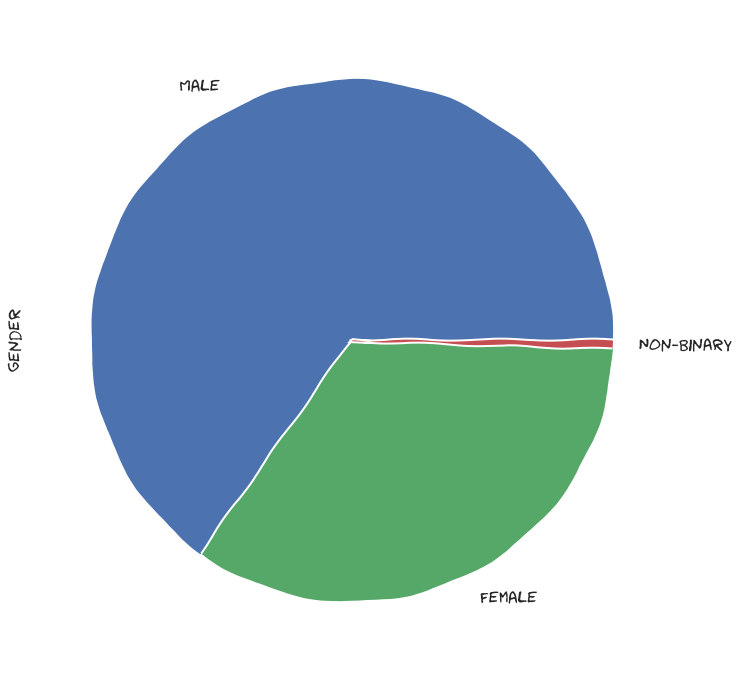

In [15]:
users['gender'].value_counts().plot.pie(figsize=(12, 12))

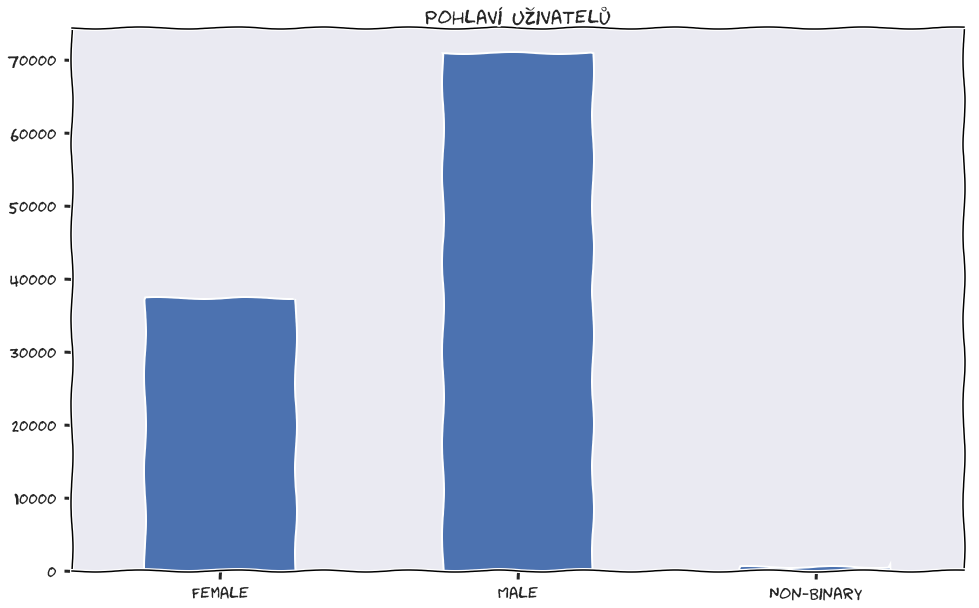

In [17]:
users['gender'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='Pohlaví uživatelů')
plt.xticks(rotation=0)
plt.savefig('graphs/pohlavi-uzivatelu.png', bbox_inches="tight")

In [18]:
users['age'] = 2018 - users['birth_date'].dt.year# todo: maybe fix it and use also month and day

In [19]:
print(users['age'].min())
print(users['age'].max())


10
49


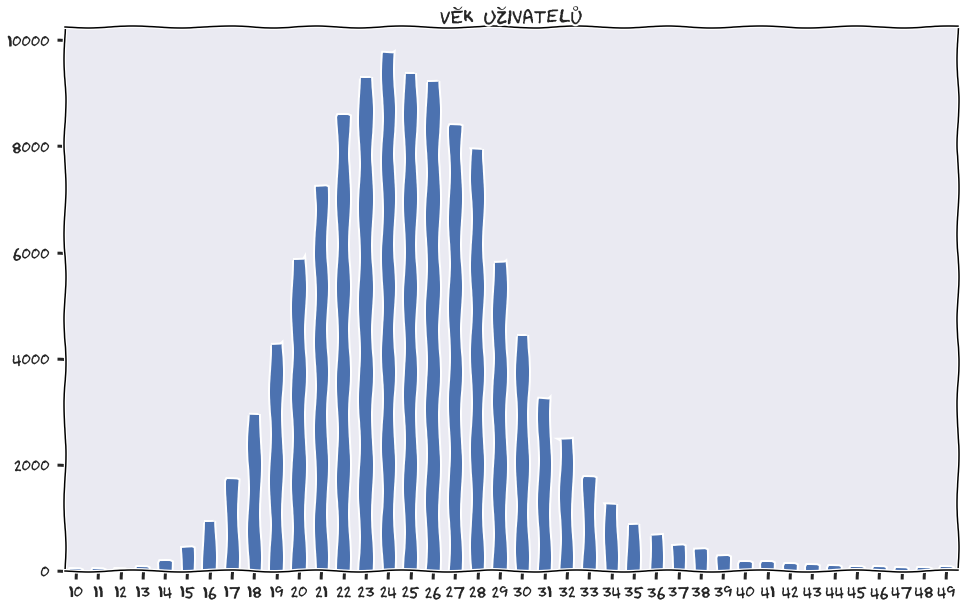

In [20]:
users['age'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='Věk uživatelů')
plt.xticks(rotation=0)
plt.savefig('graphs/vek-uzivatelu.png', bbox_inches="tight")

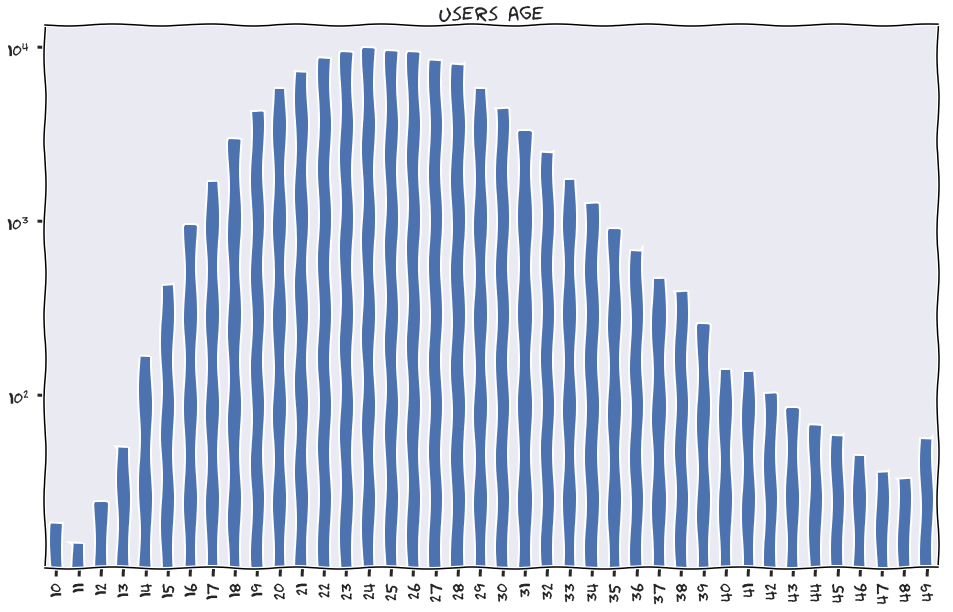

In [22]:
users['age'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='users age', logy=True)

In [23]:
users['age'].describe()

count    108711.000000
mean         25.125820
std           4.632399
min          10.000000
25%          22.000000
50%          25.000000
75%          28.000000
max          49.000000
Name: age, dtype: float64

In [31]:
((users['age'] > 45) | (users['age'] < 10)).sum() / users['age'].count()

0.0015637791943777539

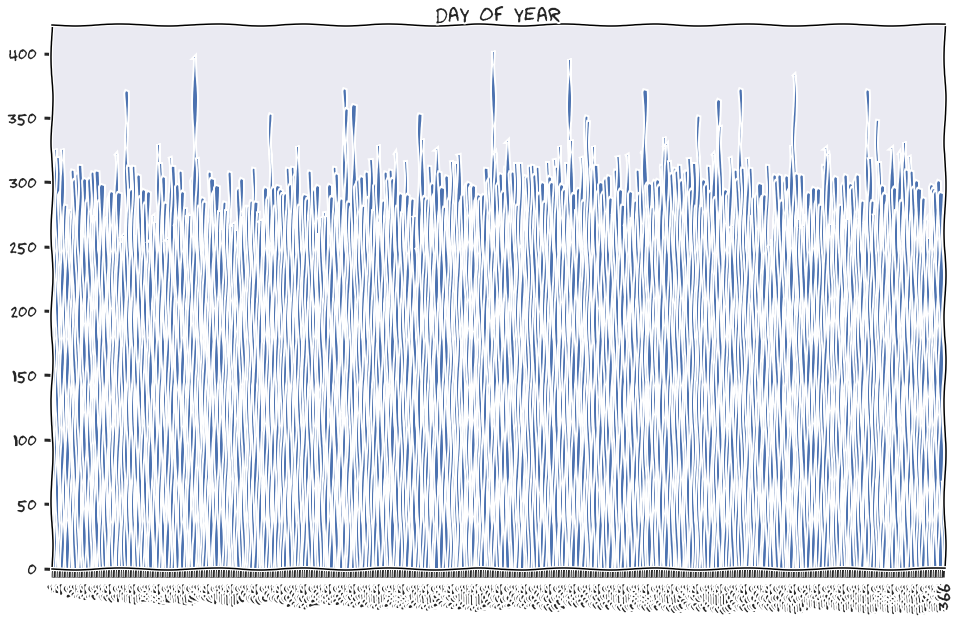

In [32]:
users['birth_date'].dt.dayofyear.value_counts().sort_index().plot.bar(figsize=(16, 10), title='day of year')
plt.show()

In [33]:
display(users[users['birth_date'].dt.dayofyear == 1]['age'].describe())
display(users['age'].describe())


count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: age, dtype: float64

count    108711.000000
mean         25.125820
std           4.632399
min          10.000000
25%          22.000000
50%          25.000000
75%          28.000000
max          49.000000
Name: age, dtype: float64

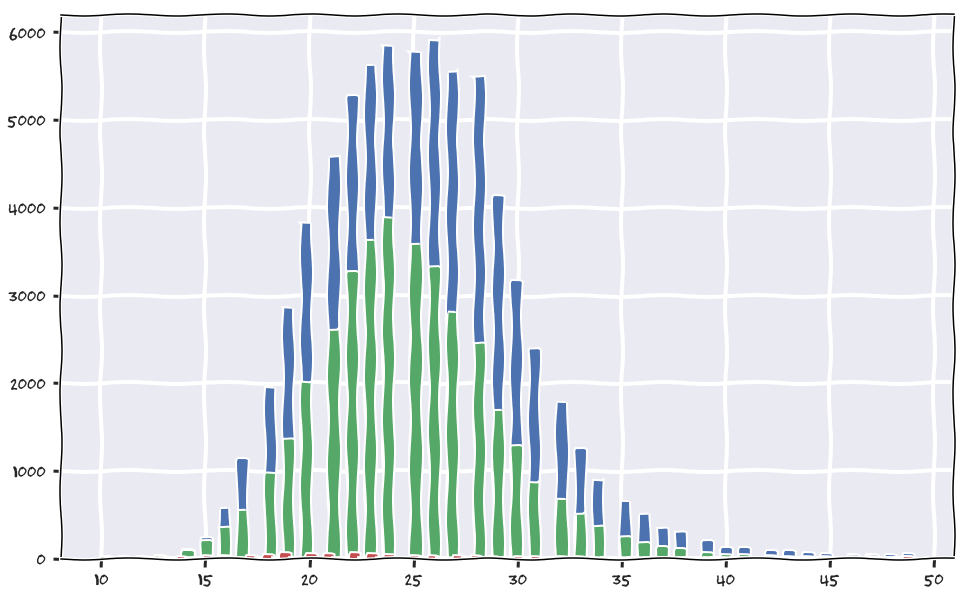

In [34]:
users[users['gender'] == 'Male']['age'].hist(bins=89, figsize=(16,10))
users[users['gender'] == 'Female']['age'].hist(bins=89, figsize=(16,10))
users[users['gender'] == 'Non-Binary']['age'].hist(bins=89, figsize=(16,10))
plt.show()

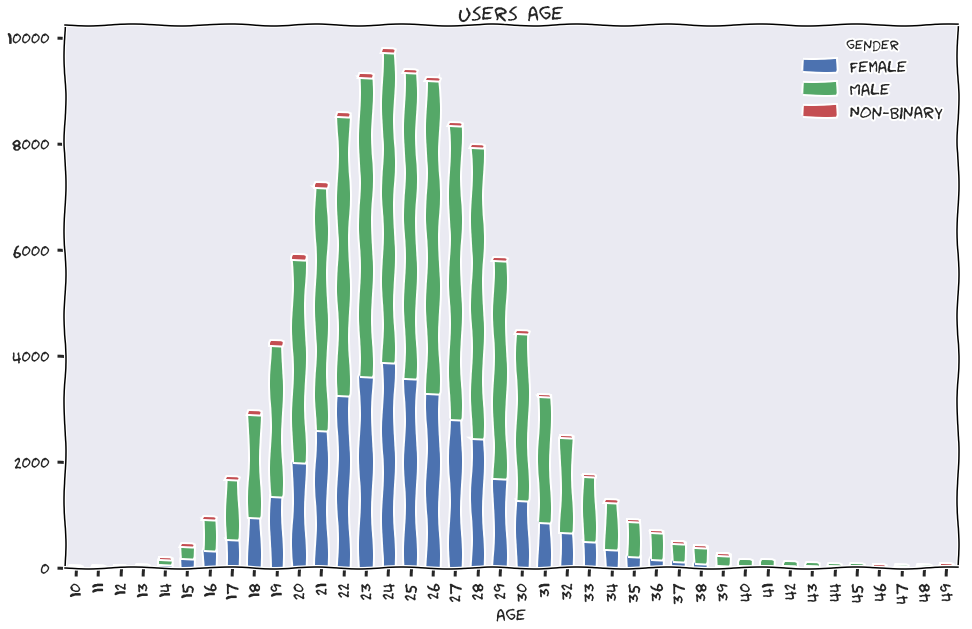

In [35]:
user_gender_age = pd.crosstab(users['age'], users['gender'])
user_gender_age.plot.bar(stacked=True, figsize=(16, 10), title='users age')

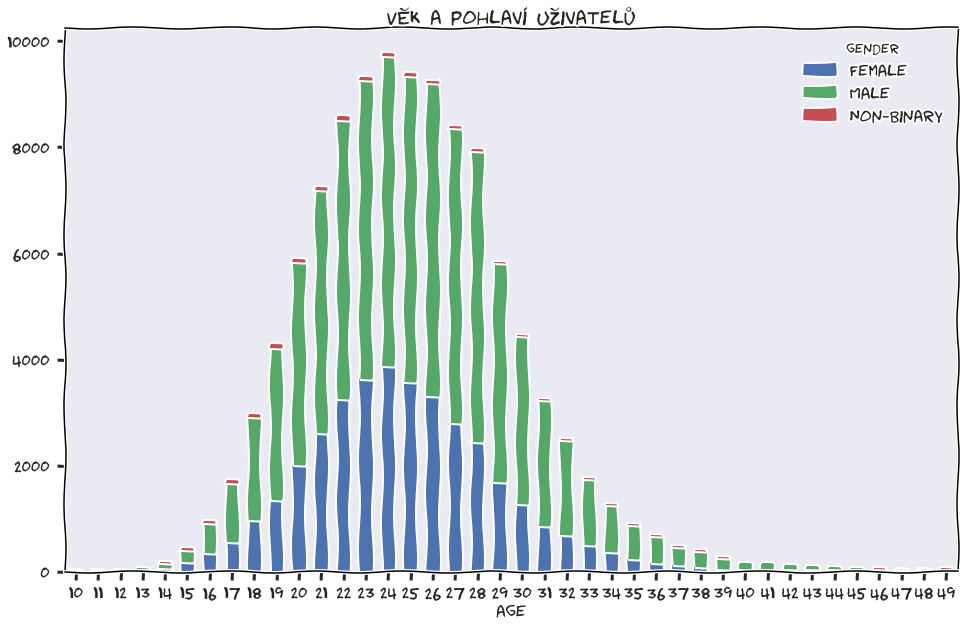

In [36]:
user_gender_age.plot.bar(stacked=True, figsize=(16, 10), title='Věk a pohlaví uživatelů')
plt.xticks(rotation=0)
plt.savefig('graphs/genders-ages.png', bbox_inches="tight")

In [180]:
%%timeit
# here, in animes_genres, is every anime duplicated, once per each genre it contains
animes['genres'].fillna('', inplace=True)
genres_arr = animes['genres'].str.replace(' ', '').str.split(',', expand=True).stack().reset_index(drop=True, level=1).to_frame(name='genre')
genres_arr = genres_arr[genres_arr['genre'] != '']
genres_arr.index.name = 'anime_id'
animes_genres = pd.merge(animes, genres_arr, how='left', left_index=True, right_index=True)

90.4 ms ± 2.76 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [188]:
%%timeit
# here, in animes_genres, is every anime duplicated, once per each genre it contains
animes_dd['genres'] = animes_dd['genres'].fillna('')
genres_dd_arr = animes_dd['genres'].map_partitions(lambda x: x.str.replace(' ', '').str.split(',', expand=True).stack().reset_index(drop=True, level=1)).to_frame(name='genre')
genres_dd_arr = genres_dd_arr[genres_dd_arr['genre'] != '']
genres_dd_arr.index.name = 'anime_id'
animes_genres_dd = animes_dd.merge(genres_dd_arr, how='left', left_index=True, right_index=True).compute()

284 ms ± 29.8 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [183]:
%%timeit
# the same for not cleaned anime
animes_all['genres'].fillna('', inplace=True)
genres_arr_all = animes_all['genres'].str.replace(' ', '').str.split(',', expand=True).stack().reset_index(drop=True, level=1).to_frame(name='genre')
genres_arr_all = genres_arr_all[genres_arr_all['genre'] != '']
genres_arr_all.index.name = 'anime_id'
animes_genres_all = pd.merge(animes_all, genres_arr_all, how='left', left_index=True, right_index=True)

178 ms ± 14 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [189]:
%%timeit
# here, in animes_genres, is every anime duplicated, once per each genre it contains
animes_all_dd['genres'] = animes_all_dd['genres'].fillna('')
genres_dd_arr_all = animes_all_dd['genres'].map_partitions(lambda x: x.str.replace(' ', '').str.split(',', expand=True).stack().reset_index(drop=True, level=1)).to_frame(name='genre')
genres_dd_arr_all = genres_dd_arr_all[genres_dd_arr_all['genre'] != '']
genres_dd_arr_all.index.name = 'anime_id'
animes_genres_all_dd = animes_all_dd.merge(genres_dd_arr_all, how='left', left_index=True, right_index=True).compute()

430 ms ± 44.5 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


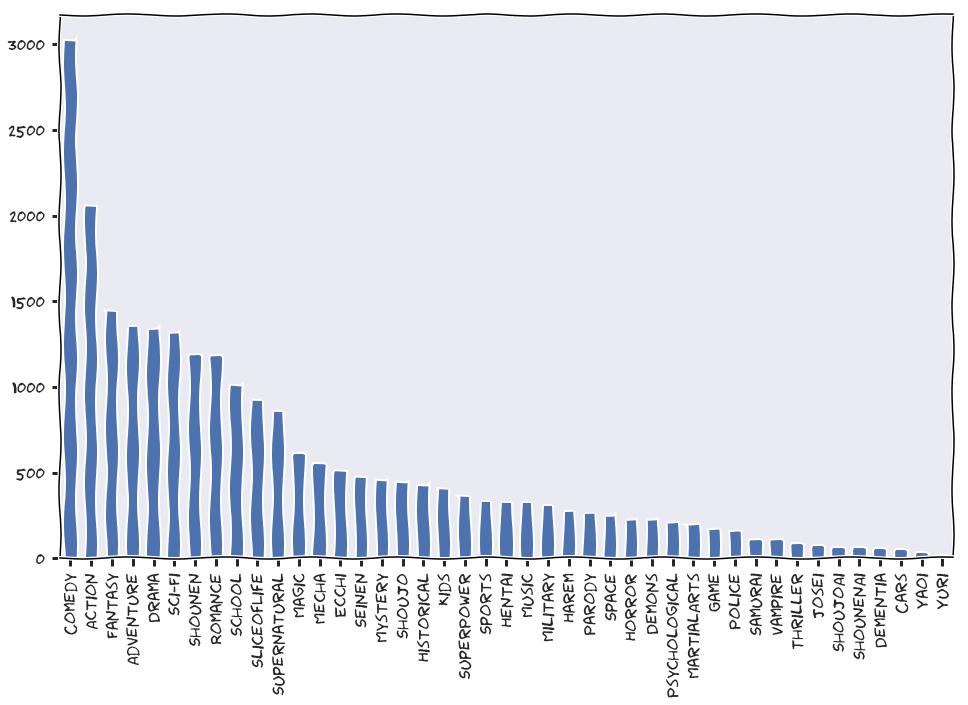

In [28]:
animes_genres['genre'].value_counts().plot(kind='bar', figsize=(16, 10))

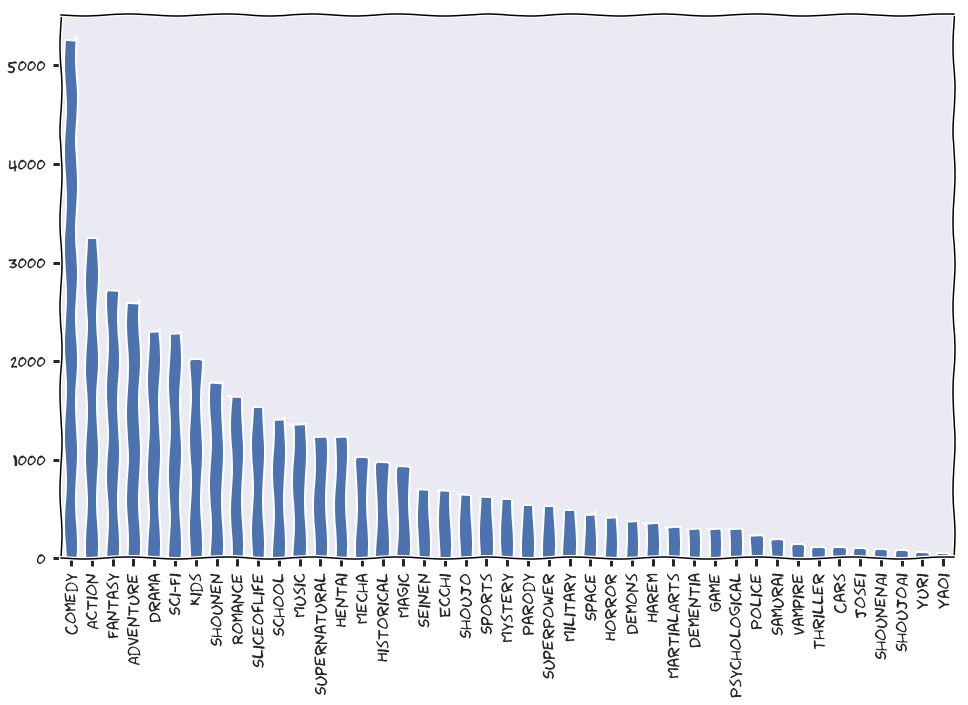

In [29]:
animes_genres_all['genre'].value_counts().plot(kind='bar', figsize=(16, 10))

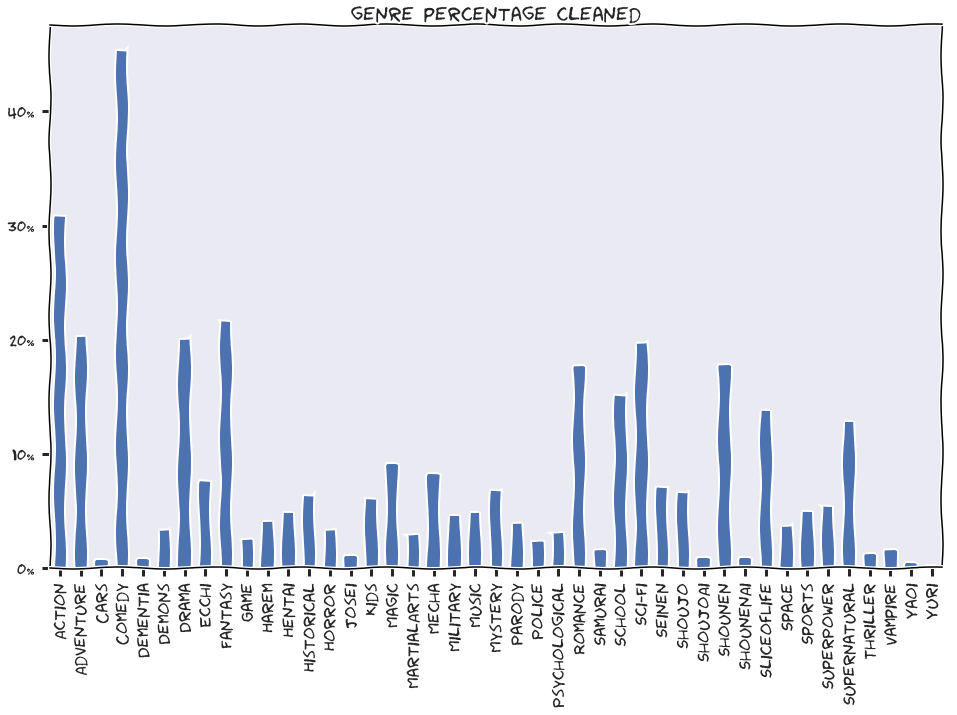

In [30]:
(animes_genres['genre'].value_counts() / animes.shape[0]).sort_index().plot(kind='bar', figsize=(16, 10), title='genre percentage cleaned')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

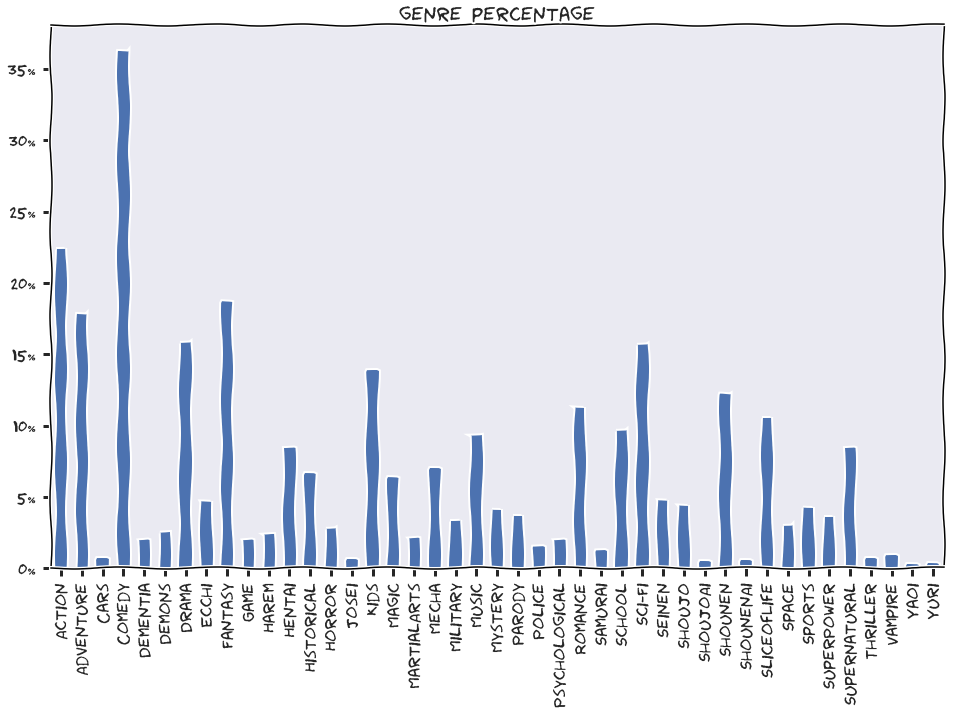

In [31]:
(animes_genres_all['genre'].value_counts() / animes_all.shape[0]).sort_index().plot(kind='bar', figsize=(16, 10), title='genre percentage')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

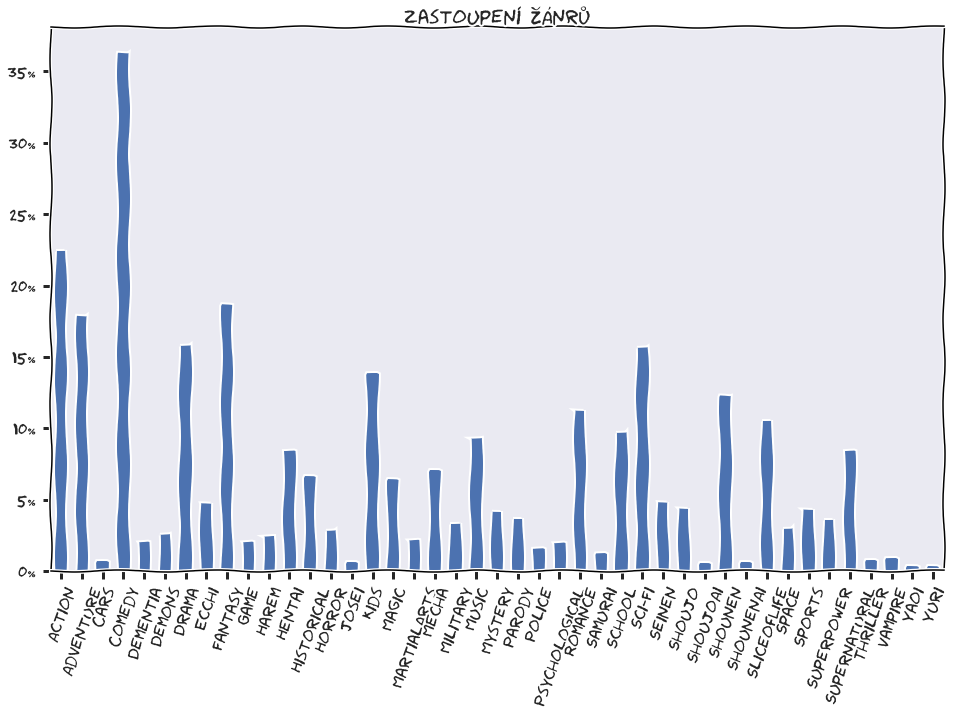

In [32]:
(animes_genres_all['genre'].value_counts() / animes_all.shape[0]).sort_index().plot(kind='bar', figsize=(16, 10), title='zastoupení žánrů')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=70)
plt.savefig('graphs/animes-genres-percent.png', bbox_inches="tight")

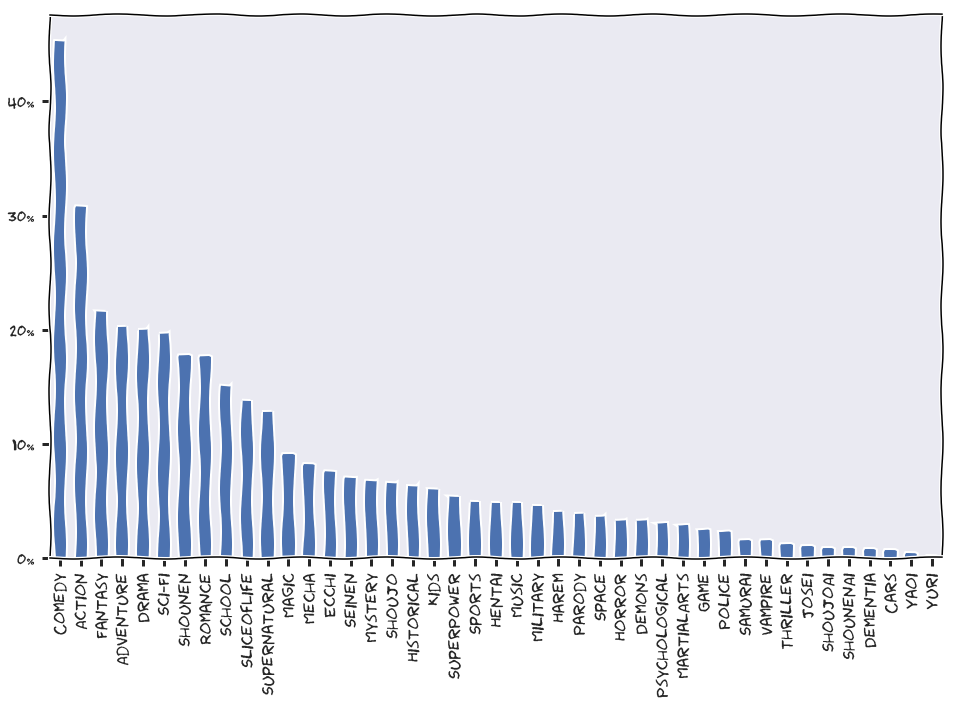

In [33]:
(animes_genres['genre'].value_counts() / animes.shape[0]).plot(kind='bar', figsize=(16, 10))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

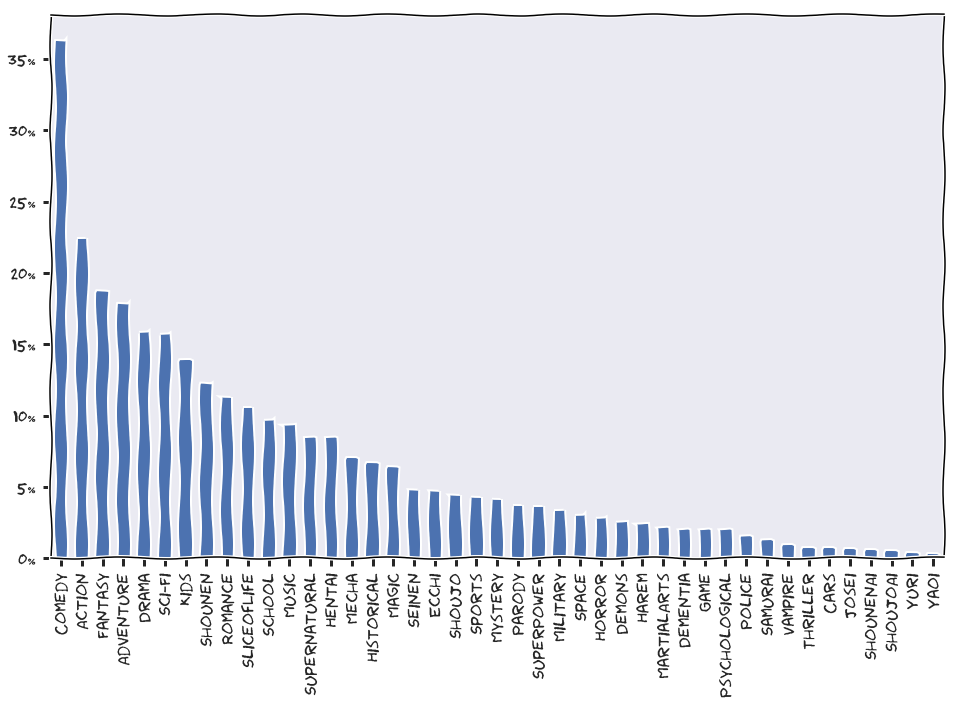

In [34]:
(animes_genres_all['genre'].value_counts() / animes_all.shape[0]).plot(kind='bar', figsize=(16, 10))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.show()

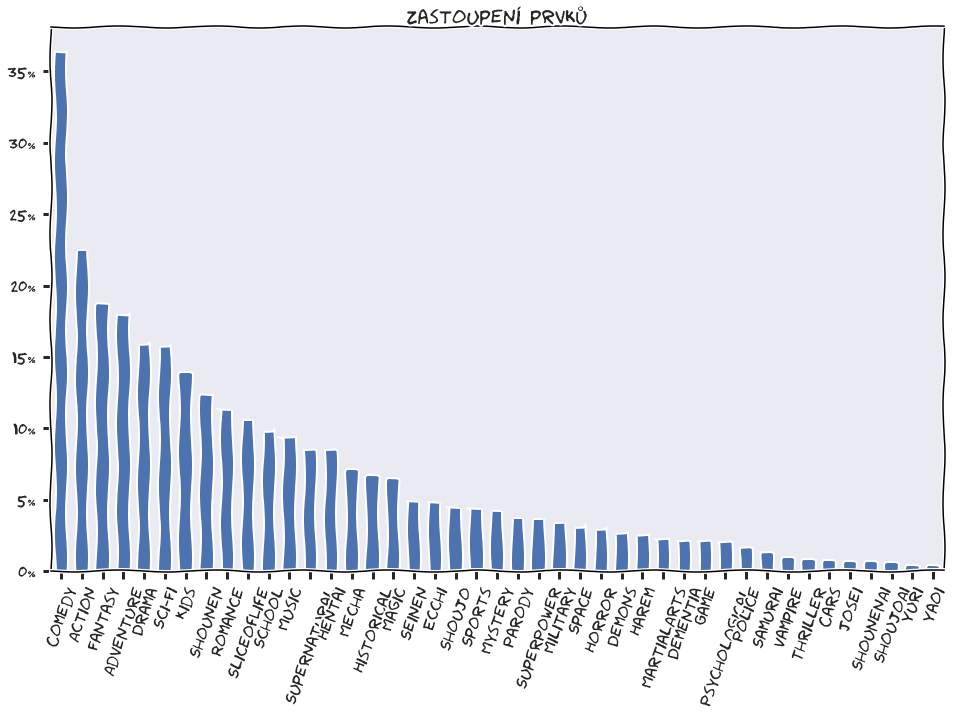

In [35]:
(animes_genres_all['genre'].value_counts() / animes_all.shape[0]).plot(kind='bar', figsize=(16, 10), title='Zastoupení prvků')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=70)
plt.savefig('graphs/animes-genres-percent-ordered.png', bbox_inches="tight")

In [36]:
### anime info:
print('anime aired years:')
display(animes_all['aired_from_year'].dropna().astype(np.int).describe())
print('# genres')
print(animes_genres['genre'].unique().size)
print('# studios')


anime aired years:


count    14252.000000
mean      2003.066868
std         14.913648
min       1917.000000
25%       1997.000000
50%       2008.000000
75%       2014.000000
max       2019.000000
Name: aired_from_year, dtype: float64

# genres
43
# studios


In [37]:
animes_all[animes_all['aired_from_year'].astype(str).str.contains('1917')]

,title,title_english,title_japanese,title_synonyms,image_url,type,source,episodes,status,airing,...,premiered,broadcast,related,producer,licensor,studios,genres,opening_theme,ending_theme,aired_from_year
anime_id,,,,,,,,,,,,,,,,,,,,,
10757,Kachikachi Yama,NaN,カチカチ山,NaN,NaN,Movie,Other,1,Finished Airing,False,...,NaN,NaN,"{'Other': [{'mal_id': 31912, 'type': 'anime', ...",NaN,NaN,NaN,Drama,[],[],1917
6654,Namakura Gatana,The Dull Sword,なまくら刀（塙凹内名刀之巻）,"Namakura Katana, Hanawa Hekonai Meitou no Maki...",https://myanimelist.cdn-dena.com/images/anime/...,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,"Comedy, Samurai",[],[],1917
23189,Dekobou Shingachou: Meian no Shippai,NaN,凸坊新画帳 名案の失敗,Dekobou&#039;s New Picture Book: Failure of a ...,NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,Comedy,[],[],1917
18457,Hanasaka Jijii,NaN,花咲爺,"Old Man Hanasaka, The Grandfather Who Makes Th...",https://myanimelist.cdn-dena.com/images/anime/...,Movie,Other,1,Finished Airing,False,...,NaN,NaN,"{'Alternative version': [{'mal_id': 30086, 'ty...",NaN,NaN,NaN,"Comedy, Drama",[],[],1917
23187,Chamebou Shin Gachou: Nomi Fuufu Shikaeshi no ...,NaN,茶目坊新画帳 蚤夫婦仕返しの巻,NaN,NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,Comedy,[],[],1917
24573,Neko to Nezumi,NaN,猫と鼠,"Cat and Mice, Cat and Mouse",NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,Comedy,[],[],1917
10756,Shita-kiri Suzume,The Sparrow with the Slit Tongue,舌切雀,Tongue-Cut Sparrow,NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,"{'Alternative version': [{'mal_id': 34743, 'ty...",NaN,NaN,NaN,Drama,[],[],1917
23191,Chokin no Susume,NaN,貯金の勤,NaN,NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,Comedy,[],[],1917
23185,Chamebou Kuukijuu no Maki,NaN,茶目坊空気銃の巻,NaN,NaN,Movie,Original,1,Finished Airing,False,...,NaN,NaN,[],NaN,NaN,NaN,Comedy,[],[],1917


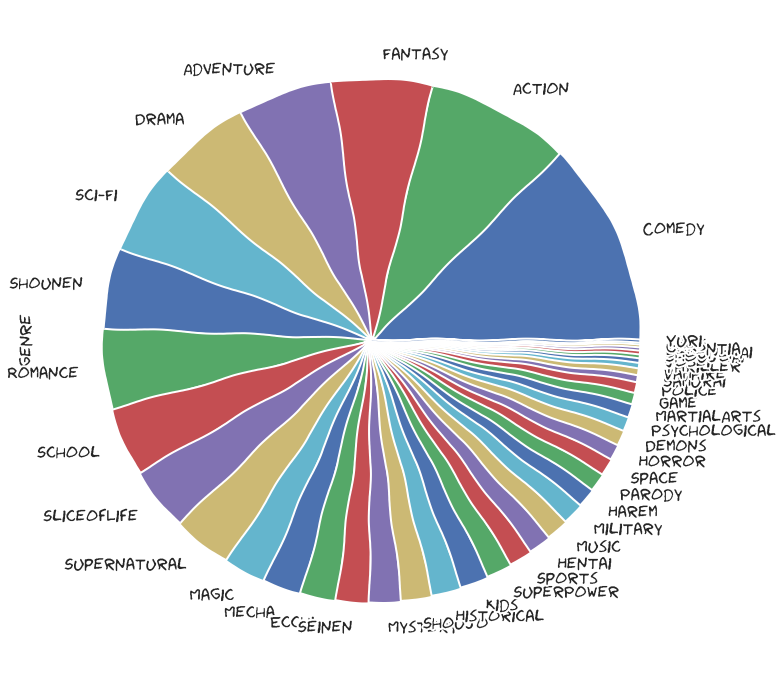

In [38]:
animes_genres['genre'].value_counts().plot.pie(figsize=(12, 12))

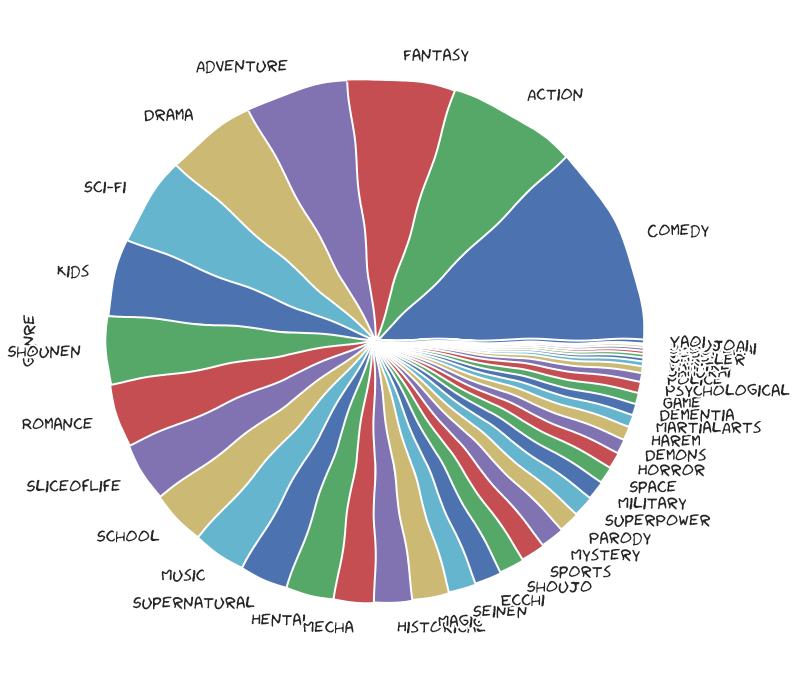

In [39]:
animes_genres_all['genre'].value_counts().plot.pie(figsize=(12, 12))

In [40]:
genres_years = pd.crosstab(animes['aired_from_year'], animes['genres'])

In [41]:
display(animes['aired_from_year'].describe())
years_diff = int(animes['aired_from_year'].max() - animes['aired_from_year'].min()) + 1
display(years_diff)
anime_aired_year = animes['aired_from_year'].dropna().astype(np.int)

count    6668.000000
mean     2006.915267
std        10.381425
min      1942.000000
25%      2003.000000
50%      2010.000000
75%      2015.000000
max      2018.000000
Name: aired_from_year, dtype: float64

77

In [42]:
anime_aired_year_all = animes_all['aired_from_year'].dropna().astype(np.int)
display(anime_aired_year_all.describe())
years_diff_all = int(anime_aired_year_all.max() - anime_aired_year_all.min()) + 1
display(years_diff_all)


count    14252.000000
mean      2003.066868
std         14.913648
min       1917.000000
25%       1997.000000
50%       2008.000000
75%       2014.000000
max       2019.000000
Name: aired_from_year, dtype: float64

103

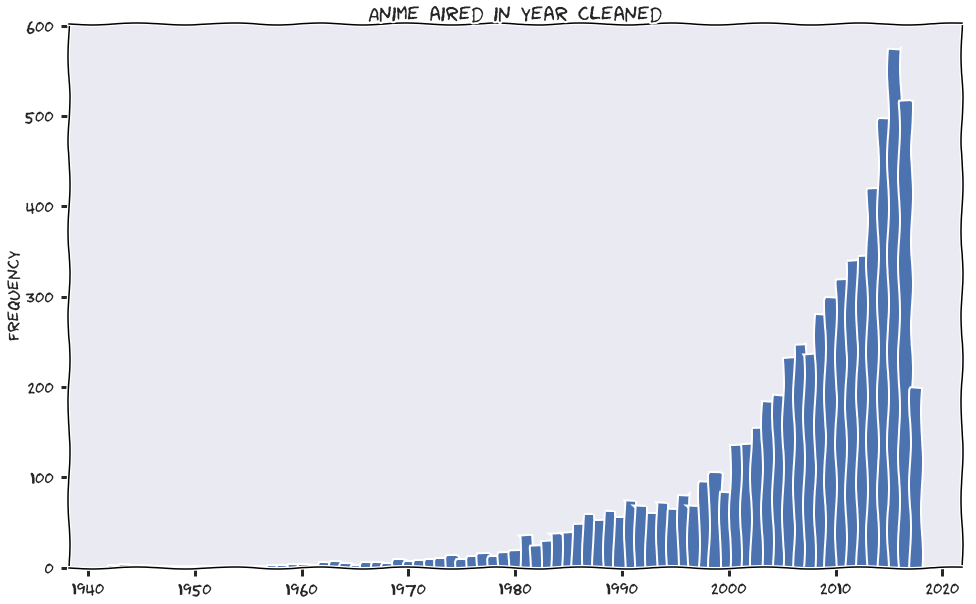

In [43]:
anime_aired_year.plot(kind='hist', bins=years_diff, figsize=(16, 10), title='Anime aired in year cleaned')

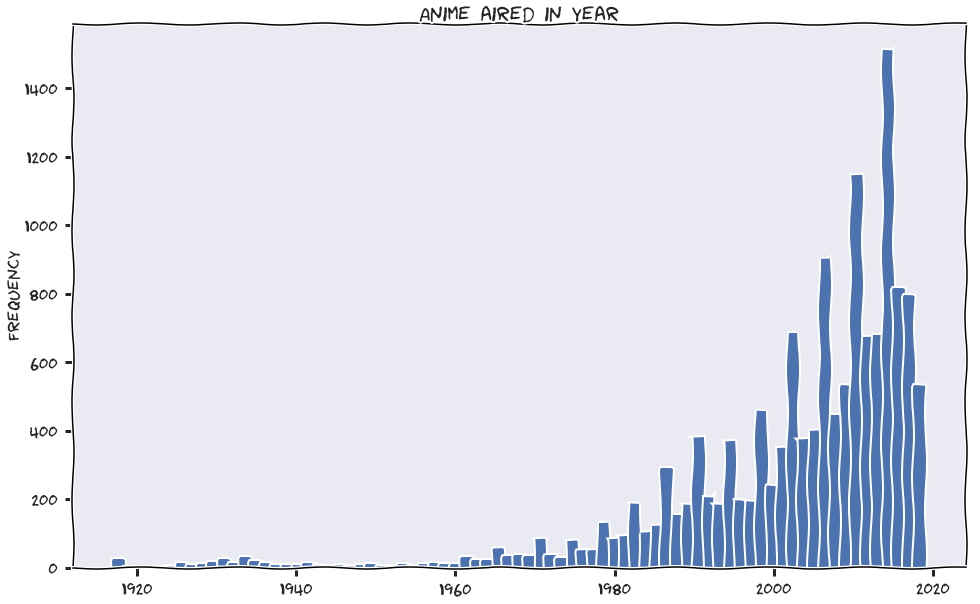

In [44]:
anime_aired_year_all.plot(kind='hist', bins=years_diff, figsize=(16, 10), title='Anime aired in year')

(2000, 2018)

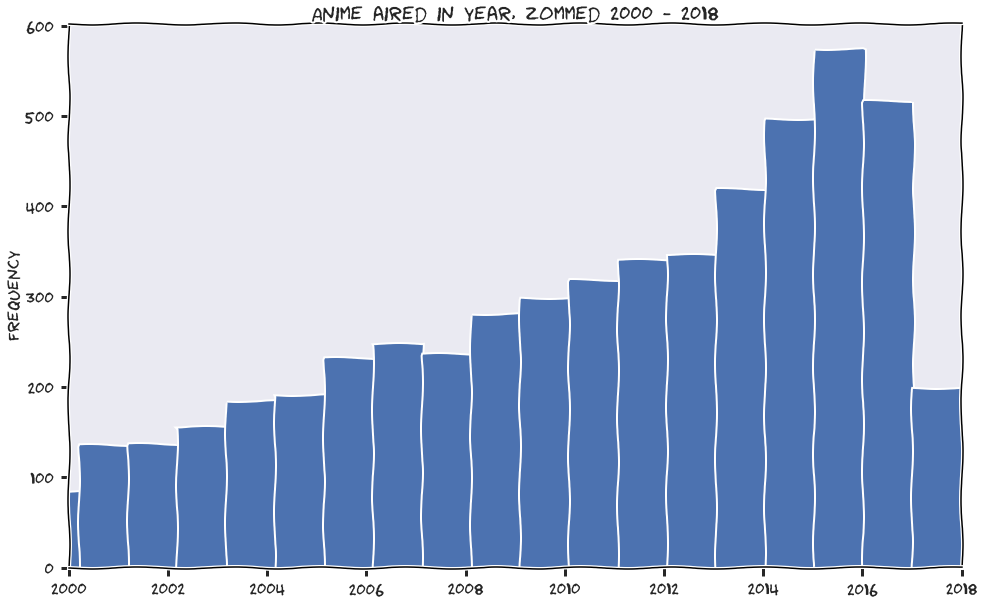

In [45]:
anime_aired_year.plot(kind='hist', bins=years_diff, figsize=(16, 10), title='Anime aired in year, zommed 2000 - 2018')
plt.gca().set_xlim([2000, 2018])

In [46]:
animes[animes['title'] == 'Usavich']['aired']

anime_id
3737    {'from': '2018-05-12', 'to': '2018-05-12'}
Name: aired, dtype: object

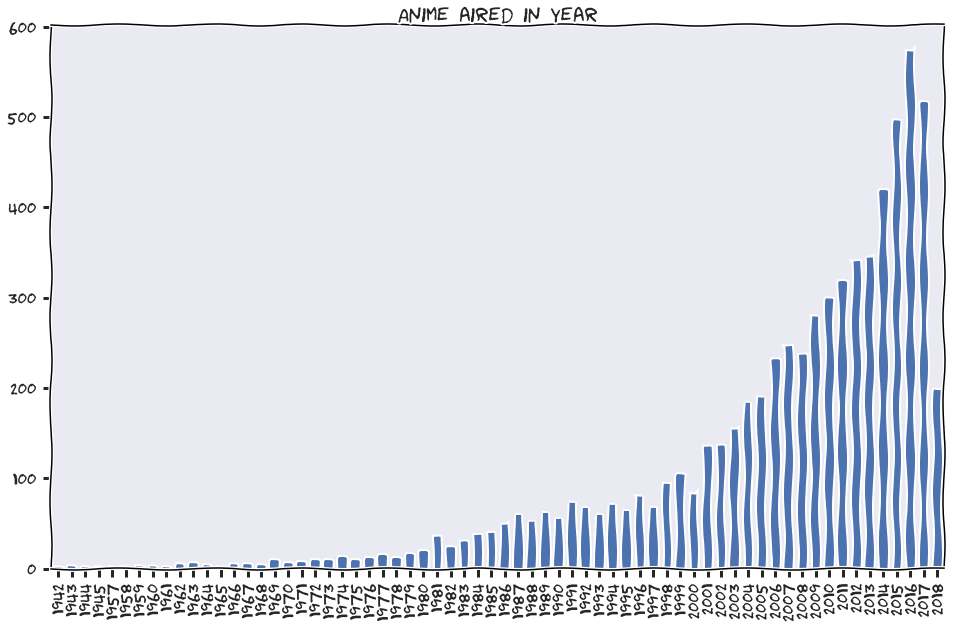

In [47]:
anime_aired_year.value_counts().sort_index().plot.bar(figsize=(16, 10), title='Anime aired in year')

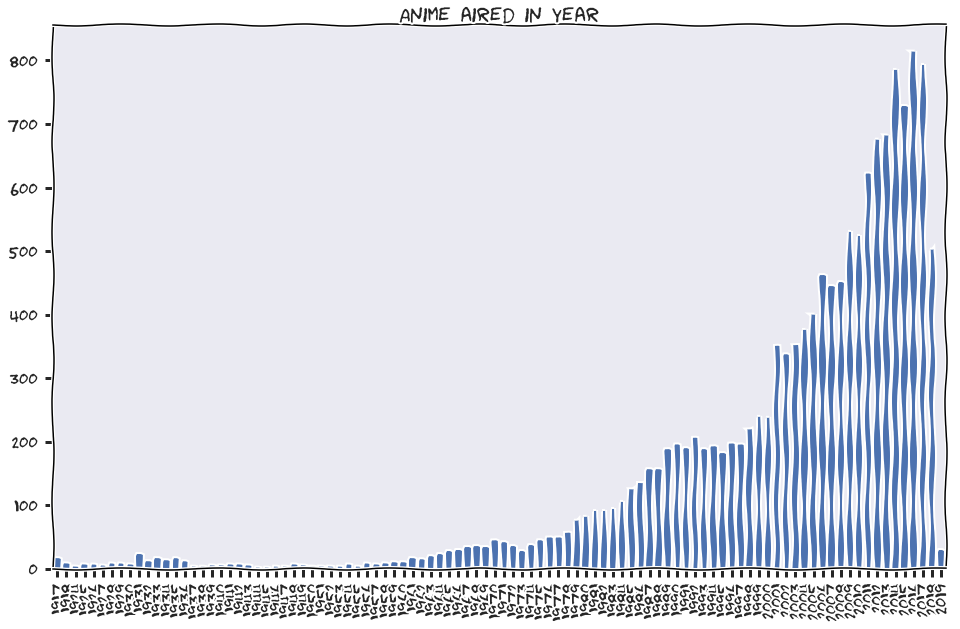

In [48]:
anime_aired_year_all.value_counts().sort_index().plot.bar(figsize=(16, 10), title='Anime aired in year')

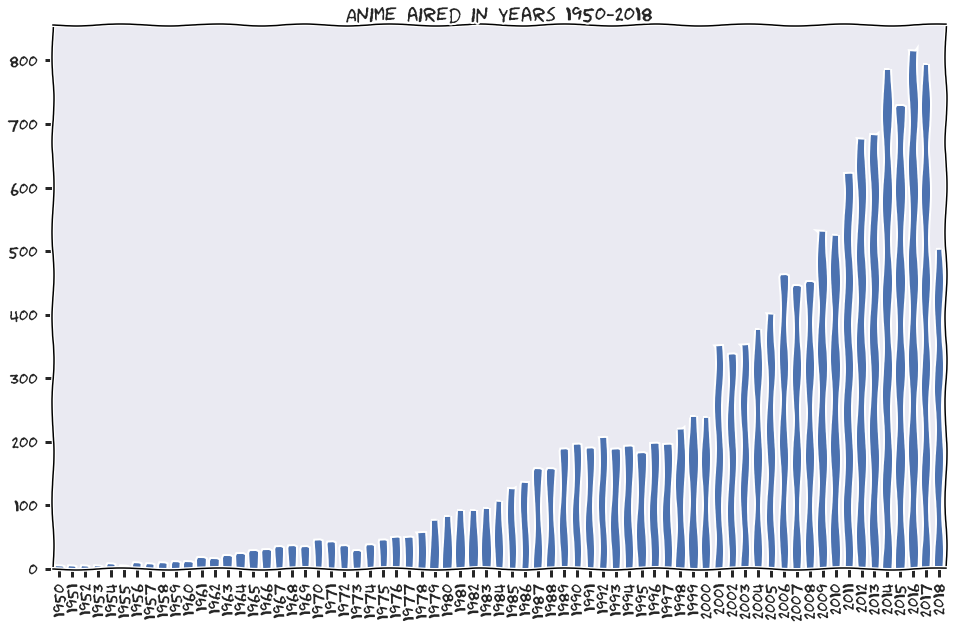

In [49]:
anime_aired_year_all.value_counts().sort_index().loc[1950:2018].plot.bar(figsize=(16, 10), title='Anime aired in years 1950-2018')

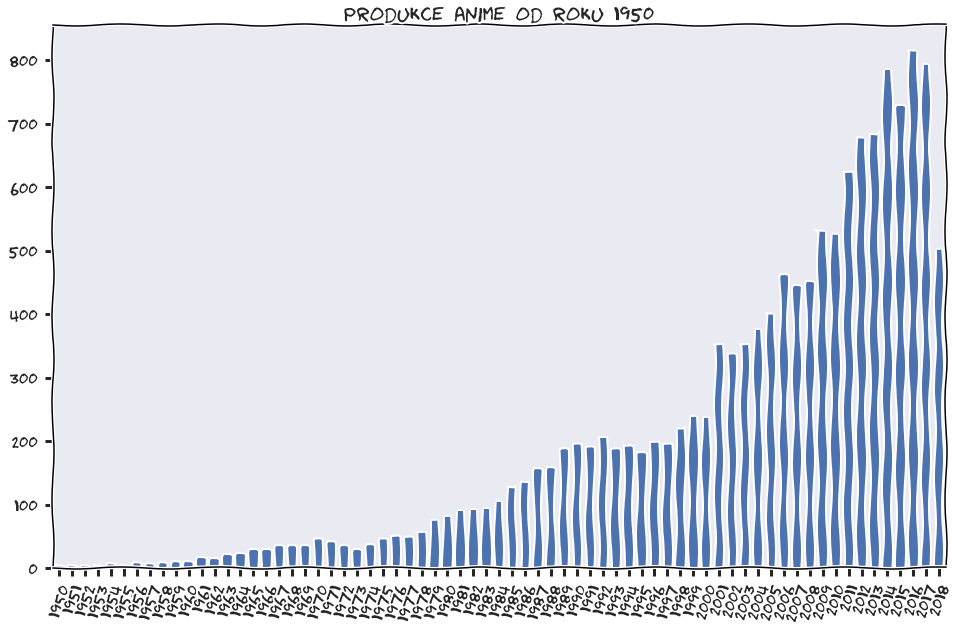

In [50]:
anime_aired_year_all.value_counts().sort_index().loc[1950:2018].plot.bar(figsize=(16, 10), title='Produkce anime od roku 1950')
plt.xticks(rotation=70)
plt.savefig('graphs/anime-produkce-1950.png', bbox_inches="tight")

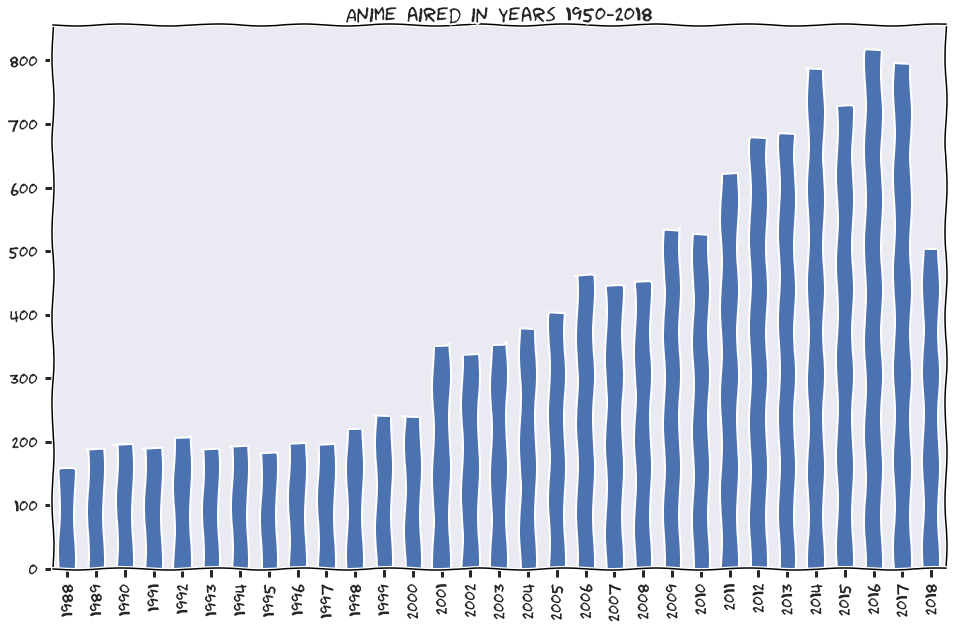

In [51]:
anime_aired_year_all.value_counts().sort_index().loc[1988:2018].plot.bar(figsize=(16, 10), title='Anime aired in years 1950-2018')

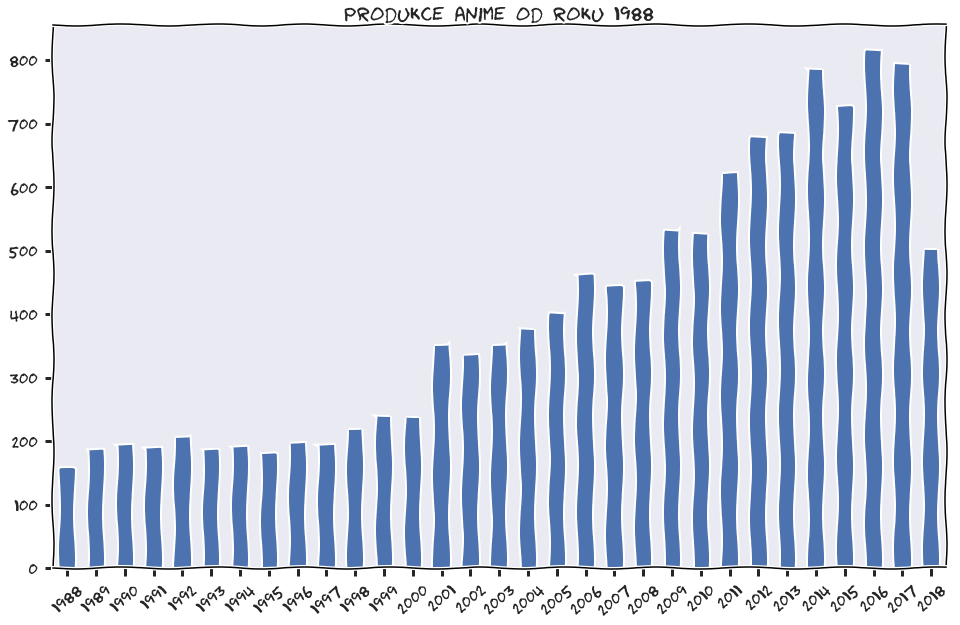

In [52]:
anime_aired_year_all.value_counts().sort_index().loc[1988:2018].plot.bar(figsize=(16, 10), title='Produkce anime od roku 1988')
plt.xticks(rotation=40)
plt.savefig('graphs/anime-produkce-1988.png', bbox_inches="tight")

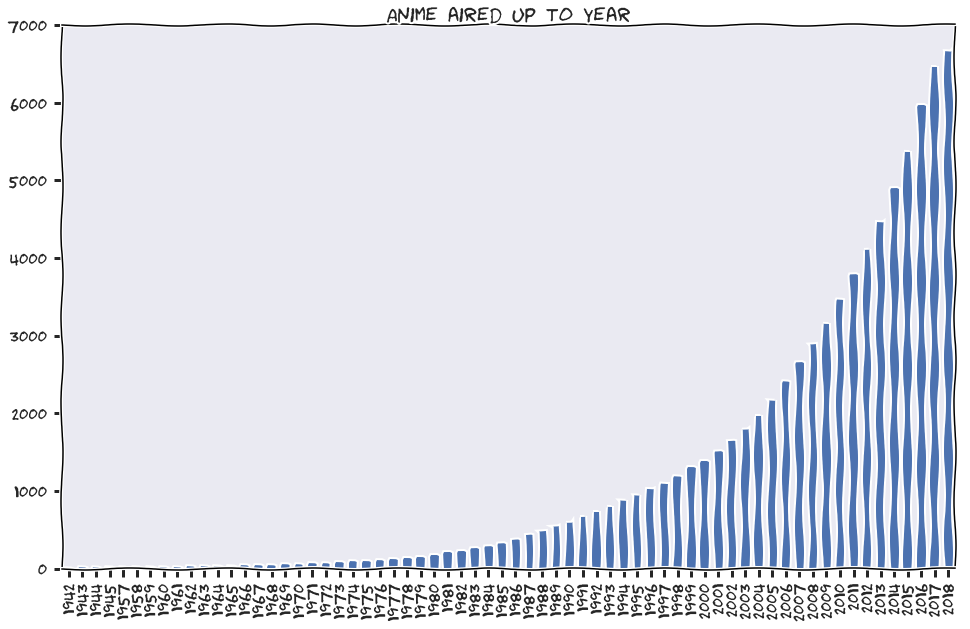

In [53]:
anime_aired_year.value_counts().sort_index().cumsum().plot.bar(figsize=(16, 10), title='Anime aired up to year')

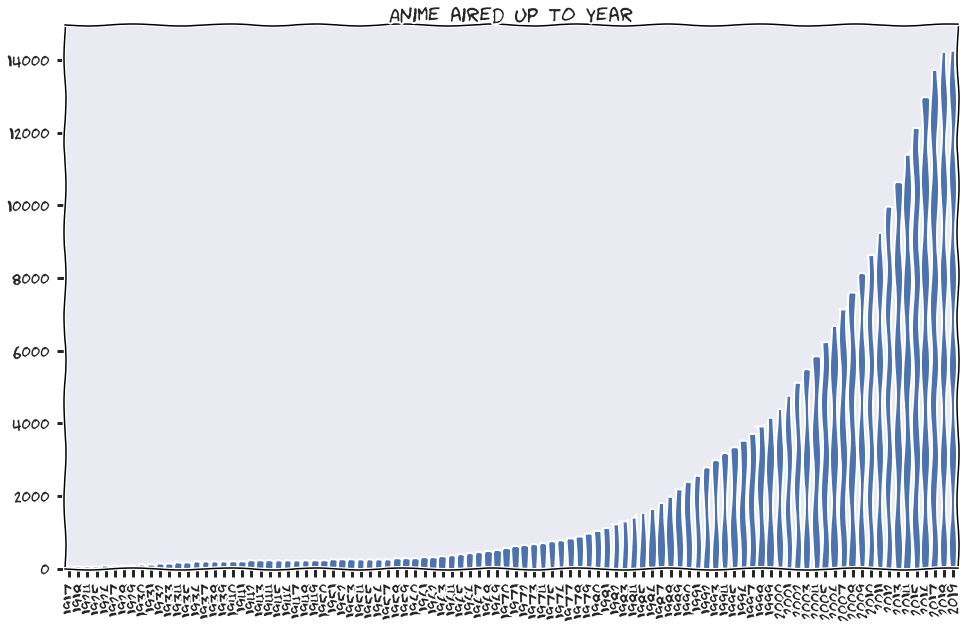

In [54]:
anime_aired_year_all.value_counts().sort_index().cumsum().plot.bar(figsize=(16, 10), title='Anime aired up to year')

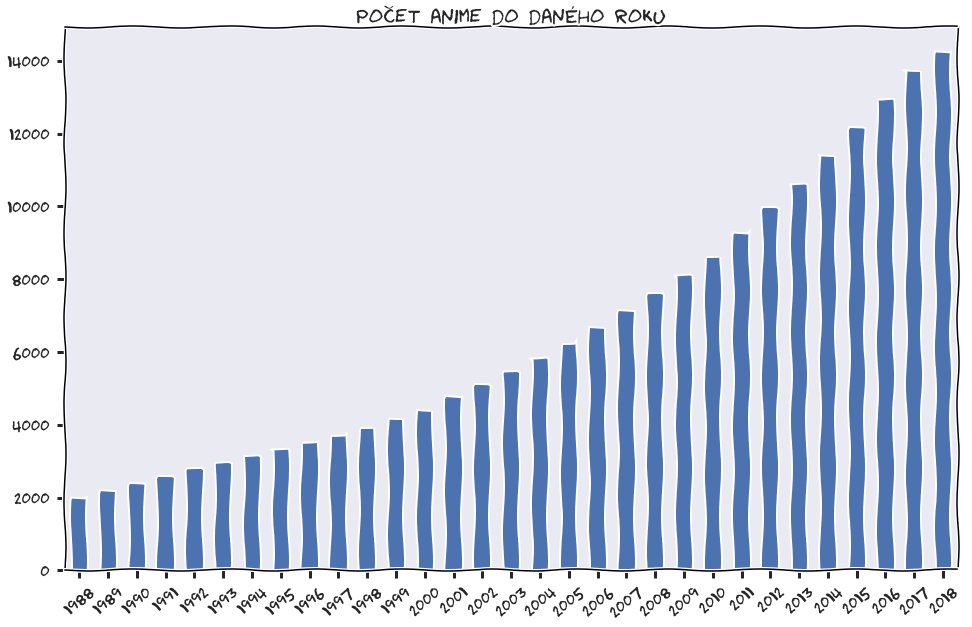

In [55]:
anime_aired_year_all.value_counts().sort_index().cumsum().loc[1988:2018].plot.bar(figsize=(16, 10), title='Počet anime do daného roku')
plt.xticks(rotation=40)
plt.savefig('graphs/anime-produkce-cumsum-1988.png', bbox_inches="tight")

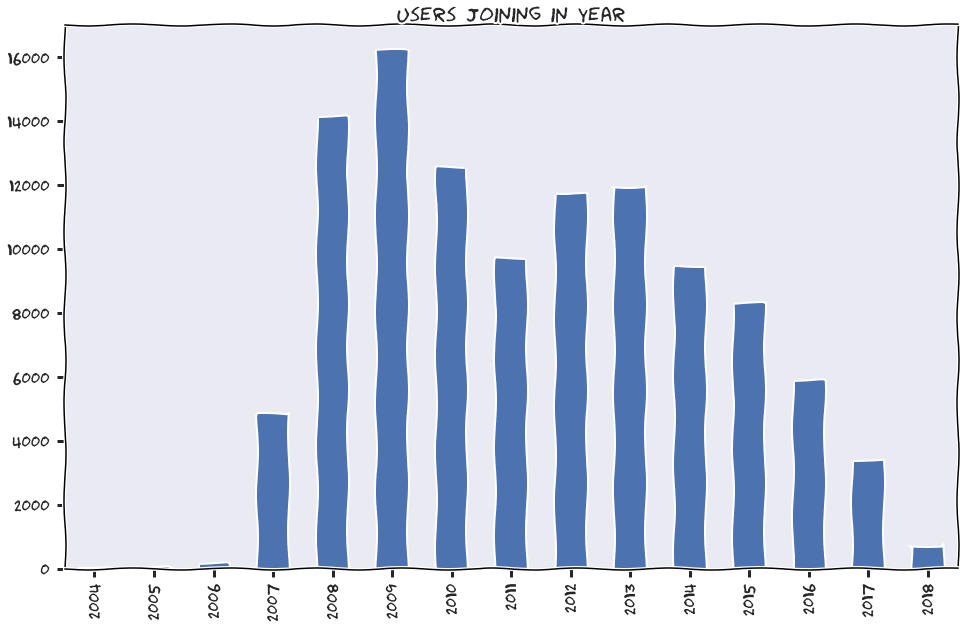

In [56]:
users['join_date'].dt.year.value_counts().sort_index().plot.bar(figsize=(16, 10), title='users joining in year')

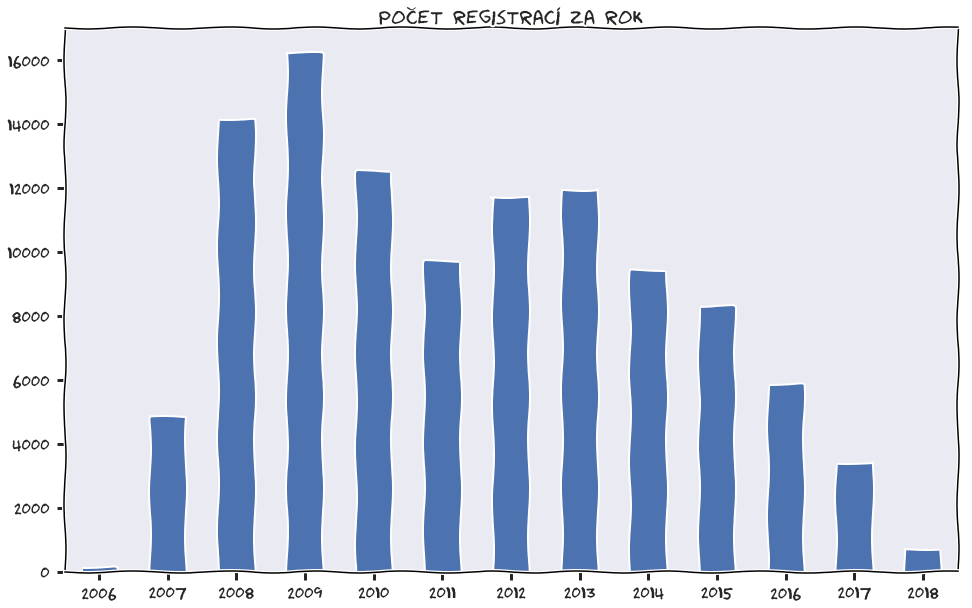

In [57]:
users['join_date'].dt.year.value_counts().sort_index().loc[2006:].plot.bar(figsize=(16, 10), title='Počet registrací za rok')
plt.xticks(rotation=0)
plt.savefig('graphs/mal-registrace-rocne.png', bbox_inches="tight")

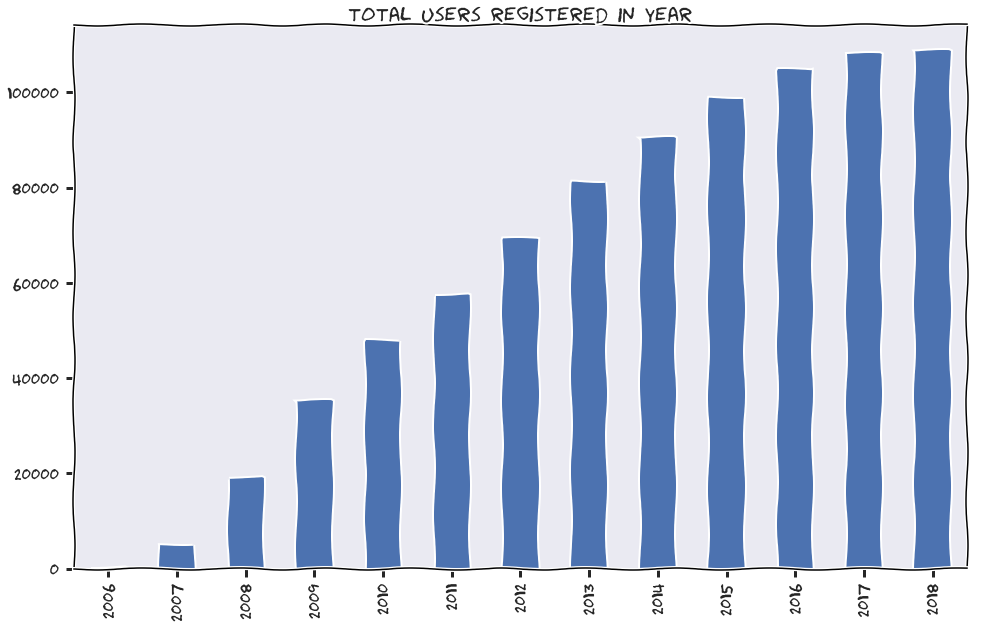

In [58]:
users['join_date'].dt.year.value_counts().sort_index().cumsum().loc[2006:].plot.bar(figsize=(16, 10), title='total users registered in year')

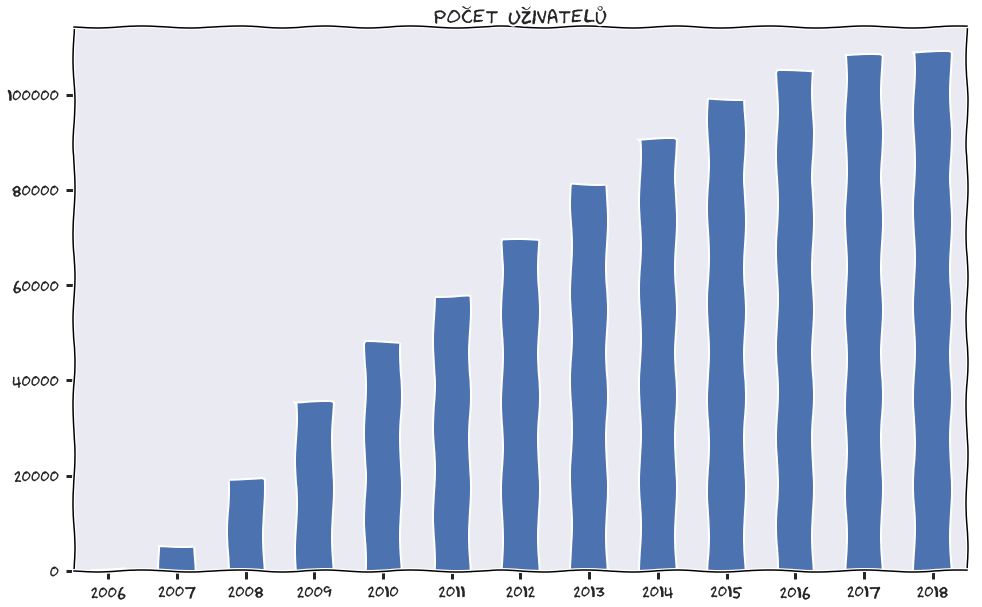

In [59]:
users['join_date'].dt.year.value_counts().sort_index().cumsum().loc[2006:].plot.bar(figsize=(16, 10), title='Počet uživatelů')
plt.xticks(rotation=0)
plt.savefig('graphs/mal-registrace-cumsum-rocne.png', bbox_inches="tight")

In [60]:
# counting 0 score, which is not rated, drastically moves both mean and variance
users['rating_mean'] = animelists[animelists['my_score'] != 0].groupby('username')['my_score'].mean()
users['rating_var'] = animelists[animelists['my_score'] != 0].groupby('username')['my_score'].var()

In [61]:
#sns.jointplot(x='age', y='rating_mean', data=users, size=16, kind='kde')

In [62]:
#sns.jointplot(x='age', y='rating_var', data=users, size=16, kind='kde')

In [63]:
users['seen_anime'] = animelists.groupby('username')['anime_id'].count()

In [64]:
#sns.jointplot(x='age', y='seen_anime', data=users, size=16)

In [65]:
#sns.jointplot(x='age', y='seen_anime', data=users, size=16, kind='kde')

In [66]:
users['days_on_mal'] = (users['last_online'] - users['join_date']) / np.timedelta64(1, 'D')

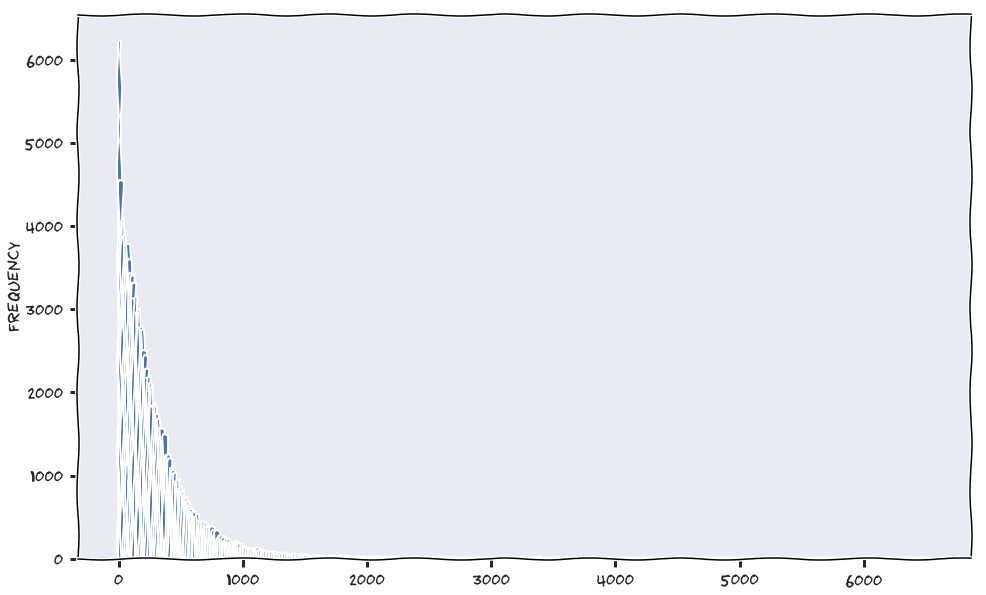

In [67]:
users['seen_anime'].plot(kind='hist', bins=500, figsize=(16, 10))

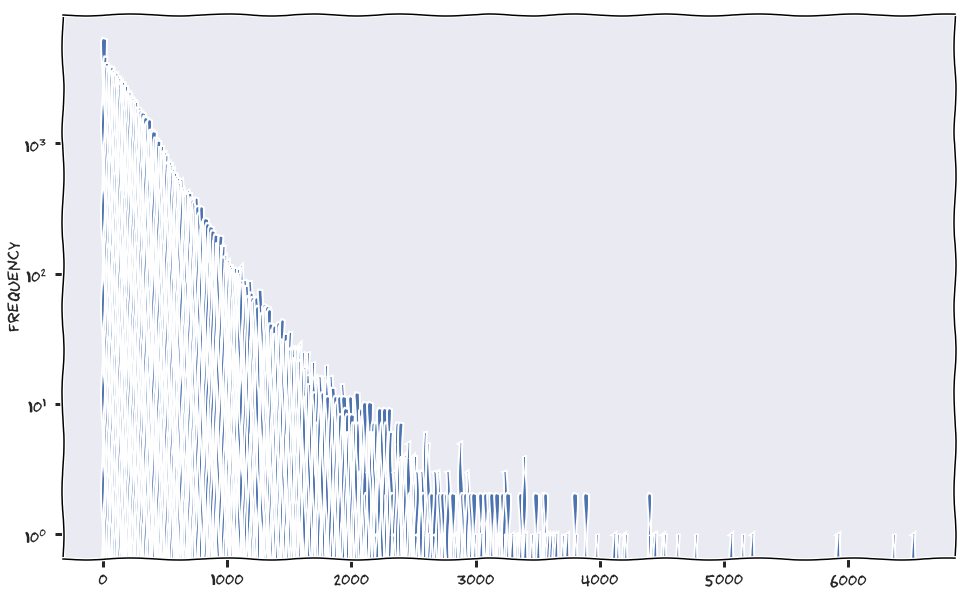

In [68]:
users['seen_anime'].plot(kind='hist', bins=500, figsize=(16, 10), logy=True)

In [69]:
users[users['days_on_mal'] > 4500][['user_id', 'join_date', 'last_online', 'days_on_mal']]

,user_id,join_date,last_online,days_on_mal
username,,,,
Xinil,1,2004-11-05,2018-05-14 18:02:55,4938.752025
Achtor,82,2005-04-29,2018-05-13 11:11:00,4762.465972
vondur,20,2005-01-05,2018-02-28 17:27:29,4802.727419
Crystal,4,2004-11-13,2018-05-14 13:04:48,4930.545000
Baman,36,2005-02-05,2018-05-20 04:57:26,4852.206551
Arinohyoshi,208,2005-01-30,2017-10-09 18:32:43,4635.772720


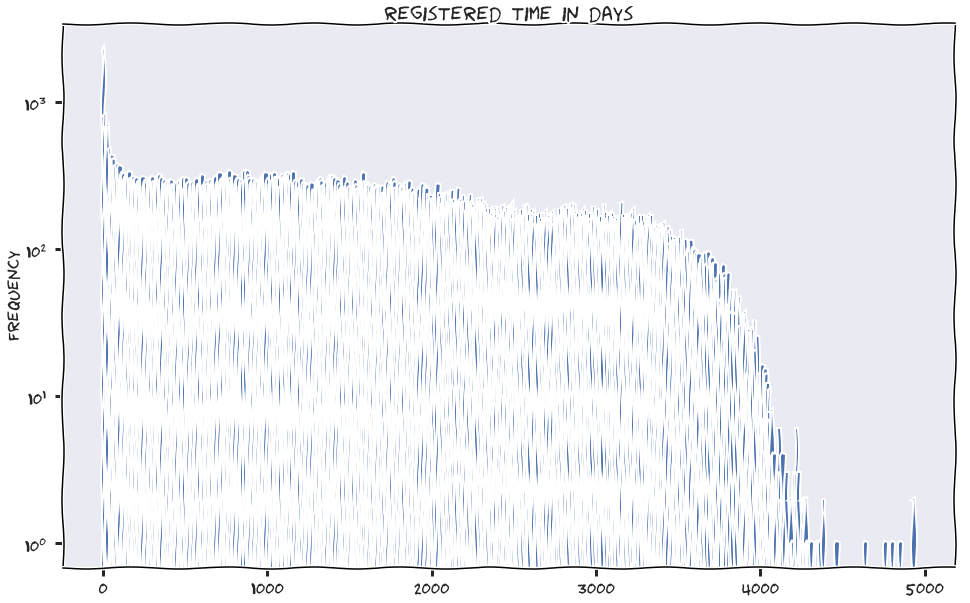

In [70]:
users['days_on_mal'].plot(kind='hist', logy=True, bins=600, figsize=(16, 10), title='registered time in days')

In [71]:
users[users['seen_anime'] > 5000]['seen_anime'].value_counts()

6536.0    1
6367.0    1
5234.0    1
5923.0    1
5062.0    1
5151.0    1
5912.0    1
Name: seen_anime, dtype: int64

In [72]:
#sns.jointplot(x='user_days_spent_watching', y='seen_anime', data=users, size=16)

In [73]:
#sns.jointplot(x='user_days_spent_watching', y='stats_episodes', data=users, size=16)

In [74]:
#sns.jointplot(x='seen_anime', y='stats_episodes', data=users, size=16)

In [75]:
users.columns

Index(['user_id', 'user_watching', 'user_completed', 'user_onhold',
       'user_dropped', 'user_plantowatch', 'user_days_spent_watching',
       'gender', 'location', 'birth_date', 'access_rank', 'join_date',
       'last_online', 'stats_mean_score', 'stats_rewatched', 'stats_episodes',
       'age', 'rating_mean', 'rating_var', 'seen_anime', 'days_on_mal'],
      dtype='object')

In [76]:
users['rating_mean'].isnull().sum()

2309

In [77]:
users['rating_mean'].fillna(0, inplace=True)
users['rating_var'].fillna(0, inplace=True)

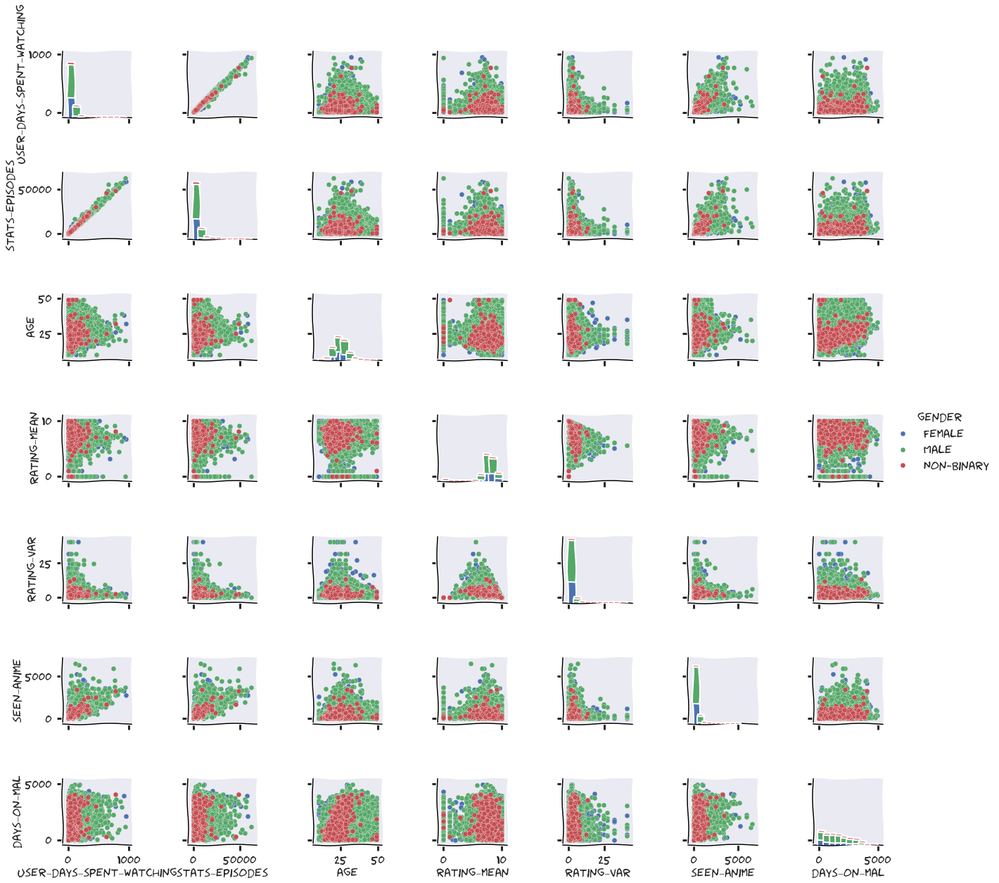

In [78]:
sns.pairplot(users[['user_days_spent_watching',
       'gender', 'birth_date', 'join_date',
       'last_online', 'stats_episodes',
       'age', 'rating_mean', 'rating_var', 'seen_anime',
       'days_on_mal']], hue='gender')

### inspecting anime age ratings

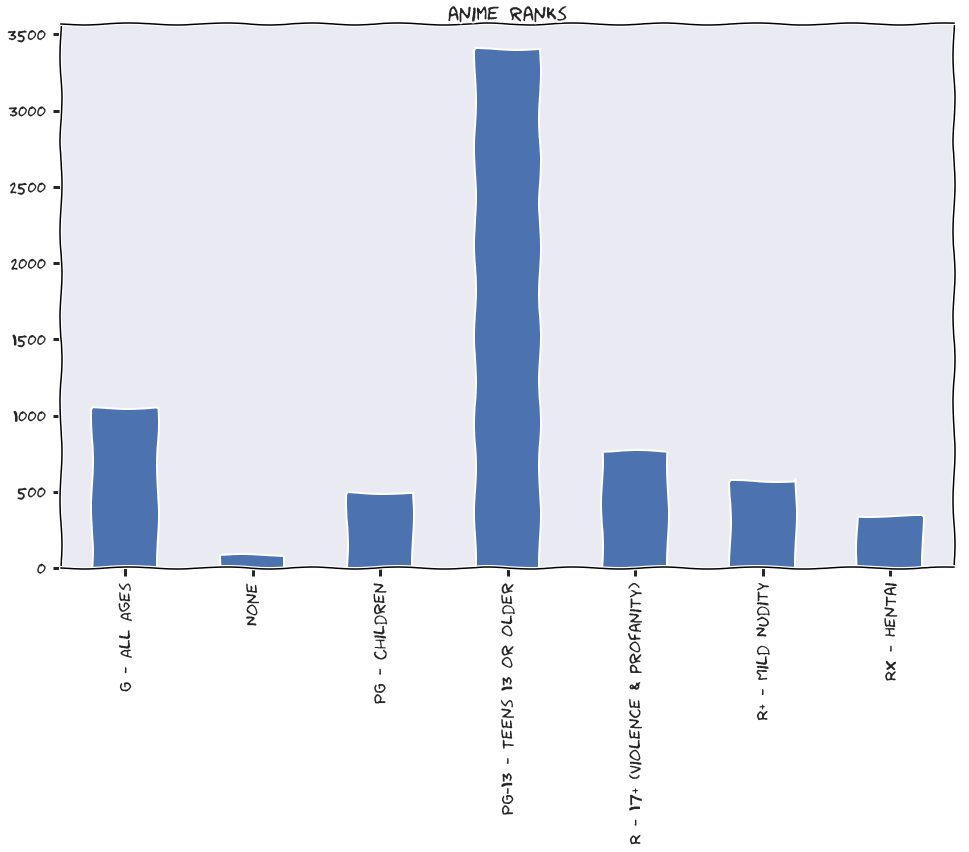

In [79]:
animes['rating'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='anime ranks')

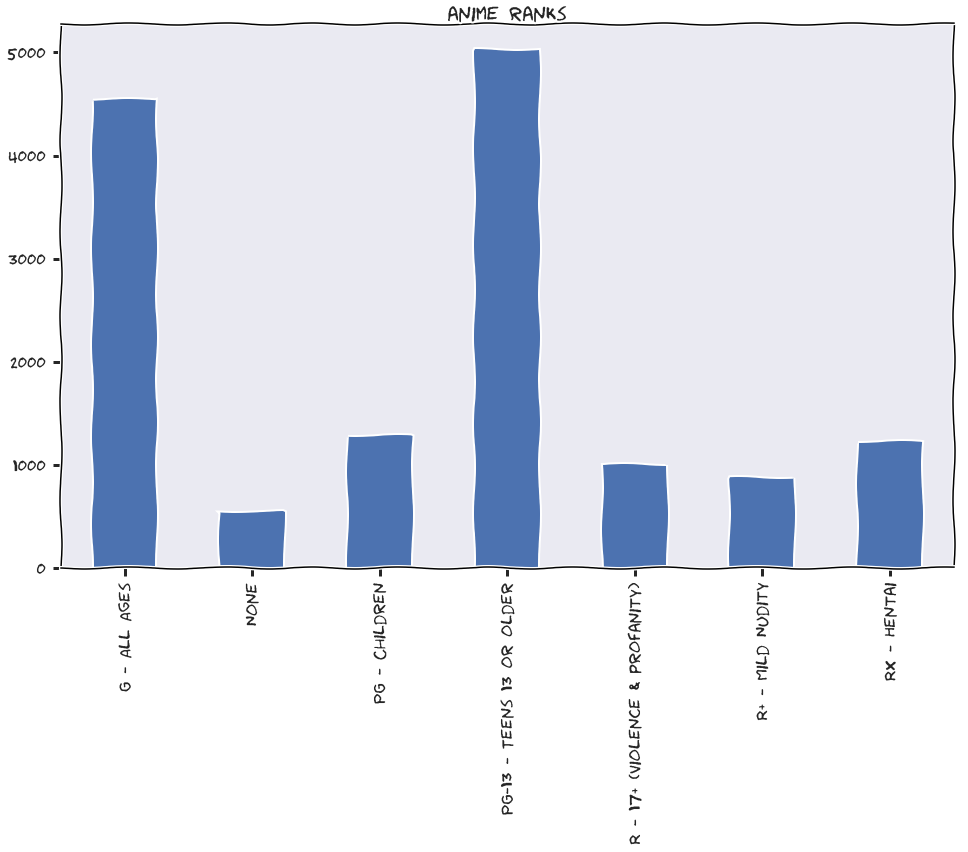

In [80]:
animes_all['rating'].dropna().value_counts().sort_index().plot.bar(figsize=(16, 10), title='anime ranks')

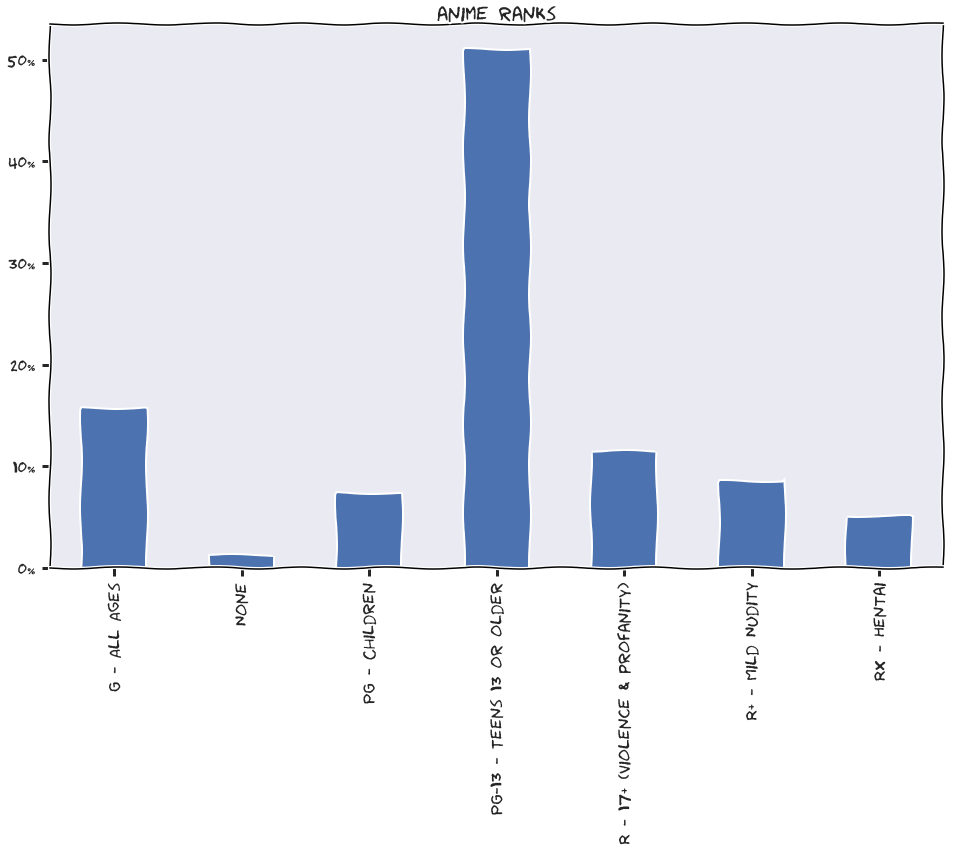

In [81]:
(animes['rating'].value_counts() / animes.shape[0]).sort_index().plot.bar(figsize=(16, 10), title='anime ranks')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

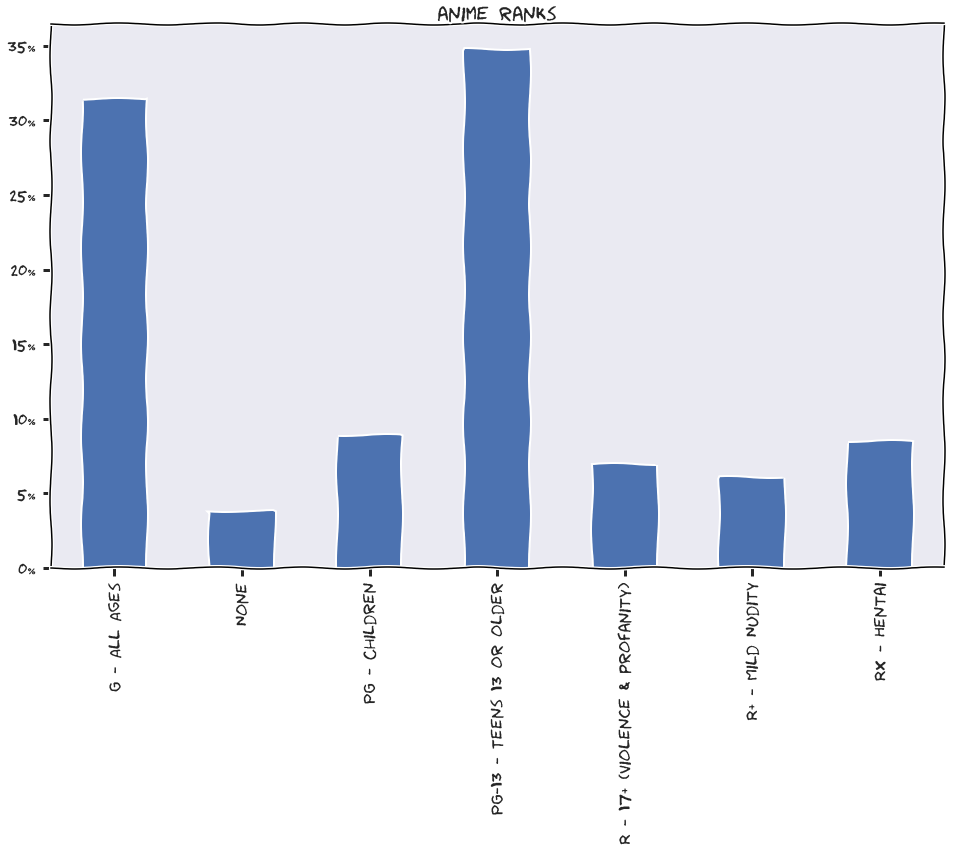

In [82]:
(animes_all['rating'].dropna().value_counts() / animes_all['rating'].dropna().size).sort_index().plot.bar(figsize=(16, 10), title='anime ranks')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

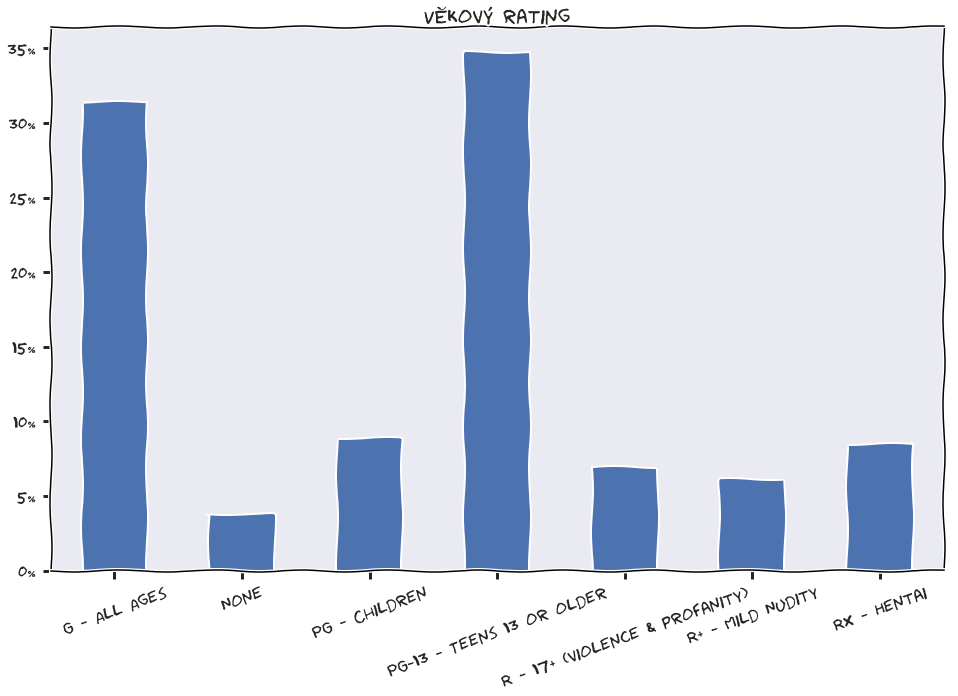

In [83]:
(animes_all['rating'].dropna().value_counts() / animes_all['rating'].dropna().size).sort_index().plot.bar(figsize=(16, 10), title='Věkový rating')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=20)
plt.savefig('graphs/vekovy-rating.png', bbox_inches="tight")

### inspecting anime sources

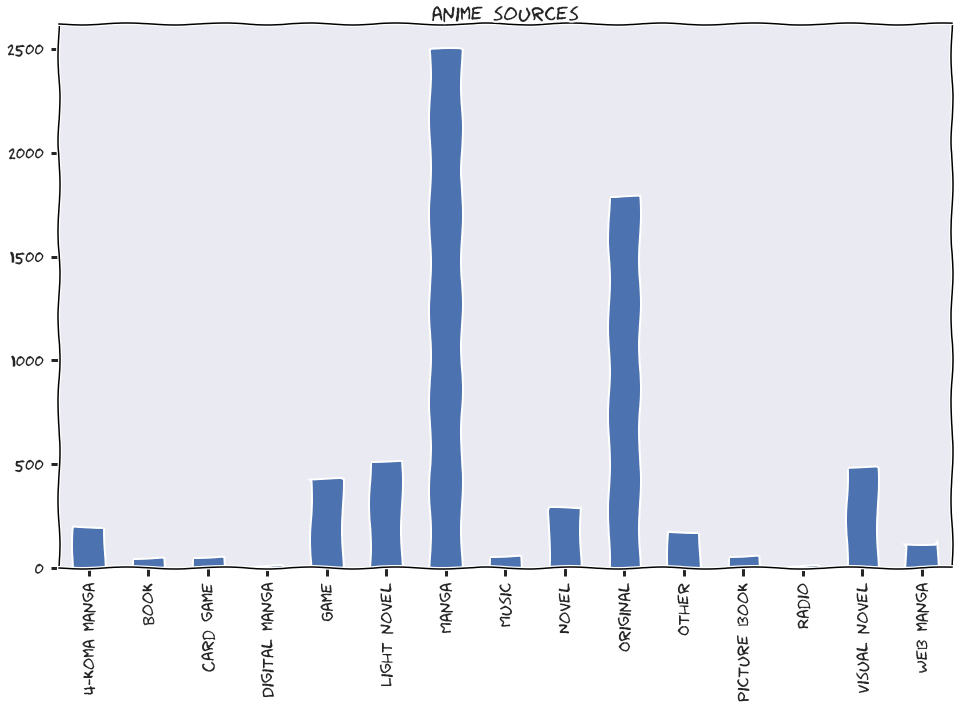

In [84]:
animes['source'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='anime sources')

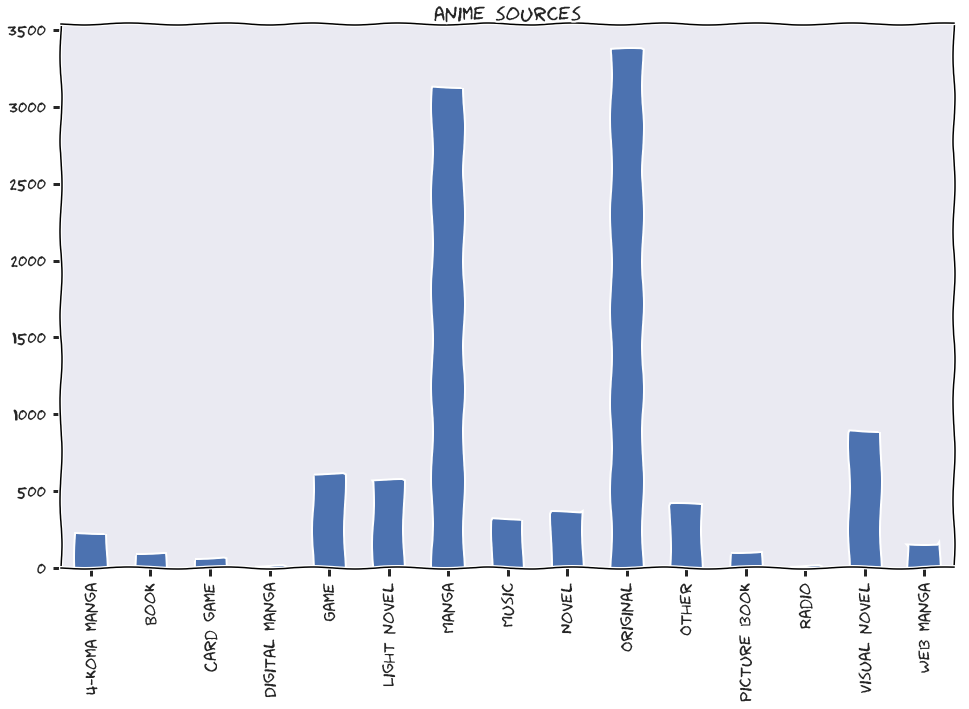

In [85]:
animes_all_sources = animes_all.dropna(subset=['source'])
animes_all_sources = animes_all_sources[animes_all_sources['source'] != 'Unknown']
animes_all_sources['source'].value_counts().sort_index().plot.bar(figsize=(16, 10), title='anime sources')

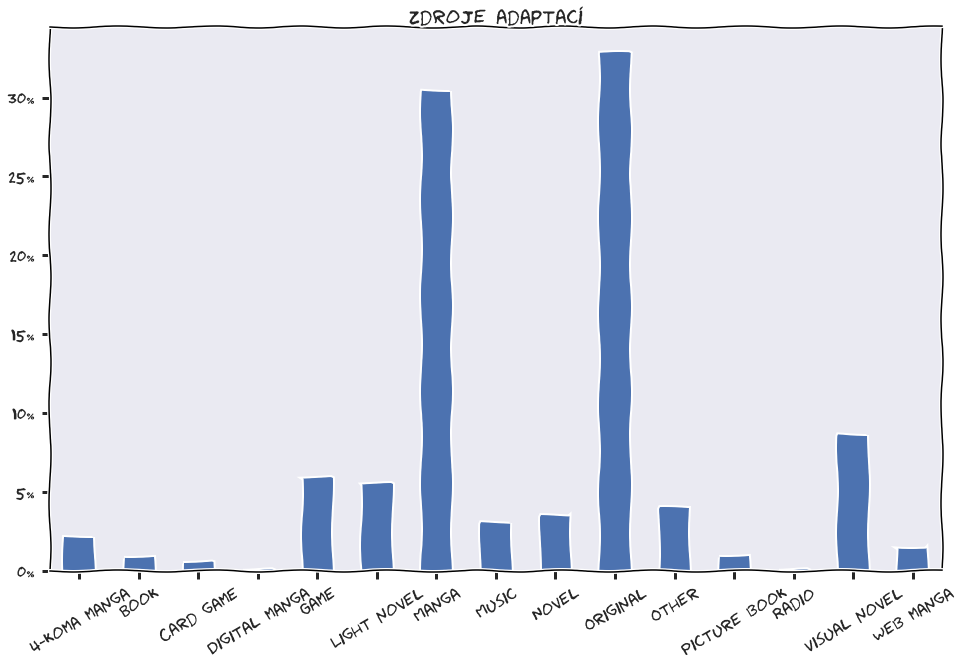

In [86]:
(animes_all_sources['source'].value_counts() / animes_all_sources['source'].size).sort_index().plot.bar(figsize=(16, 10), title='Zdroje adaptací')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 
plt.xticks(rotation=30)
plt.savefig('graphs/zdroje-adaptaci.png', bbox_inches="tight")

In [87]:
year_source = pd.crosstab(animes['aired_from_year'], animes['source'])
year_source.index = year_source.index.astype(np.int)
# keeping only interesting sources
interesting_sources = ['Game', 'Light novel', 'Manga', 'Original', 'Visual novel']
other_sources = list(set(year_source.columns) - set(interesting_sources))
year_source['other'] = year_source[other_sources].sum(axis=1)
year_source = year_source.drop(other_sources, axis=1)
colors = plt.cm.Set1(np.linspace(0, 1, year_source.shape[1]))

In [88]:
year_source_all = pd.crosstab(animes_all_sources['aired_from_year'].dropna().astype(np.int), animes_all_sources['source'])
year_source_all.index = year_source_all.index.astype(np.int)
# keeping only interesting sources
interesting_sources = ['Game', 'Light novel', 'Manga', 'Original', 'Visual novel']
other_sources = list(set(year_source_all.columns) - set(interesting_sources))
year_source_all['other'] = year_source_all[other_sources].sum(axis=1)
year_source_all = year_source_all.drop(other_sources, axis=1)
colors_all = plt.cm.Set1(np.linspace(0, 1, year_source_all.shape[1]))

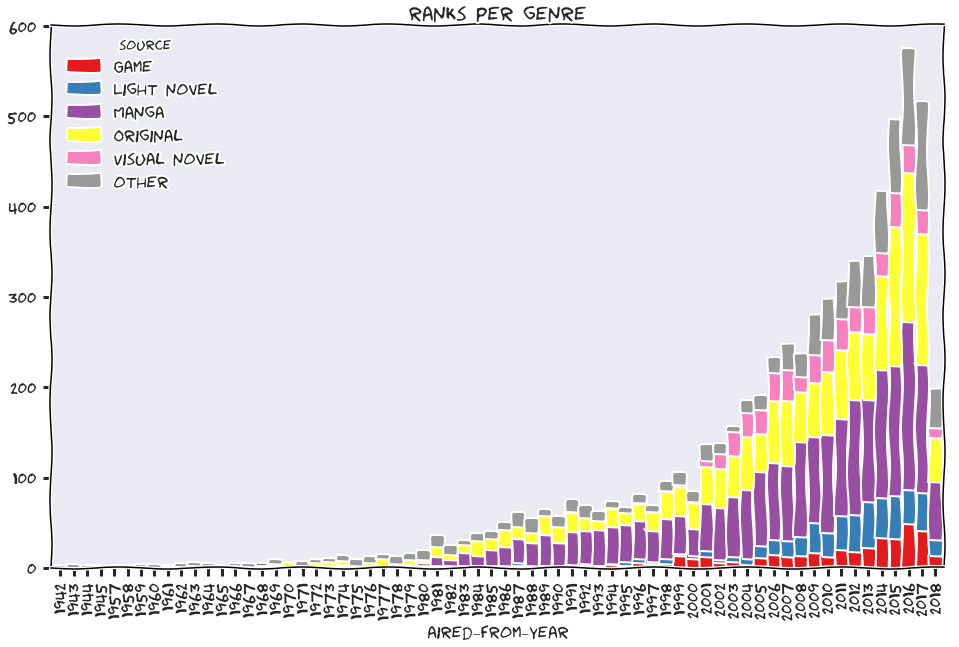

In [89]:
year_source.plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)

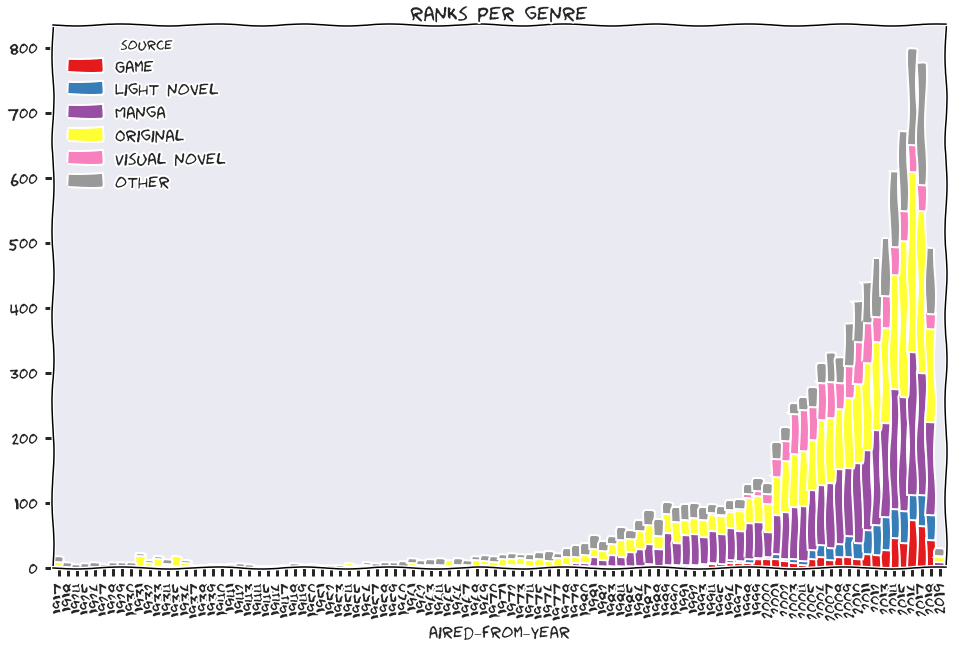

In [90]:
year_source_all.plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors_all, width=0.8)

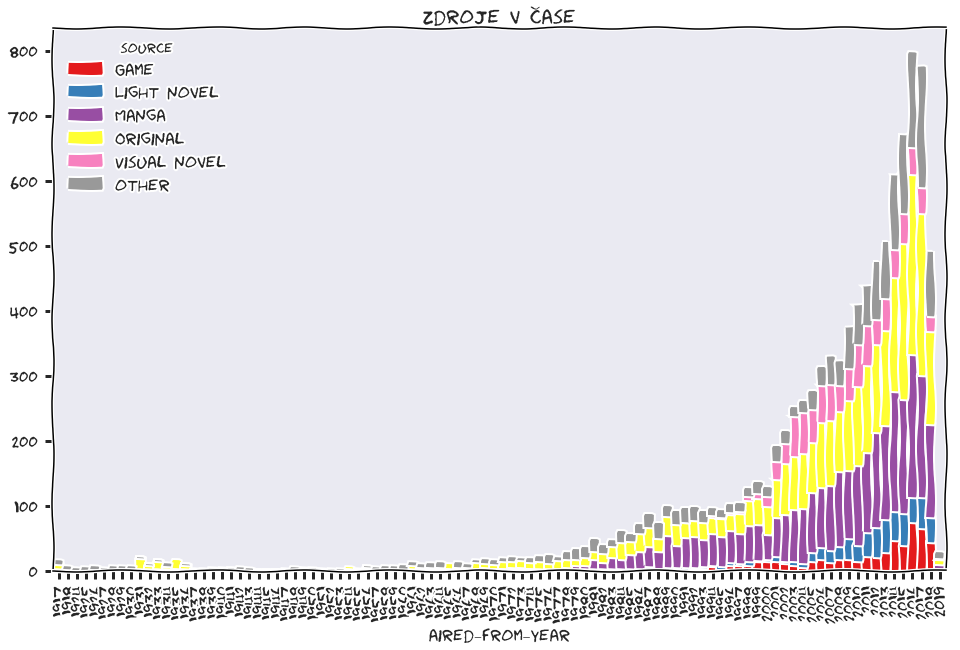

In [91]:
year_source_all.plot(kind='bar', stacked=True, figsize=(16, 10), title='Zdroje v čase', color=colors_all, width=0.8)
plt.xticks(rotation=90)
plt.savefig('graphs/zdroje-roky.png', bbox_inches="tight")

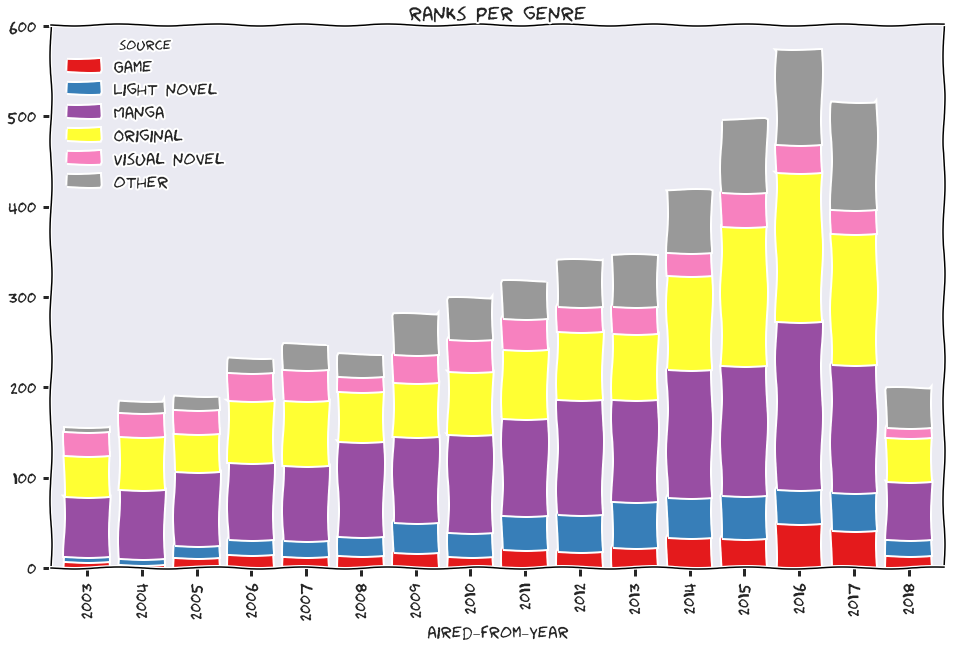

In [92]:
year_source[year_source.index >= 2003].plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)

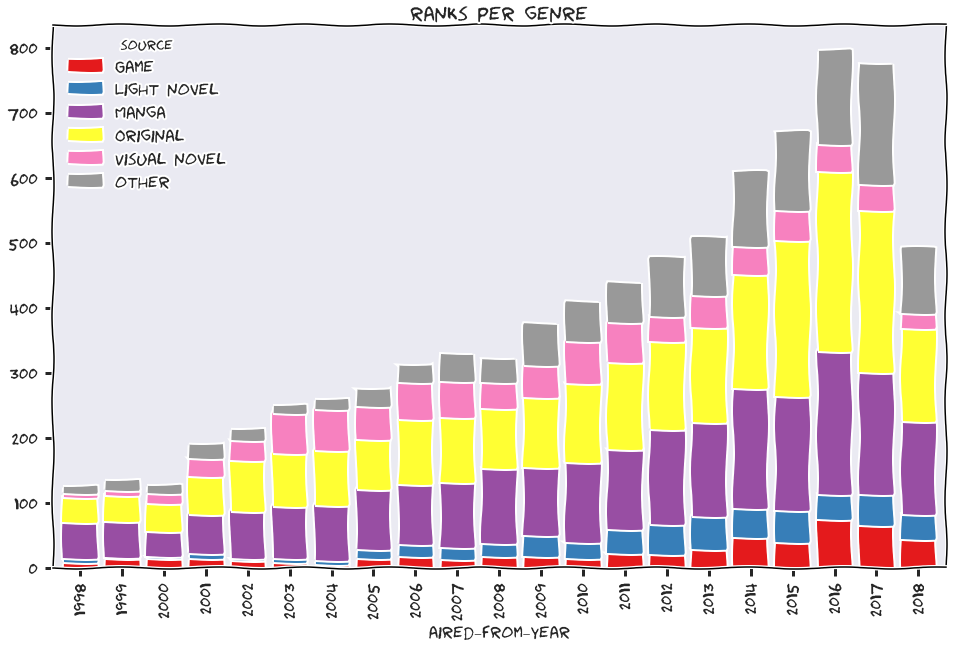

In [93]:
year_source_all.loc[1998:2018].plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)

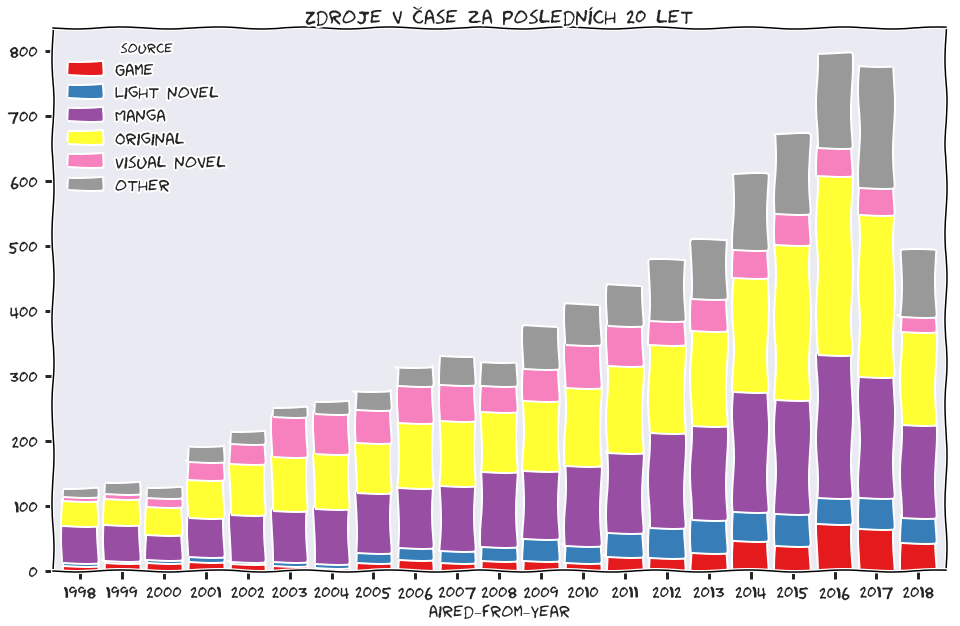

In [94]:
year_source_all.loc[1998:2018].plot(kind='bar', stacked=True, figsize=(16, 10), title='Zdroje v čase za posledních 20 let', color=colors_all, width=0.8)
plt.xticks(rotation=0)
plt.savefig('graphs/zdroje-roky-1998.png', bbox_inches="tight")

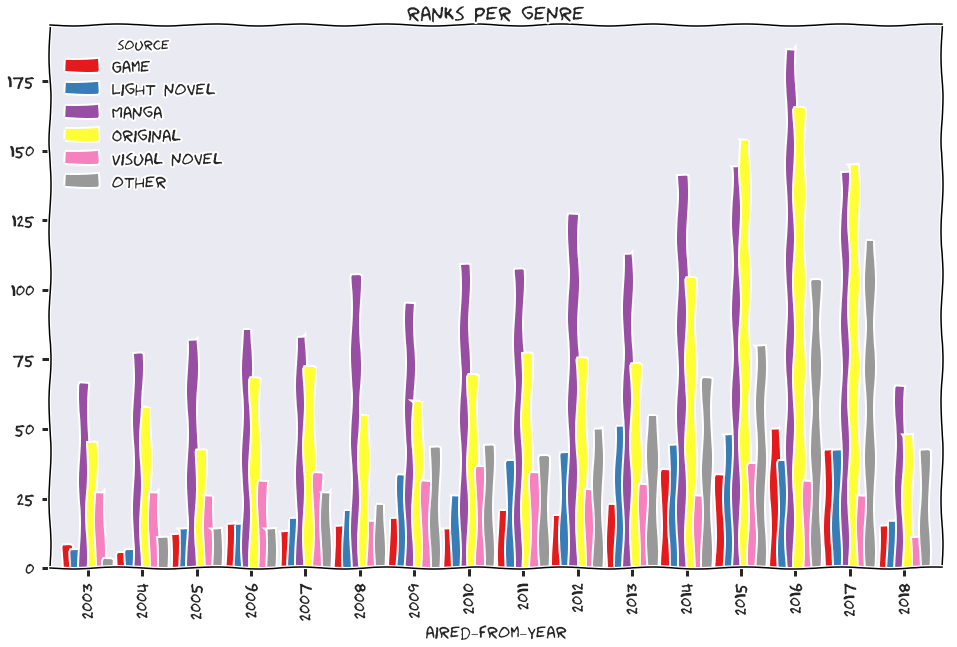

In [95]:
year_source[year_source.index >= 2003].plot(kind='bar', stacked=False, figsize=(16, 10), title='ranks per genre', color=colors, width=0.9)

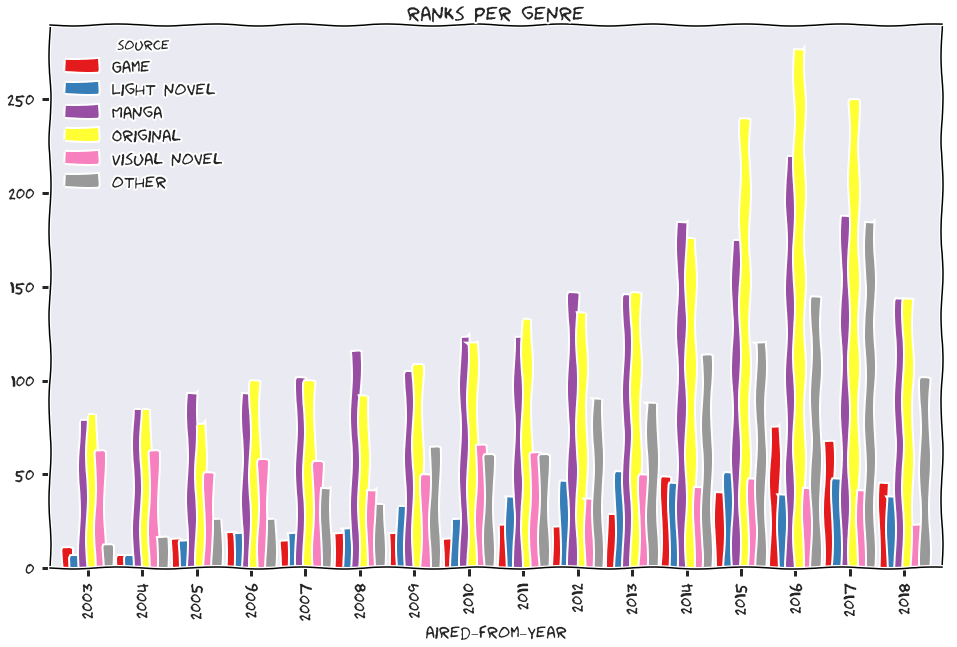

In [96]:
year_source_all.loc[2003:2018].plot(kind='bar', stacked=False, figsize=(16, 10), title='ranks per genre', color=colors, width=0.9)

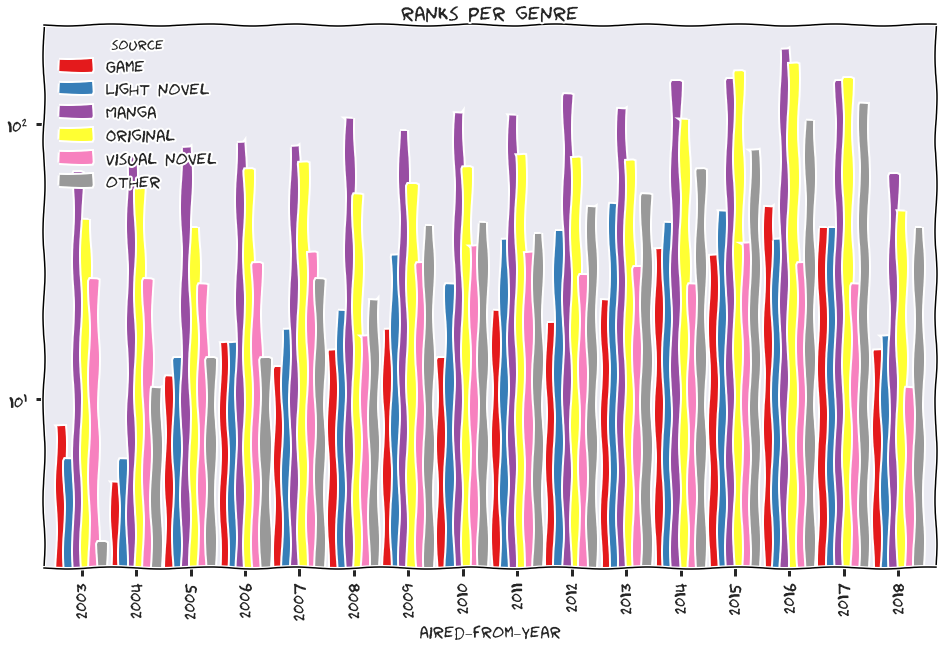

In [97]:
year_source[year_source.index >= 2003].plot(kind='bar', stacked=False, figsize=(16, 10), title='ranks per genre', color=colors, width=0.9, logy=True)

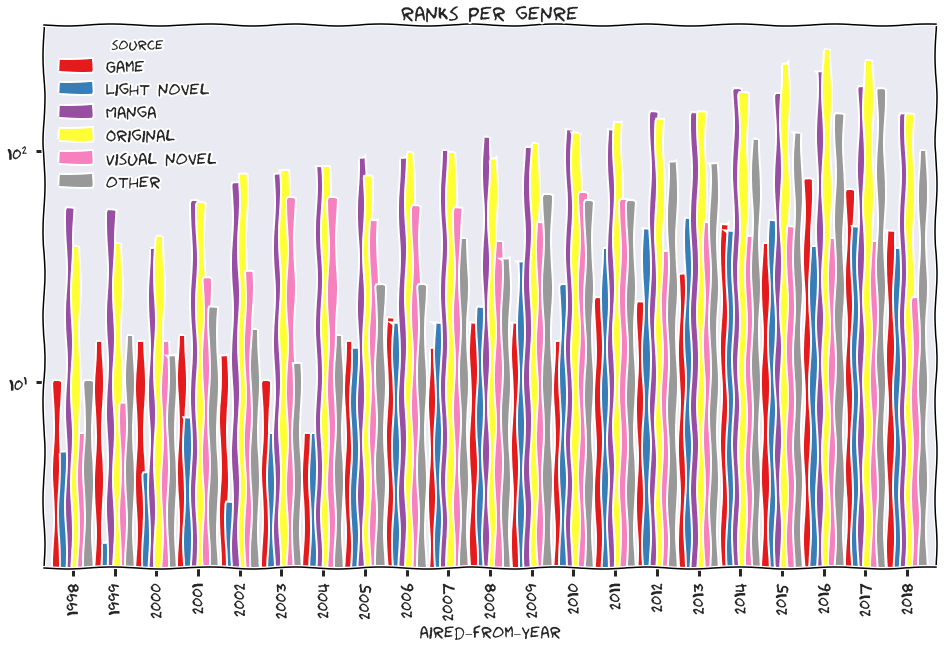

In [98]:
year_source_all.loc[1998:2018].plot(kind='bar', stacked=False, figsize=(16, 10), title='ranks per genre', color=colors, width=0.9, logy=True)

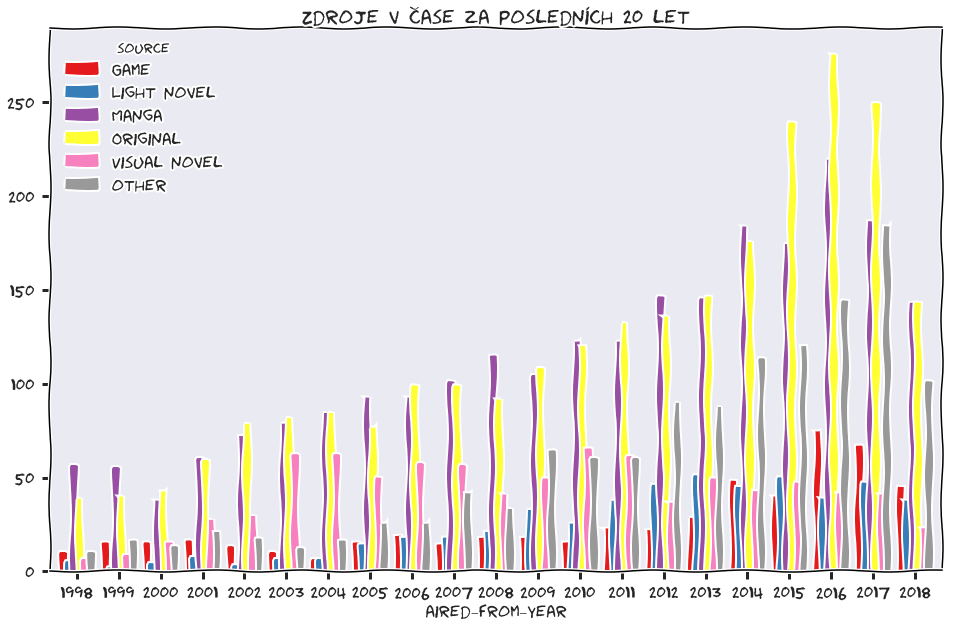

In [99]:
year_source_all.loc[1998:2018].plot(kind='bar', stacked=False, figsize=(16, 10), title='Zdroje v čase za posledních 20 let', color=colors_all, width=0.8)
plt.xticks(rotation=0)
plt.savefig('graphs/zdroje-roky-1998-podelne.png', bbox_inches="tight")

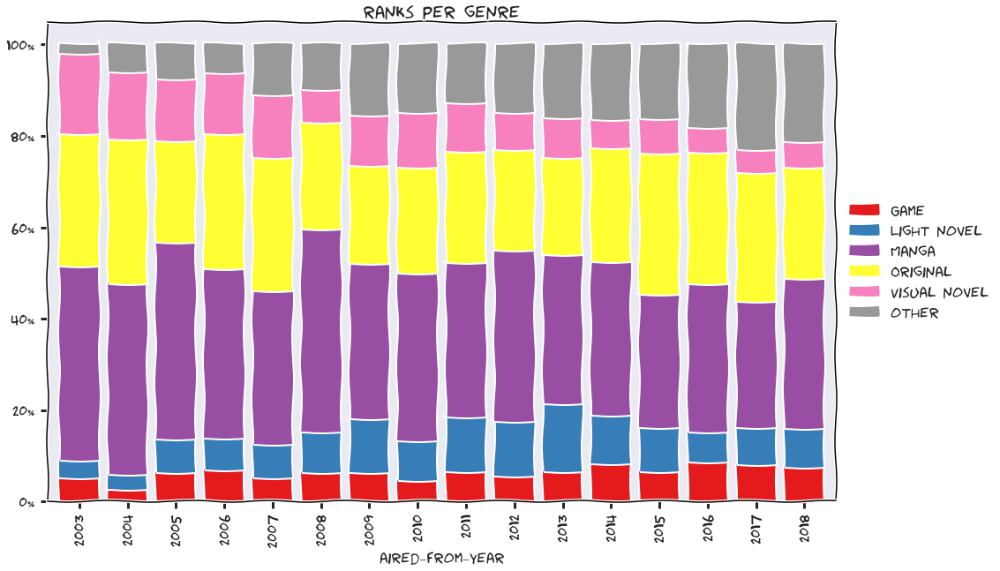

In [100]:
year_source.div(year_source.sum(axis=1), axis=0)[year_source.index >= 2003].plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

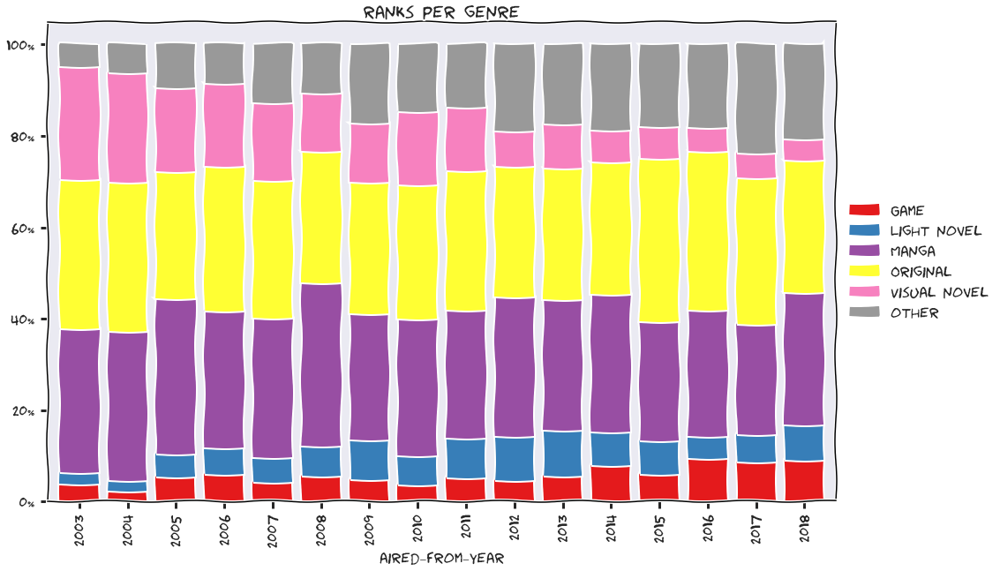

In [101]:
year_source_all.div(year_source_all.sum(axis=1), axis=0).loc[2003:2018].plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

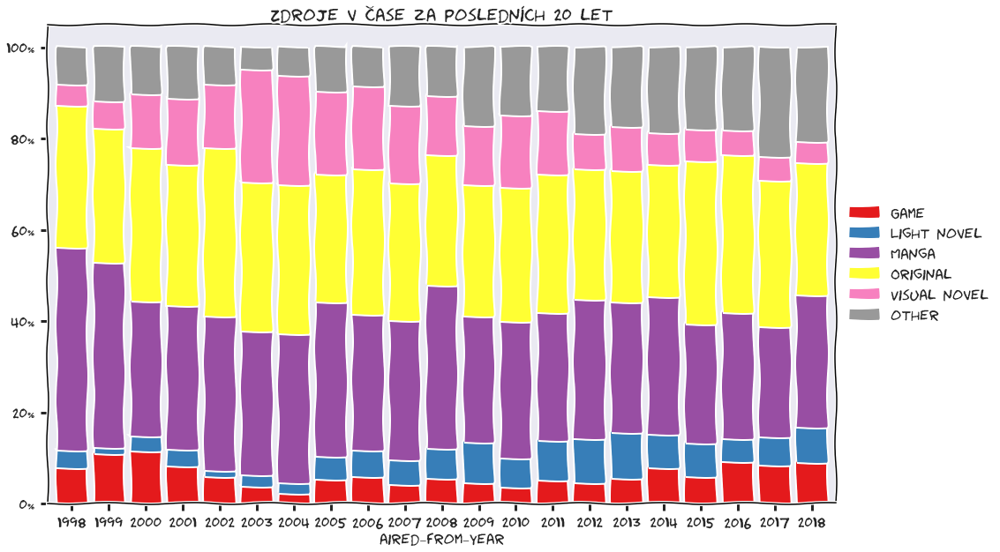

In [264]:
year_source_all.div(year_source_all.sum(axis=1), axis=0).loc[1998:2018].plot(kind='bar', stacked=True, figsize=(16, 10), title='Zdroje v čase za posledních 20 let', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=0)
plt.savefig('graphs/zdroje-roky-1998-normovano.png', bbox_inches="tight")

In [103]:
animes[animes['source'] == 'Unknown'].sort_values(by='popularity')[['title', 'source', 'studios', 'genres', 'popularity']]

,title,source,studios,genres,popularity
anime_id,,,,,


In [104]:
animes[(animes['source'] == 'Unknown') & (animes['studios'].isnull())].shape

(0, 32)

In [105]:
animes.head()

,title,title_english,title_japanese,title_synonyms,image_url,type,source,episodes,status,airing,...,broadcast,related,producer,licensor,studios,genres,opening_theme,ending_theme,duration_min,aired_from_year
anime_id,,,,,,,,,,,,,,,,,,,,,
11013,Inu x Boku SS,Inu X Boku Secret Service,妖狐×僕SS,Youko x Boku SS,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,12,Finished Airing,False,...,Fridays at Unknown,"{'Adaptation': [{'mal_id': 17207, 'type': 'man...","Aniplex, Square Enix, Mainichi Broadcasting Sy...",Sentai Filmworks,David Production,"Comedy, Supernatural, Romance, Shounen","['""Nirvana"" by MUCC']","['#1: ""Nirvana"" by MUCC (eps 1, 11-12)', '#2: ...",24.0,2012.0
2104,Seto no Hanayome,My Bride is a Mermaid,瀬戸の花嫁,The Inland Sea Bride,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,26,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 759, 'type': 'manga...","TV Tokyo, AIC, Square Enix, Sotsu",Funimation,Gonzo,"Comedy, Parody, Romance, School, Shounen","['""Romantic summer"" by SUN&LUNAR']","['#1: ""Ashita e no Hikari (明日への光)"" by Asuka Hi...",24.0,2007.0
5262,Shugo Chara!! Doki,Shugo Chara!! Doki,しゅごキャラ！！どきっ,"Shugo Chara Ninenme, Shugo Chara! Second Year",https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,51,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 101, 'type': 'manga...","TV Tokyo, Sotsu",NaN,Satelight,"Comedy, Magic, School, Shoujo","['#1: ""Minna no Tamago (みんなのたまご)"" by Shugo Cha...","['#1: ""Rottara Rottara (ロッタラ ロッタラ)"" by Buono! ...",24.0,2008.0
721,Princess Tutu,Princess Tutu,プリンセスチュチュ,NaN,https://myanimelist.cdn-dena.com/images/anime/...,TV,Original,38,Finished Airing,False,...,Fridays at Unknown,"{'Adaptation': [{'mal_id': 1581, 'type': 'mang...","Memory-Tech, GANSIS, Marvelous AQL",ADV Films,Hal Film Maker,"Comedy, Drama, Magic, Romance, Fantasy","['""Morning Grace"" by Ritsuko Okazaki']","['""Watashi No Ai Wa Chiisaikeredo"" by Ritsuko ...",16.0,2002.0
12365,Bakuman. 3rd Season,Bakuman.,バクマン。,Bakuman Season 3,https://myanimelist.cdn-dena.com/images/anime/...,TV,Manga,25,Finished Airing,False,...,Unknown,"{'Adaptation': [{'mal_id': 9711, 'type': 'mang...","NHK, Shueisha",NaN,J.C.Staff,"Comedy, Drama, Romance, Shounen","['#1: ""Moshimo no Hanashi (もしもの話)"" by nano.RIP...","['#1: ""Pride on Everyday"" by Sphere (eps 1-13)...",24.0,2012.0


In [106]:
animes_genres.head()

title              title_english title_japanese  \
anime_id                                                                 
11013    0     Inu x Boku SS  Inu X Boku Secret Service         妖狐×僕SS   
         1     Inu x Boku SS  Inu X Boku Secret Service         妖狐×僕SS   
         2     Inu x Boku SS  Inu X Boku Secret Service         妖狐×僕SS   
         3     Inu x Boku SS  Inu X Boku Secret Service         妖狐×僕SS   
2104     0  Seto no Hanayome      My Bride is a Mermaid          瀬戸の花嫁   

                  title_synonyms  \
anime_id                           
11013    0       Youko x Boku SS   
         1       Youko x Boku SS   
         2       Youko x Boku SS   
         3       Youko x Boku SS   
2104     0  The Inland Sea Bride   

                                                    image_url type source  \
anime_id                                                                    
11013    0  https://myanimelist.cdn-dena.com/images/anime/...   TV  Manga   
         1  https://myanimelist.cdn-dena.com/images/anime/...   TV  Manga   
         2  https://myanimelist.cdn-dena.com/images/anime/...   TV  Manga   
         3  https://myanimelist.cdn-dena.com/images/anime/...   TV  Manga   
2104     0  https://myanimelist.cdn-dena.com/images/anime/...   TV  Manga   

            episodes           status  airing      ...       \
anime_id                                           ...        
11013    0        12  Finished Airing   False      ...        
         1        12  Finished Airing   False      ...        
         2        12  Finished Airing   False      ...        
         3        12  Finished Airing   False      ...        
2104     0        26  Finished Airing   False      ...        

                                                      related  \
anime_id                                                        
11013    0  {'Adaptation': [{'mal_id': 17207, 'type': 'man...   
         1  {'Adaptation': [{'mal_id': 17207, 'type': 'man...   
         2  {'Adaptation': [{'mal_id': 17207, 'type': 'man...   
         3  {'Adaptation': [{'mal_id': 17207, 'type': 'man...   
2104     0  {'Adaptation': [{'mal_id': 759, 'type': 'manga...   

                                                     producer  \
anime_id                                                        
11013    0  Aniplex, Square Enix, Mainichi Broadcasting Sy...   
         1  Aniplex, Square Enix, Mainichi Broadcasting Sy...   
         2  Aniplex, Square Enix, Mainichi Broadcasting Sy...   
         3  Aniplex, Square Enix, Mainichi Broadcasting Sy...   
2104     0                  TV Tokyo, AIC, Square Enix, Sotsu   

                    licensor           studios  \
anime_id                                         
11013    0  Sentai Filmworks  David Production   
         1  Sentai Filmworks  David Production   
         2  Sentai Filmworks  David Production   
         3  Sentai Filmworks  David Production   
2104     0        Funimation             Gonzo   

                                              genres  \
anime_id                                               
11013    0    Comedy, Supernatural, Romance, Shounen   
         1    Comedy, Supernatural, Romance, Shounen   
         2    Comedy, Supernatural, Romance, Shounen   
         3    Comedy, Supernatural, Romance, Shounen   
2104     0  Comedy, Parody, Romance, School, Shounen   

                                 opening_theme  \
anime_id                                         
11013    0               ['"Nirvana" by MUCC']   
         1               ['"Nirvana" by MUCC']   
         2               ['"Nirvana" by MUCC']   
         3               ['"Nirvana" by MUCC']   
2104     0  ['"Romantic summer" by SUN&LUNAR']   

                                                 ending_theme  duration_min  \
anime_id                                                                      
11013    0  ['#1: "Nirvana" by MUCC (eps 1, 11-12)', '#2: ...          24.0   
         1  ['#1: "Nirvan

In [107]:
animes_genres.shape

(23746, 33)

In [108]:
animes_genres = animes_genres[animes_genres['genre'] != '']

In [109]:
rank_count = animes_genres['rating'].unique().size

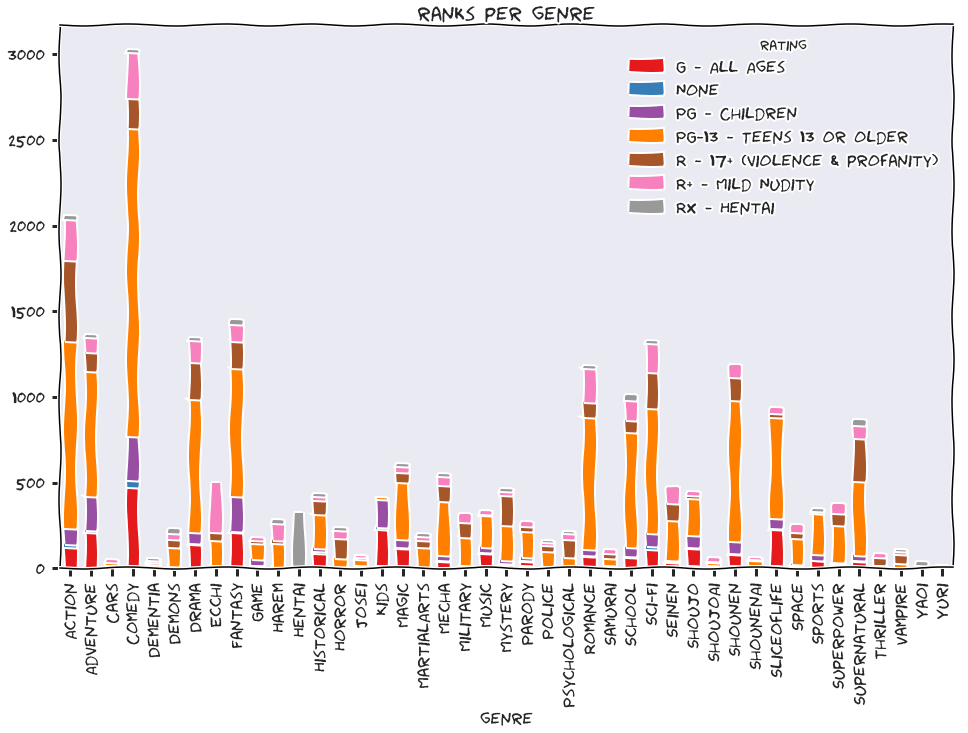

In [110]:
colors = plt.cm.Set1(np.linspace(0, 1, rank_count))
genre_ranks = pd.crosstab(animes_genres['genre'], animes_genres['rating'])
genre_ranks.plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors)

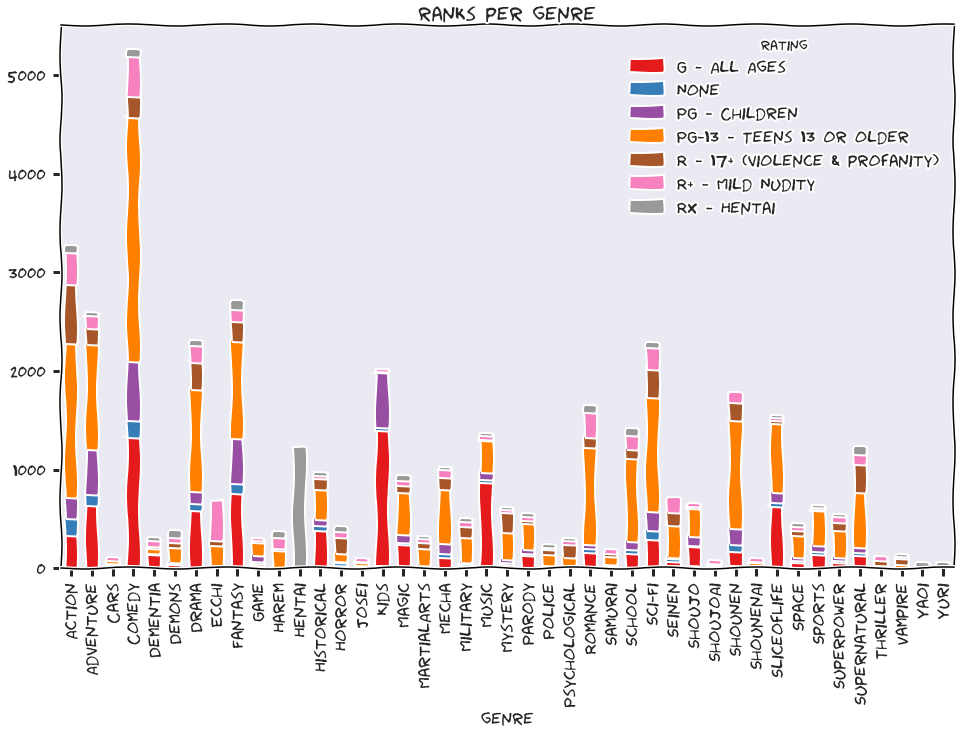

In [111]:
genre_ranks_all = pd.crosstab(animes_genres_all['genre'], animes_genres_all['rating'])
genre_ranks_all.plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors)

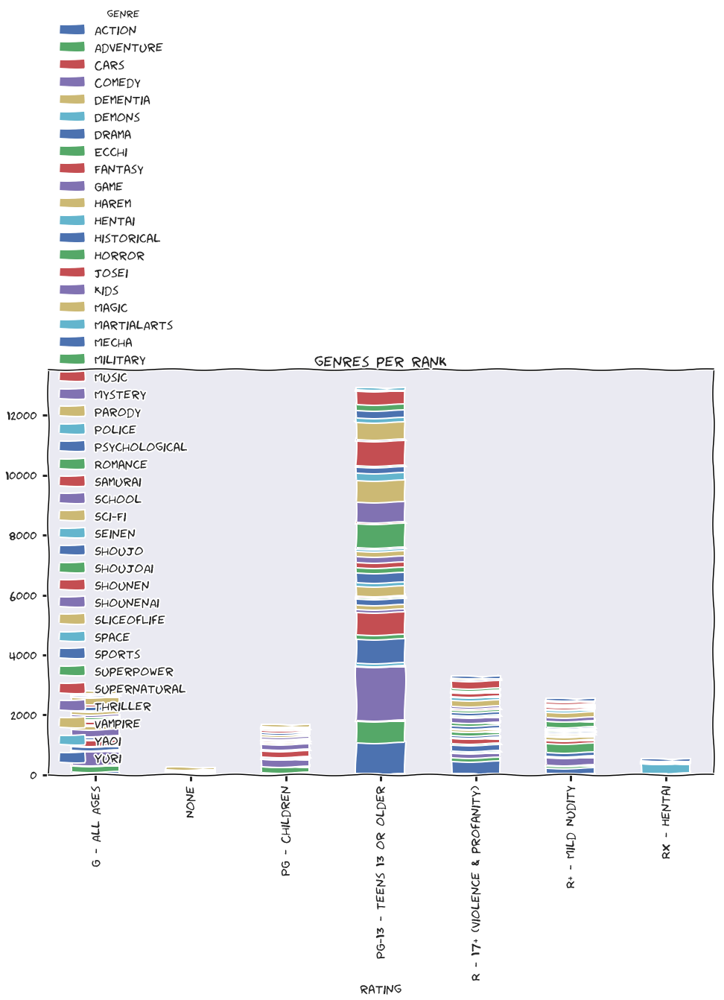

In [112]:
rank_genres = pd.crosstab(animes_genres['rating'], animes_genres['genre'])
rank_genres.plot(kind='bar', stacked=True, figsize=(16, 10), title='genres per rank')

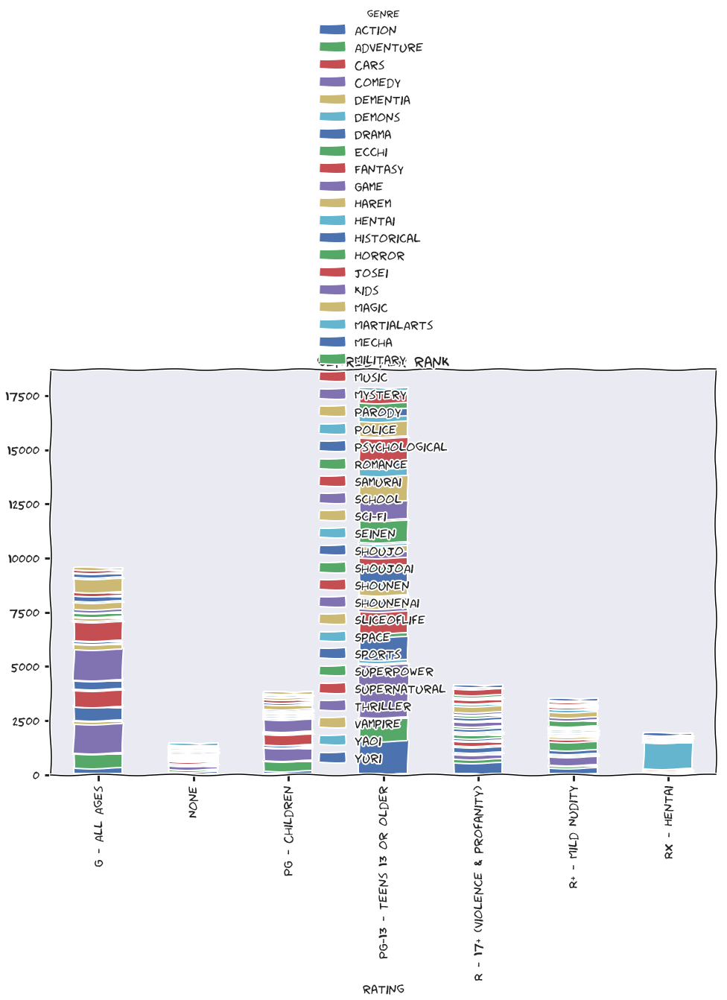

In [113]:
rank_genres_all = pd.crosstab(animes_genres_all['rating'], animes_genres_all['genre'])
rank_genres_all.plot(kind='bar', stacked=True, figsize=(16, 10), title='genres per rank')

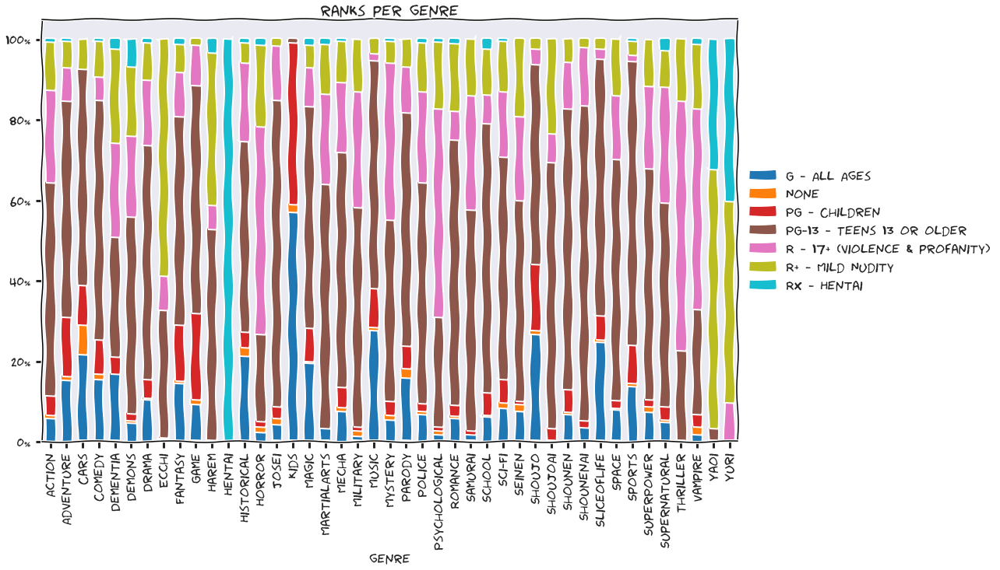

In [114]:
colors = plt.cm.tab10(np.linspace(0, 1, rank_count))
genre_ranks.div(genre_ranks.sum(axis=1), axis=0).plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

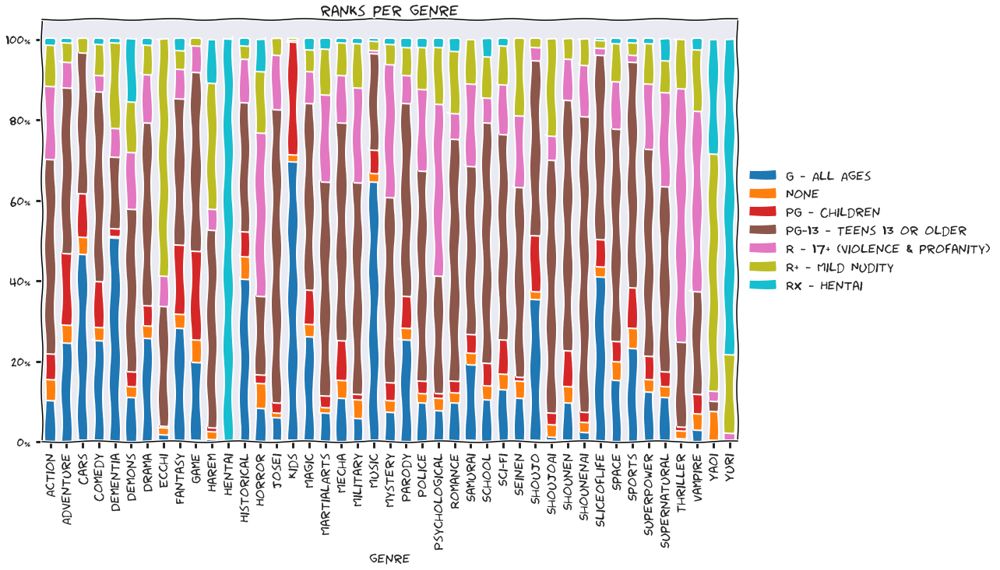

In [115]:
colors = plt.cm.tab10(np.linspace(0, 1, rank_count))
genre_ranks_all.div(genre_ranks_all.sum(axis=1), axis=0).plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

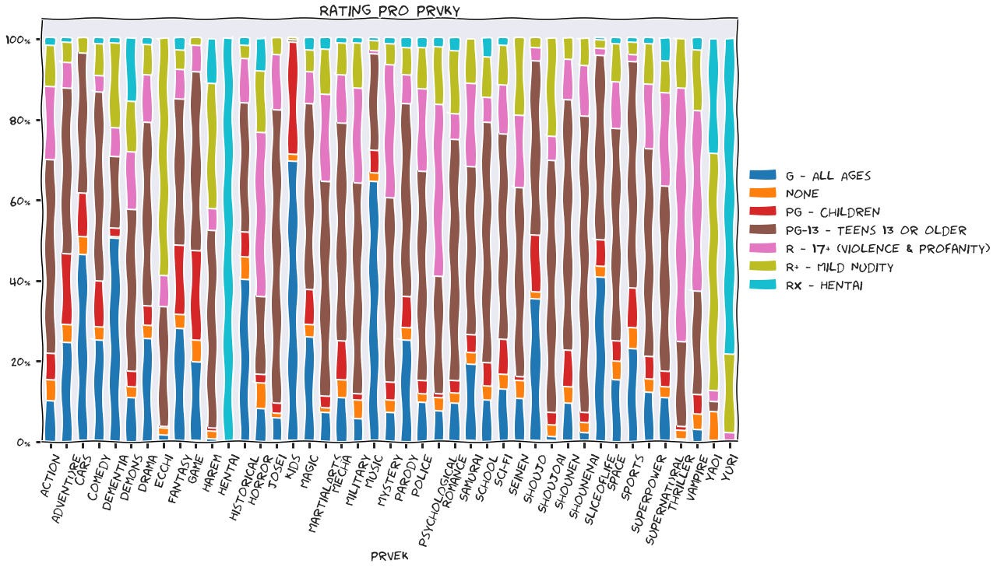

In [271]:
colors = plt.cm.tab10(np.linspace(0, 1, rank_count))
genre_ranks_all.div(genre_ranks_all.sum(axis=1), axis=0).plot(kind='bar', stacked=True, figsize=(16, 10), title='Rating pro prvky', color=colors)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=70)
plt.xlabel('prvek')
plt.savefig('graphs/zanry-rating.png', bbox_inches="tight")

## inspecting studios and genres

In [117]:
print('unique studios combinations:')
animes['studios'].unique().size

unique studios combinations:


711

In [118]:
# now comes some data cleaning, getting rid of commas in studio names for easier manipulation
animes.loc[animes['studios'] == 'Yamamura Animation, Inc.', 'studios'] = 'Yamamura Animation'
animes.loc[animes['studios'] == 'Brain&#039;sBase', 'studios'] = 'BrainsBase'

# here, in animes_genres, is every anime duplicated, once per each genre it contains
animes['studios'].fillna('', inplace=True)
studios_arr = animes['studios'].apply(lambda x: x.replace(' ', '').split(',')).apply(pd.Series).stack().to_frame(name='studio')
studios_arr.loc[studios_arr['studio'] == 'Brain&#039;sBase', 'studio'] = 'BrainsBase'
studios_arr.index.levels[0].name = 'anime_id'
animes_studios = pd.merge(animes, studios_arr, how='inner', left_index=True, right_index=True)
animes_studios = animes_studios[animes_studios['studio'] != '']

In [119]:
# now comes some data cleaning, getting rid of commas in studio names for easier manipulation
animes_all.loc[animes_all['studios'] == 'Yamamura Animation, Inc.', 'studios'] = 'Yamamura Animation'
animes_all.loc[animes_all['studios'] == 'Brain&#039;sBase', 'studios'] = 'BrainsBase'
# here, in animes_genres, is every anime duplicated, once per each genre it contains
animes_all['studios'].fillna('', inplace=True)
studios_arr_all = animes_all['studios'].apply(lambda x: x.replace(' ', '').split(',')).apply(pd.Series).stack().to_frame(name='studio')
studios_arr_all.loc[studios_arr_all['studio'] == 'Brain&#039;sBase', 'studio'] = 'BrainsBase'
studios_arr_all.index.levels[0].name = 'anime_id'
animes_studios_all = pd.merge(animes_all, studios_arr_all, how='inner', left_index=True, right_index=True)
animes_studios_all = animes_studios_all[animes_studios_all['studio'] != '']

In [120]:
print('unique studios:')
animes_studios['studio'].unique().size

unique studios:


474

In [121]:
print('unique studios:')
animes_studios_all['studio'].unique().size

unique studios:


508

In [122]:
animes_studios['studio'].value_counts().sort_values(ascending=False)

ToeiAnimation                      419
Sunrise                            291
Madhouse                           277
J.C.Staff                          251
StudioPierrot                      248
StudioDeen                         223
ProductionI.G                      222
A-1Pictures                        174
TMSEntertainment                   172
OLM                                151
Gonzo                              121
Xebec                              118
Shaft                              116
NipponAnimation                    111
Bones                              110
KyotoAnimation                     104
AIC                                103
DLE                                 94
TatsunokoProduction                 92
BrainsBase                          85
Satelight                           80
Gainax                              80
SilverLink.                         75
Shin-EiAnimation                    69
Arms                                66
feel.                    

In [123]:
known_studios = animes_studios['studio'].value_counts().sort_values(ascending=False).index[0:35]
known_studios

Index(['ToeiAnimation', 'Sunrise', 'Madhouse', 'J.C.Staff', 'StudioPierrot',
       'StudioDeen', 'ProductionI.G', 'A-1Pictures', 'TMSEntertainment', 'OLM',
       'Gonzo', 'Xebec', 'Shaft', 'NipponAnimation', 'Bones', 'KyotoAnimation',
       'AIC', 'DLE', 'TatsunokoProduction', 'BrainsBase', 'Satelight',
       'Gainax', 'SilverLink.', 'Shin-EiAnimation', 'Arms', 'feel.',
       'ProductionReed', 'Zexcs', 'DogaKobo', 'ufotable', 'StudioGhibli',
       'Seven', 'Artland', 'StudioGallop', 'PoRO'],
      dtype='object')

In [124]:
known_studios_all = animes_studios_all['studio'].value_counts().sort_values(ascending=False).index[0:35]
known_studios_all

Index(['ToeiAnimation', 'Sunrise', 'Madhouse', 'J.C.Staff', 'ProductionI.G',
       'TMSEntertainment', 'StudioDeen', 'StudioPierrot', 'NipponAnimation',
       'OLM', 'A-1Pictures', 'Shin-EiAnimation', 'TatsunokoProduction',
       'Xebec', 'DLE', 'Gonzo', 'Shaft', 'AIC', 'Bones', 'KyotoAnimation',
       'Satelight', 'ProductionReed', 'BrainsBase', 'SilverLink.', 'Gainax',
       'Arms', 'Studio4°C', 'Zexcs', 'DogaKobo', 'feel.', 'ufotable', 'Seven',
       'StudioGallop', 'StudioHibari', 'StudioGhibli'],
      dtype='object')

In [125]:
#animes['studios'].value_counts().plot(kind='bar', figsize=(16, 10), logy=True)

In [126]:
#animes_studios['studio'].value_counts().plot(kind='bar', figsize=(16, 10), logy=True)

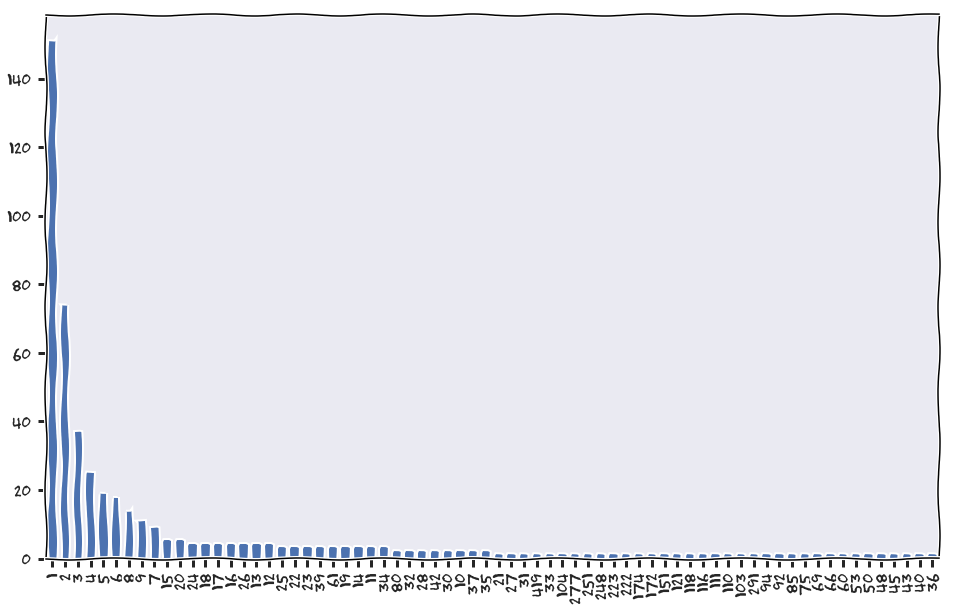

In [127]:
animes_studios['studio'].value_counts().value_counts().plot(kind='bar', figsize=(16, 10))

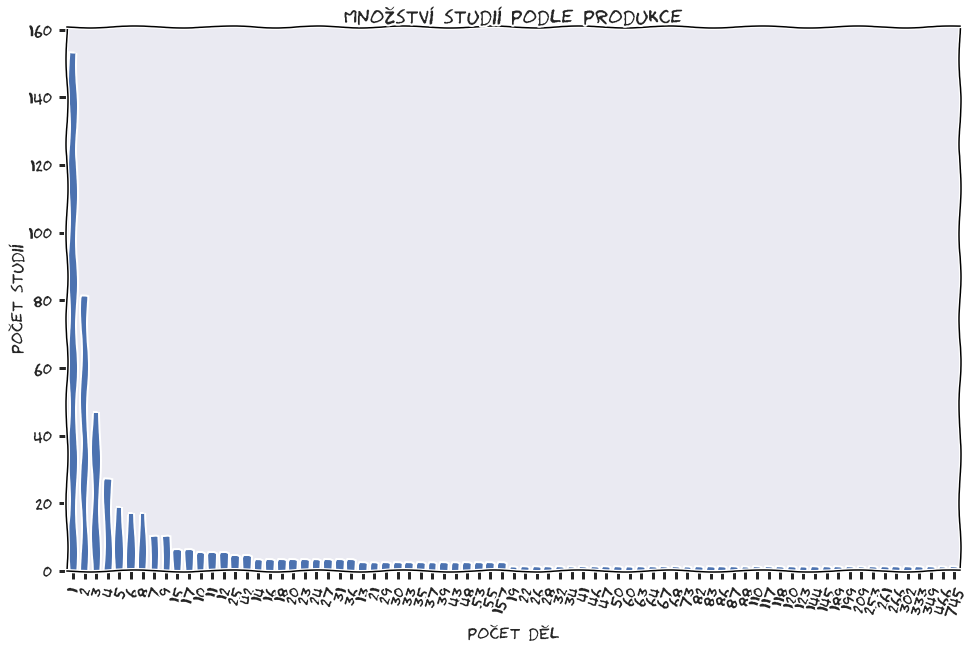

In [128]:
# sorting by merge sort keeps the sorting by values unchanged
animes_studios_all['studio'].value_counts().value_counts().sort_index(ascending=False).sort_values(kind='mergesort', ascending=False).plot(kind='bar', figsize=(16, 10), title='Množství studií podle produkce')
plt.xticks(rotation=70)
plt.xlabel('počet děl')
plt.ylabel('počet studií')
plt.savefig('graphs/produkce-studii-histogram.png', bbox_inches="tight")

In [131]:
studio_counts_all = animes_studios_all['studio'].value_counts().sort_values(ascending=False)
# bigger studios are with 10 or more anime
bigger_studios_all = studio_counts_all[studio_counts_all >= 10].index
print('# studios with 10 or more anime')
len(bigger_studios_all)

# studios with 10 or more anime


127

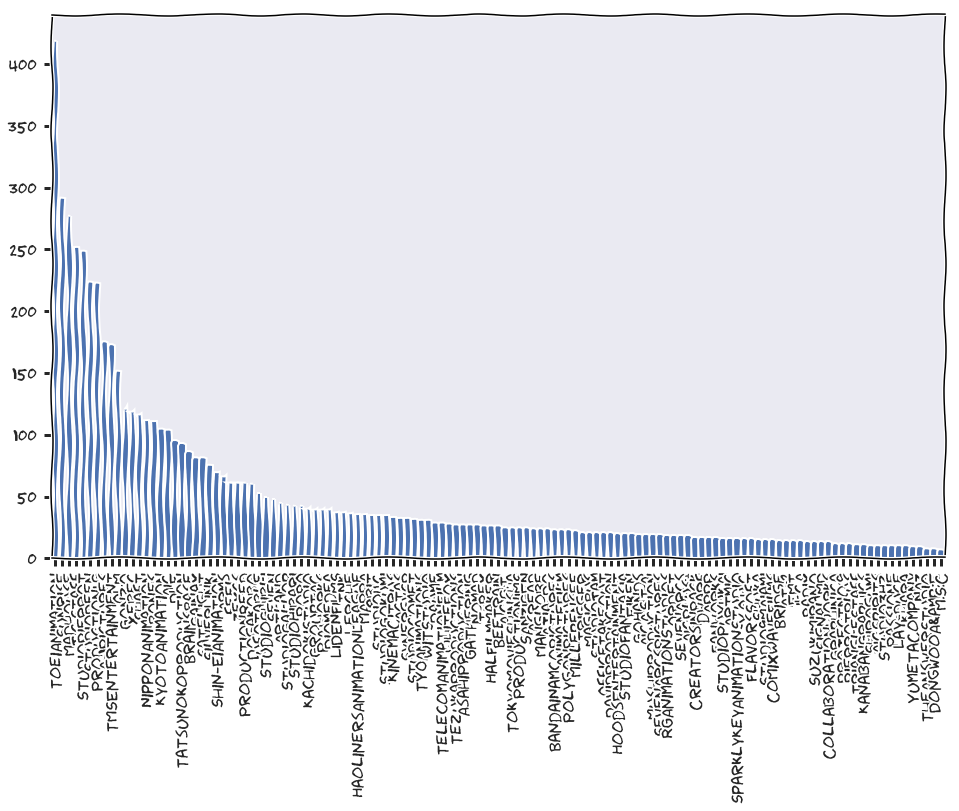

In [134]:
animes_studios[animes_studios['studio'].isin(bigger_studios_all)]['studio'].value_counts().plot(kind='bar', figsize=(16, 10))

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34]), <a list of 35 Text xticklabel objects>)

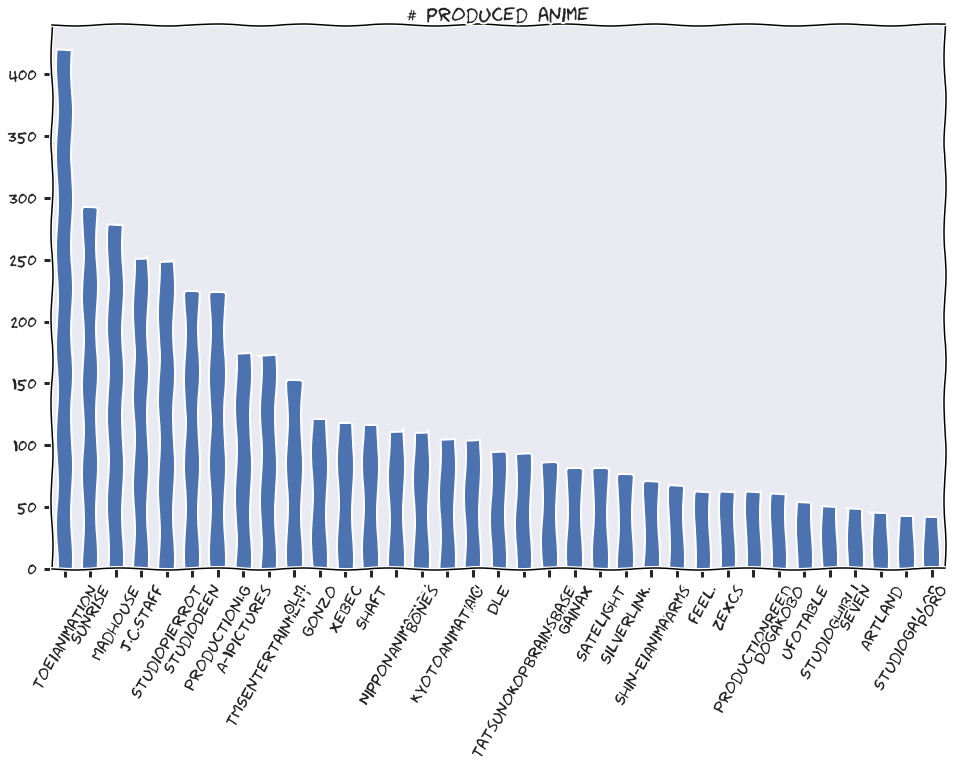

In [135]:
animes_studios[animes_studios['studio'].isin(known_studios)]['studio'].value_counts().plot(kind='bar', figsize=(16, 10), title='# produced anime')
plt.xticks(rotation=60)

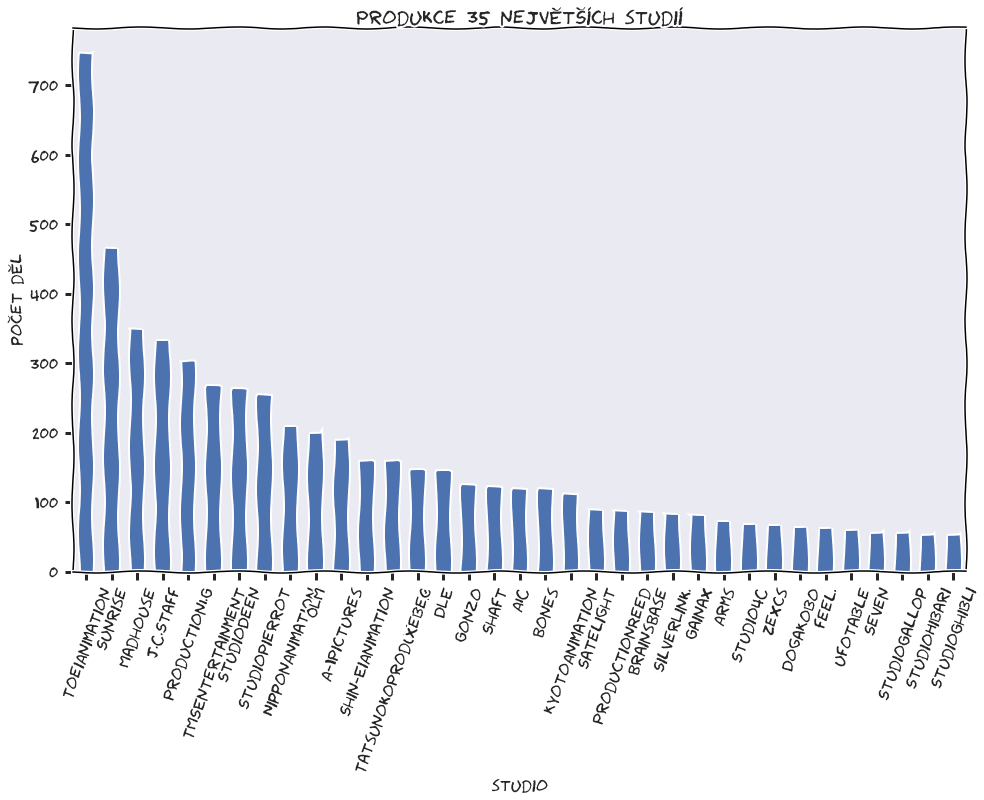

In [136]:
animes_studios_all[animes_studios_all['studio'].isin(known_studios_all)]['studio'].value_counts().plot(kind='bar', figsize=(16, 10), title='Produkce 35 největších studií')
plt.xticks(rotation=70)
plt.ylabel('počet děl')
plt.xlabel('studio')
plt.savefig('graphs/produkce-studii-known.png', bbox_inches="tight")

In [137]:
animes_studios_genres = pd.merge(animes_studios.reset_index(), genres_arr.reset_index(), how='inner', on='anime_id').drop(['level_1_x', 'level_1_y'], axis=1)
animes_studios_genres = animes_studios_genres[animes_studios_genres['genre'] != '']
animes_studios_genres = animes_studios_genres[animes_studios_genres['studio'] != '']


In [138]:
animes_studios_genres_all = pd.merge(animes_studios_all.reset_index(), genres_arr_all.reset_index(), how='inner', on='anime_id').drop(['level_1_x', 'level_1_y'], axis=1)
animes_studios_genres_all = animes_studios_genres_all[animes_studios_genres_all['genre'] != '']
animes_studios_genres_all = animes_studios_genres_all[animes_studios_genres_all['studio'] != '']


In [139]:
studios_genres = pd.crosstab(animes_studios_genres['studio'], animes_studios_genres['genre'])
# only for known studios
studios_genres = studios_genres[studios_genres.index.isin(known_studios)]

In [140]:
studios_genres_all = pd.crosstab(animes_studios_genres_all['studio'], animes_studios_genres_all['genre'])
studios_genres_all = studios_genres_all[studios_genres_all.index.isin(known_studios_all)]

In [141]:
studios_genres.columns

Index(['Action', 'Adventure', 'Cars', 'Comedy', 'Dementia', 'Demons', 'Drama',
       'Ecchi', 'Fantasy', 'Game', 'Harem', 'Hentai', 'Historical', 'Horror',
       'Josei', 'Kids', 'Magic', 'MartialArts', 'Mecha', 'Military', 'Music',
       'Mystery', 'Parody', 'Police', 'Psychological', 'Romance', 'Samurai',
       'School', 'Sci-Fi', 'Seinen', 'Shoujo', 'ShoujoAi', 'Shounen',
       'ShounenAi', 'SliceofLife', 'Space', 'Sports', 'SuperPower',
       'Supernatural', 'Thriller', 'Vampire', 'Yaoi', 'Yuri'],
      dtype='object', name='genre')

In [142]:
interesting_genres = ['Action', 'Adventure', 'Comedy', 'Drama',
       'Fantasy', 'Hentai', 
       'Kids', 'Magic', 'Mecha', 'Music',
       'Mystery', 'Romance', 
       'Sci-Fi', 'SliceofLife']

In [143]:
# group rest of genres to "other" value
other_genres = list(set(studios_genres.columns) - set(interesting_genres))
studios_genres['other'] = studios_genres[other_genres].sum(axis=1)
studios_genres.drop(other_genres, inplace=True, axis=1)
studios_genres

genre,Action,Adventure,Comedy,Drama,Fantasy,Hentai,Kids,Magic,Mecha,Music,Mystery,Romance,Sci-Fi,SliceofLife,other
studio,,,,,,,,,,,,,,,
A-1Pictures,66,28,85,25,59,0,2,22,5,26,11,33,28,24,216
AIC,47,30,51,16,16,1,0,14,24,2,4,34,50,8,184
Arms,29,15,15,10,18,20,1,2,0,0,2,10,5,4,94
Artland,14,12,16,7,14,0,0,4,5,3,10,12,12,8,71
Bones,67,30,47,38,28,0,1,6,19,7,23,20,39,4,148
BrainsBase,19,9,46,18,18,0,0,2,9,2,6,25,7,20,146
DLE,5,1,73,1,5,0,7,0,1,6,2,0,3,13,84
DogaKobo,11,2,43,8,12,0,0,0,1,1,3,13,3,24,83
Gainax,30,12,43,15,5,0,2,8,22,7,4,12,34,5,110


In [144]:
# group rest of genres to "other" value
other_genres = list(set(studios_genres_all.columns) - set(interesting_genres))
studios_genres_all['other'] = studios_genres_all[other_genres].sum(axis=1)
studios_genres_all.drop(other_genres, inplace=True, axis=1)
studios_genres_all

genre,Action,Adventure,Comedy,Drama,Fantasy,Hentai,Kids,Magic,Mecha,Music,Mystery,Romance,Sci-Fi,SliceofLife,other
studio,,,,,,,,,,,,,,,
A-1Pictures,71,30,90,25,63,0,2,23,5,30,11,34,32,26,226
AIC,51,32,58,16,20,3,0,16,26,2,4,39,55,9,204
Arms,31,15,19,10,18,20,1,3,0,0,2,10,5,4,106
Bones,69,32,50,41,29,0,2,6,21,8,23,21,41,5,152
BrainsBase,20,10,46,18,18,0,0,2,10,2,6,25,8,20,149
DLE,7,1,118,1,6,0,8,0,2,7,2,1,4,15,133
DogaKobo,11,2,46,8,12,0,0,0,1,1,3,14,3,26,86
Gainax,30,12,43,15,5,0,2,8,22,7,4,12,36,5,112
Gonzo,63,34,48,28,22,0,1,7,32,1,7,16,57,9,157


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34]), <a list of 35 Text xticklabel objects>)

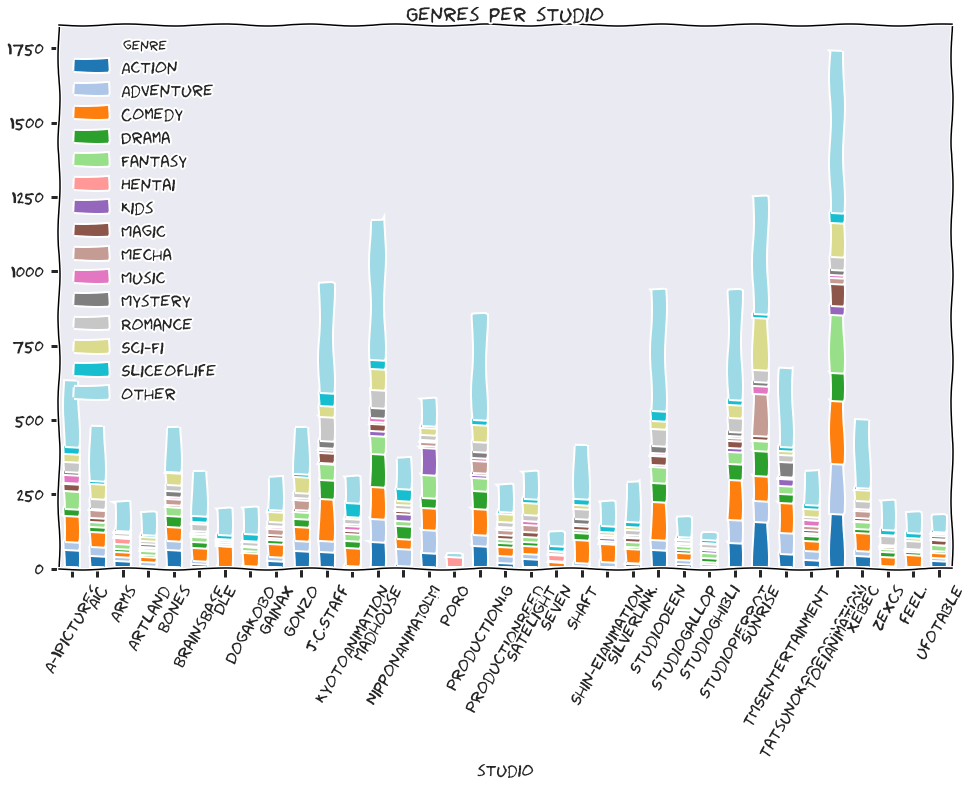

In [145]:
colors = plt.cm.tab20(np.linspace(0, 1, studios_genres.shape[1]))
studios_genres.plot.bar(stacked=True, figsize=(16, 10), title='Genres per studio', color=colors)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34]), <a list of 35 Text xticklabel objects>)

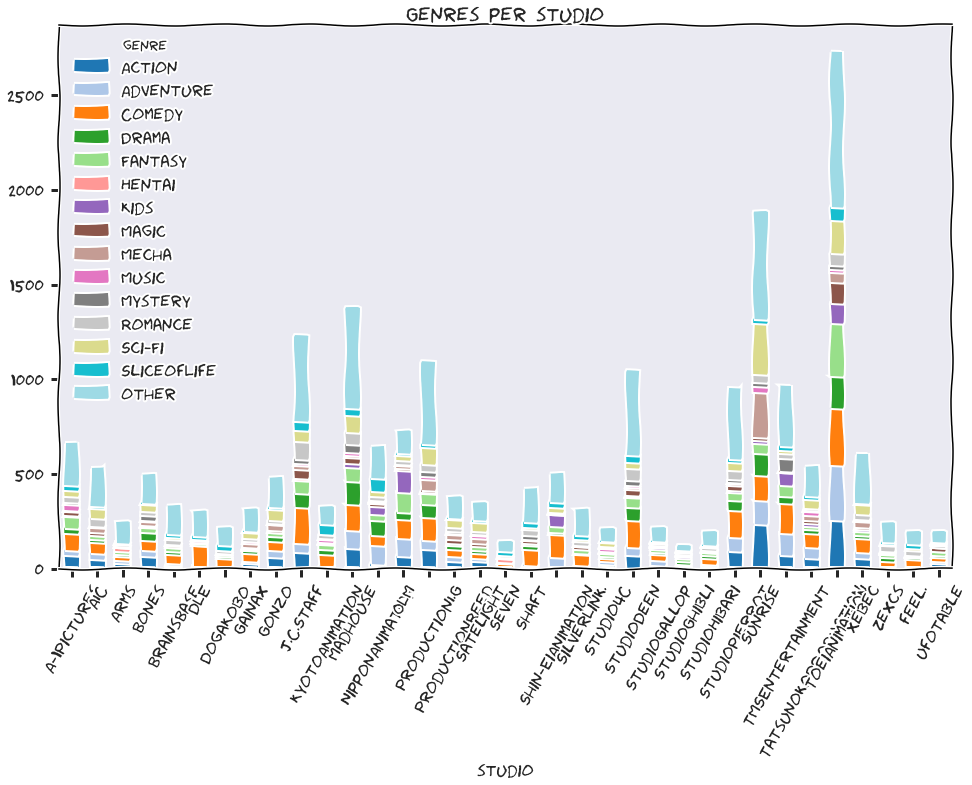

In [146]:
colors = plt.cm.tab20(np.linspace(0, 1, studios_genres_all.shape[1]))
studios_genres_all.plot.bar(stacked=True, figsize=(16, 10), title='Genres per studio', color=colors)
plt.xticks(rotation=60)

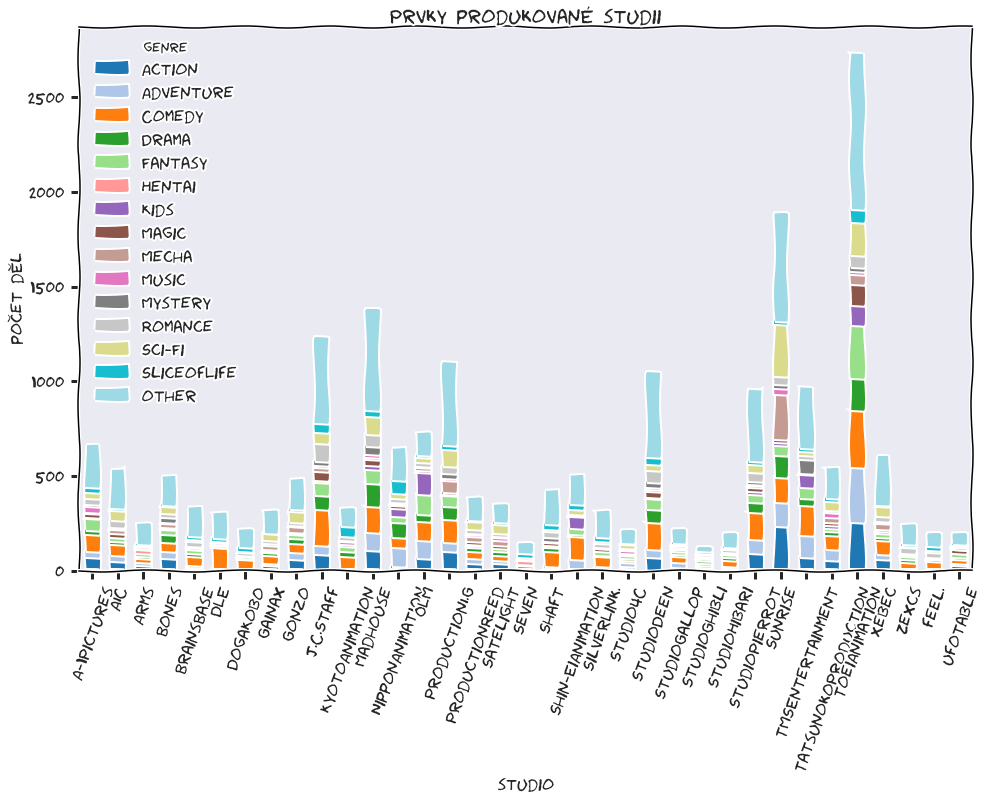

In [147]:
colors = plt.cm.tab20(np.linspace(0, 1, studios_genres_all.shape[1]))
studios_genres_all.plot.bar(stacked=True, figsize=(16, 10), title='Prvky produkované studii', color=colors)
plt.xticks(rotation=70)
plt.ylabel('počet děl')
plt.xlabel('studio')
plt.savefig('graphs/produkce-studii-prvky.png', bbox_inches="tight")

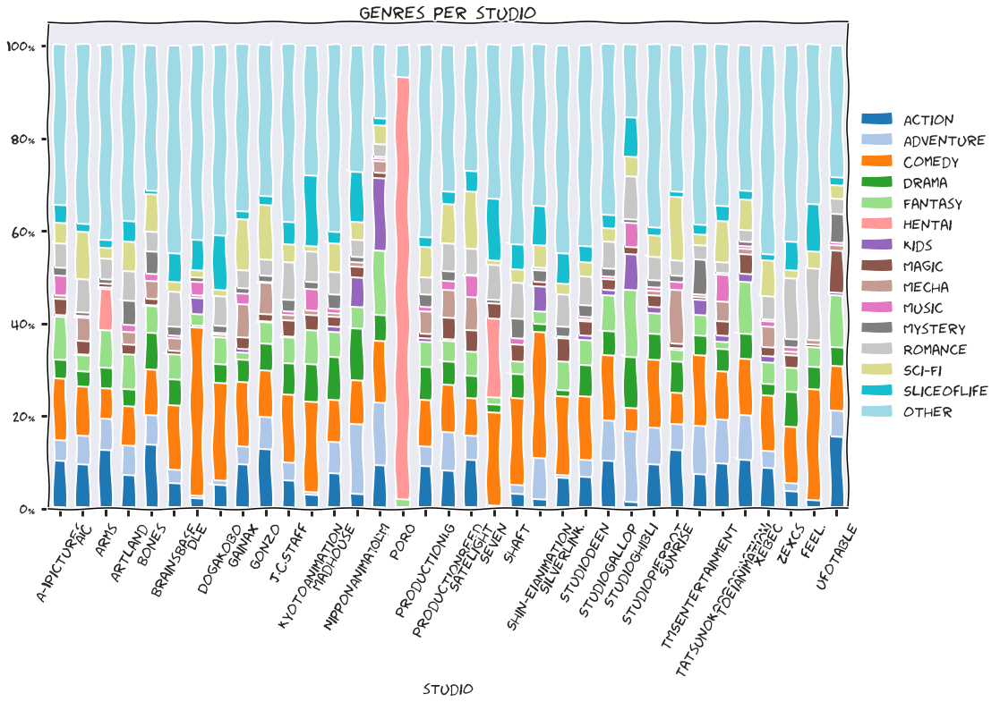

In [148]:
studios_genres.div(studios_genres.sum(axis=1), axis=0).plot.bar(stacked=True, figsize=(16, 10), title='Genres per studio', color=colors)
plt.xticks(rotation=60)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

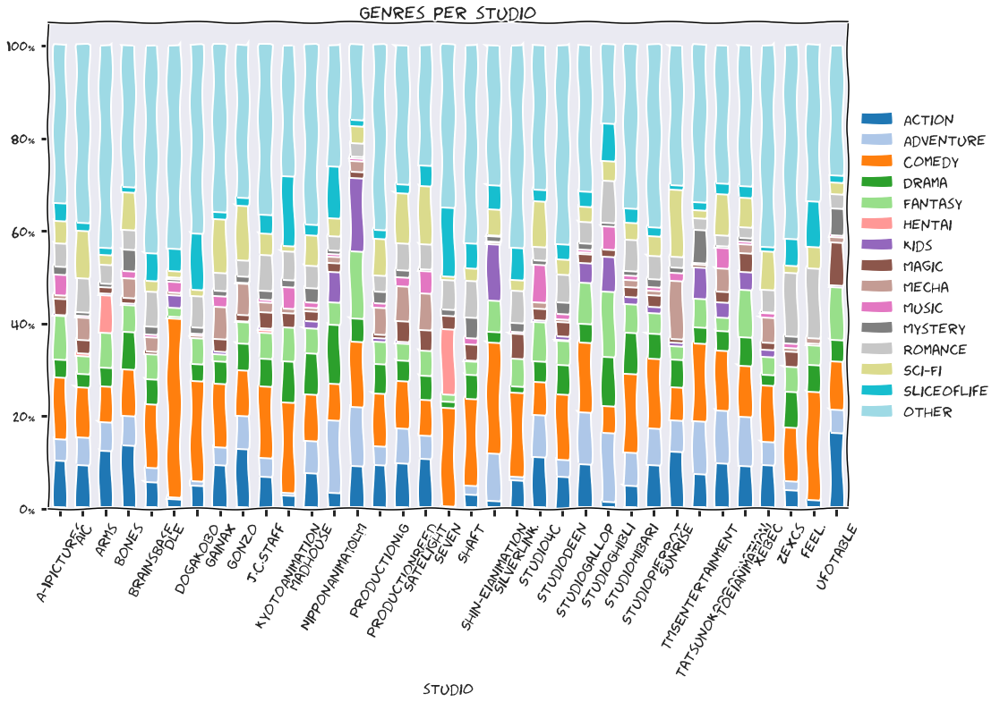

In [149]:
studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0).plot.bar(stacked=True, figsize=(16, 10), title='Genres per studio', color=colors)
plt.xticks(rotation=60)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

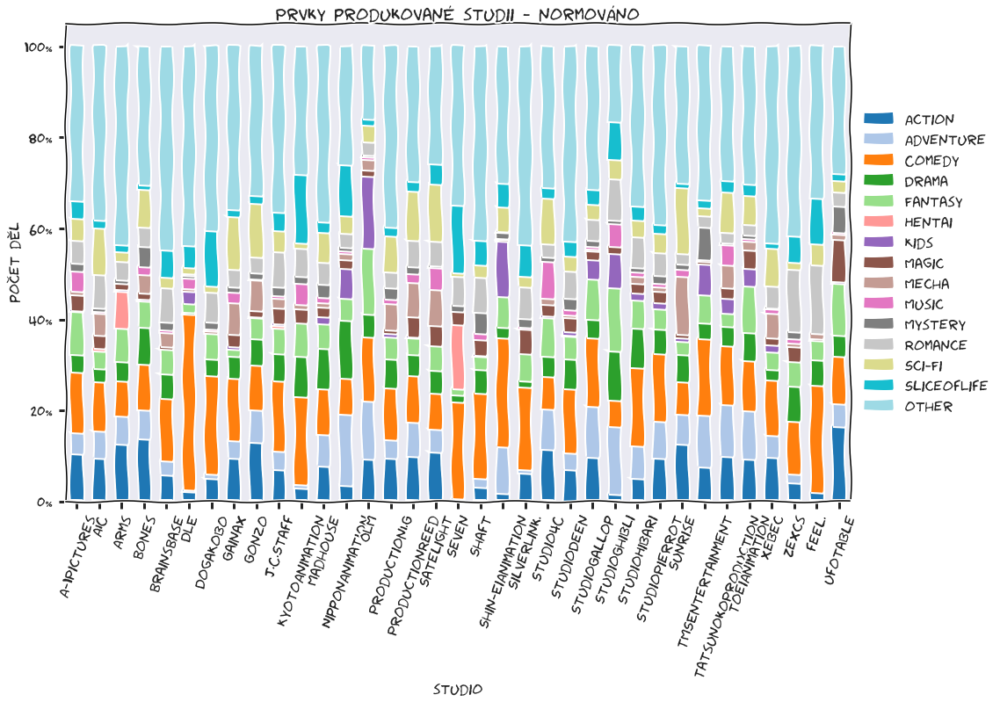

In [150]:
studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0).plot.bar(stacked=True, figsize=(16, 10), title='Prvky produkované studii - normováno', color=colors)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=70)
plt.ylabel('počet děl')
plt.xlabel('studio')
plt.savefig('graphs/produkce-studii-prvky-normovano.png', bbox_inches="tight")

In [151]:
studios_genres.sum(axis=0)

genre
Action         1456
Adventure      1045
Comedy         2116
Drama           971
Fantasy         990
Hentai           85
Kids            265
Magic           411
Mecha           463
Music           206
Mystery         351
Romance         816
Sci-Fi         1006
SliceofLife     589
other          5936
dtype: int64

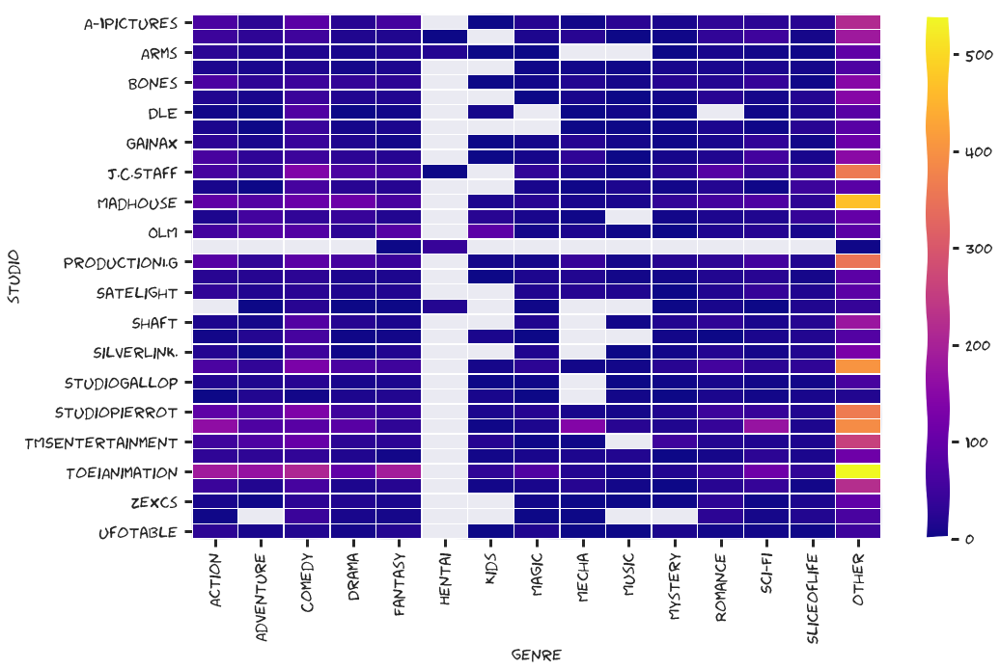

In [152]:
# showing pairwise heatmap from https://seaborn.pydata.org/examples/many_pairwise_correlations.html
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(16, 10))

mask = np.zeros_like(studios_genres, dtype=np.bool)
mask[studios_genres == 0] = True

sns.heatmap(studios_genres, mask=mask, linewidths=.5, cmap=plt.cm.plasma)

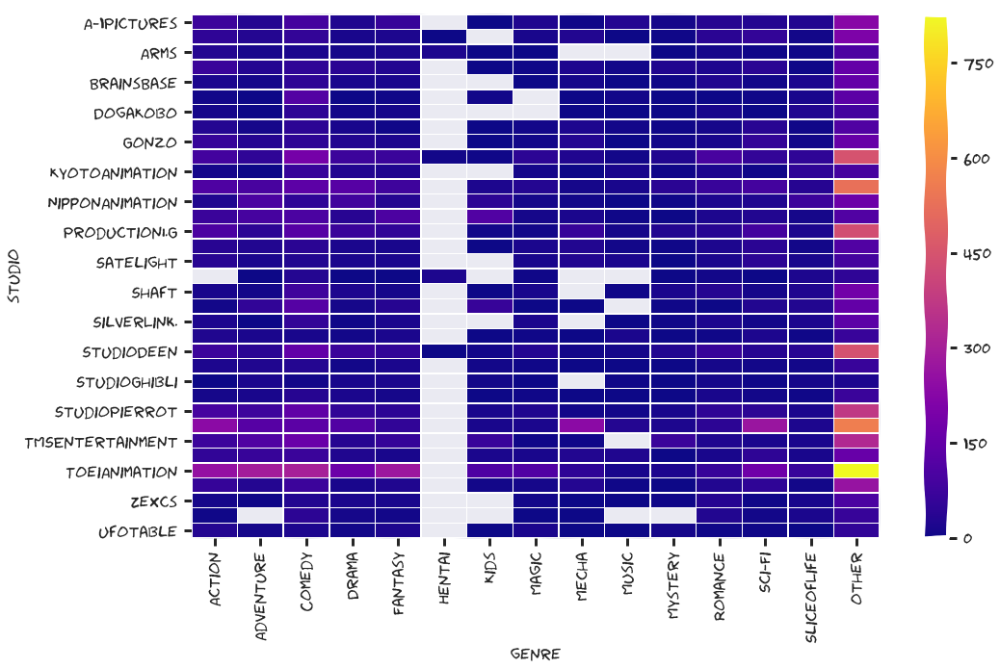

In [153]:
f, ax = plt.subplots(figsize=(16, 10))

mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True

sns.heatmap(studios_genres_all, mask=mask, linewidths=.5, cmap=plt.cm.plasma)

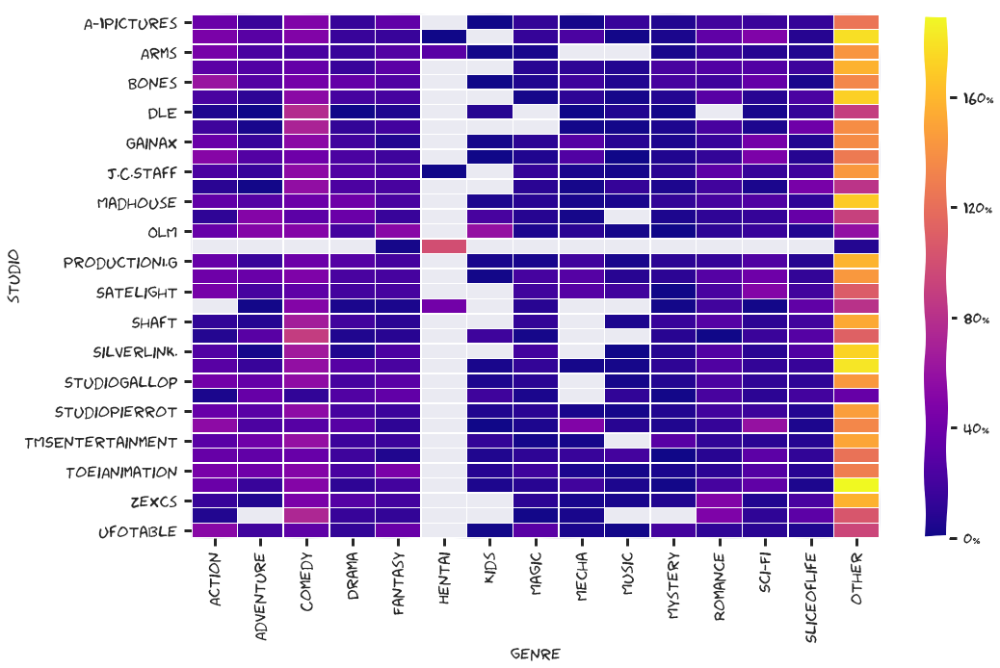

In [154]:
studios_total = animes_studios.groupby('studio')['title'].count().loc[studios_genres.index]

f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(studios_genres, dtype=np.bool)
mask[studios_genres == 0] = True
sns.heatmap(studios_genres.div(studios_total, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.plasma, cbar_kws={'format': '%.0f%%'})

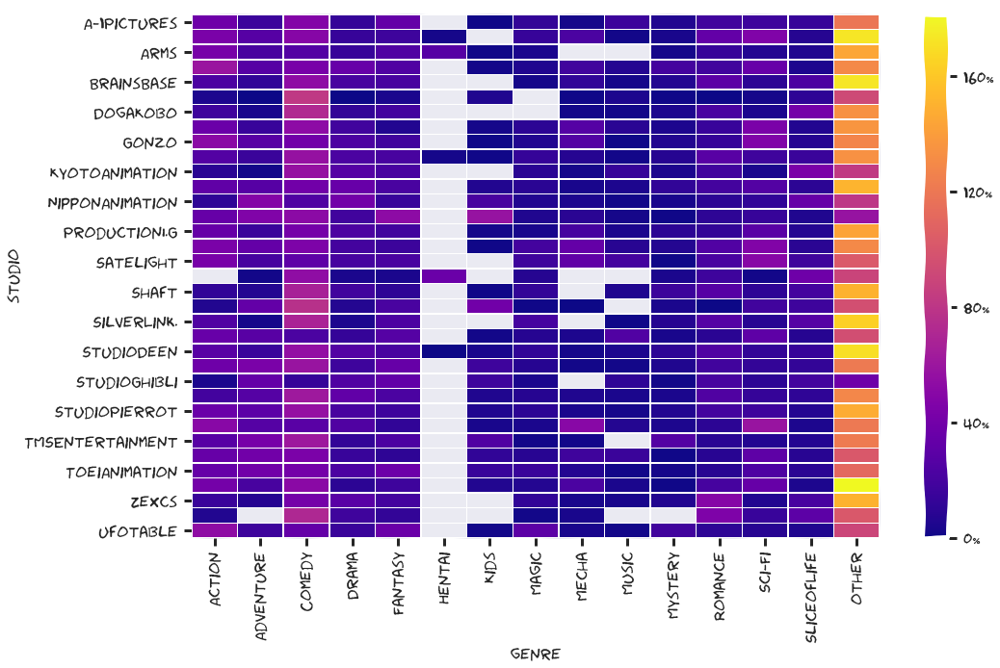

In [155]:
studios_total_all = animes_studios_all.groupby('studio')['title'].count().loc[studios_genres_all.index]

f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True
sns.heatmap(studios_genres_all.div(studios_total_all, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.plasma, cbar_kws={'format': '%.0f%%'})

In [156]:
# basically the same thing as above, but for more genres, since heatmap can handle it in this layout
studios_genres = pd.crosstab(animes_studios_genres['studio'], animes_studios_genres['genre'])
studios_genres = studios_genres[studios_genres.index.isin(known_studios)]
interesting_genres = ['Action', 'Adventure', 'Cars', 'Comedy', 'Dementia', 'Demons', 'Drama',
       'Ecchi', 'Fantasy', 'Game', 'Harem', 'Hentai', 'Historical', 'Horror',
       'Josei', 'Kids', 'Magic', 'MartialArts', 'Mecha', 'Military', 'Music',
       'Mystery', 'Parody', 'Police', 'Psychological', 'Romance', 'Samurai',
       'School', 'Sci-Fi', 'Seinen', 'Shoujo', 'ShoujoAi', 'Shounen',
       'ShounenAi', 'SliceofLife', 'Space', 'Sports', 'SuperPower',
       'Supernatural', 'Thriller', 'Vampire', 'Yaoi', 'Yuri']

other_genres = list(set(studios_genres.columns) - set(interesting_genres))
# no other genres, so I don't add this column
#studios_genres['other'] = studios_genres[other_genres].sum(axis=1)
studios_genres.drop(other_genres, inplace=True, axis=1)

In [157]:
studios_genres_all = pd.crosstab(animes_studios_genres_all['studio'], animes_studios_genres_all['genre'])
studios_genres_all = studios_genres_all[studios_genres_all.index.isin(known_studios_all)]

other_genres = list(set(studios_genres_all.columns) - set(interesting_genres))
# no other genres, so I don't add this column
#studios_genres['other'] = studios_genres[other_genres].sum(axis=1)
studios_genres_all.drop(other_genres, inplace=True, axis=1)

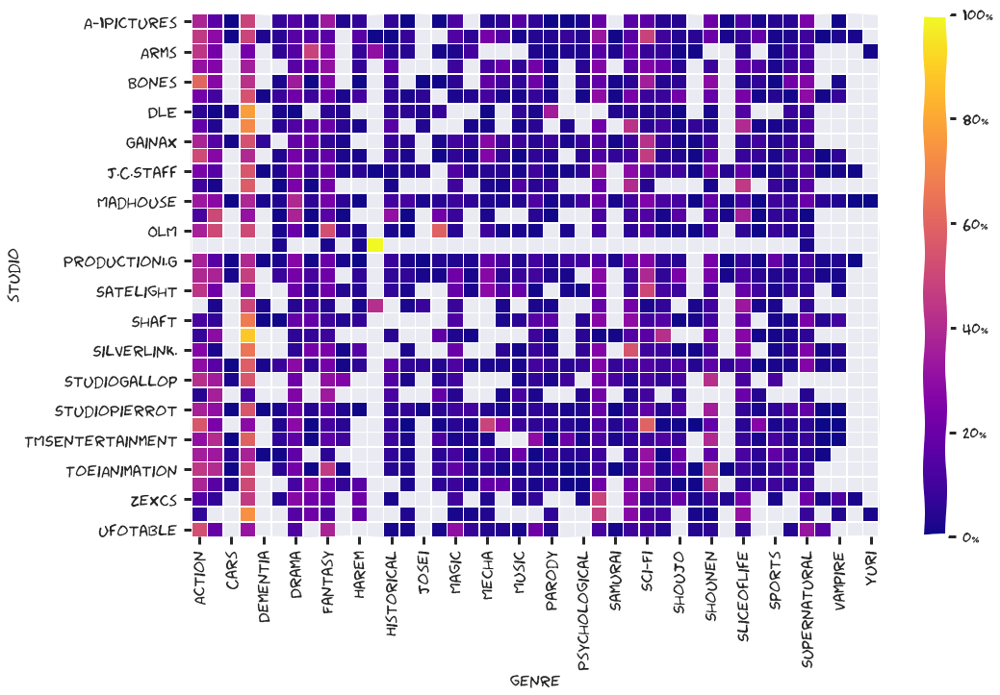

In [158]:
f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(studios_genres, dtype=np.bool)
mask[studios_genres == 0] = True
sns.heatmap(studios_genres.div(studios_total, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.plasma, cbar_kws={'format': '%.0f%%'})

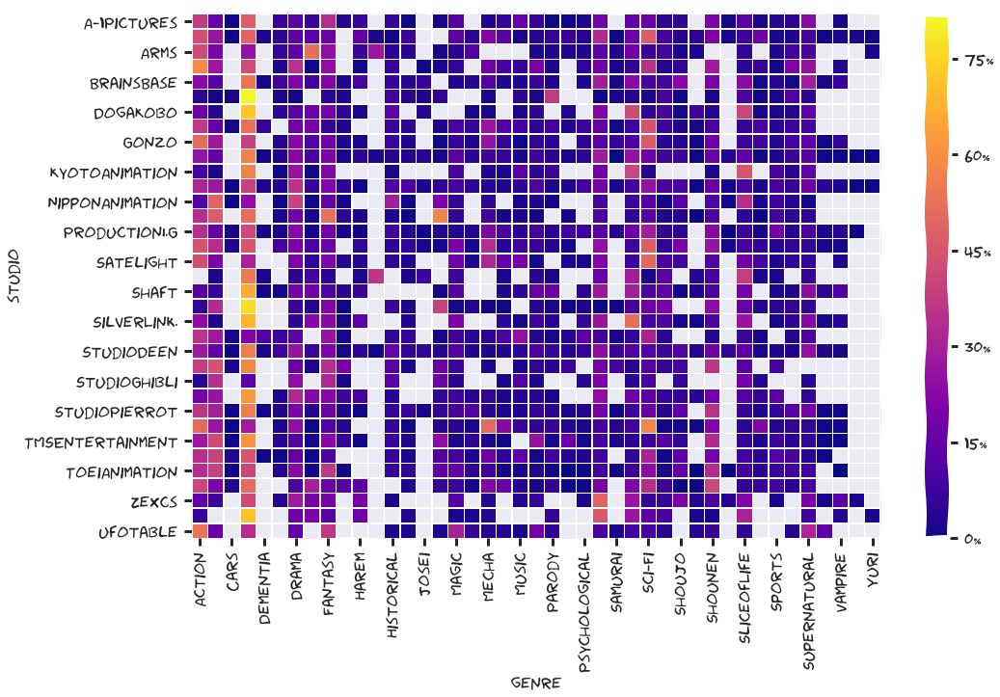

In [159]:
f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True
sns.heatmap(studios_genres_all.div(studios_total_all, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.plasma, cbar_kws={'format': '%.0f%%'})

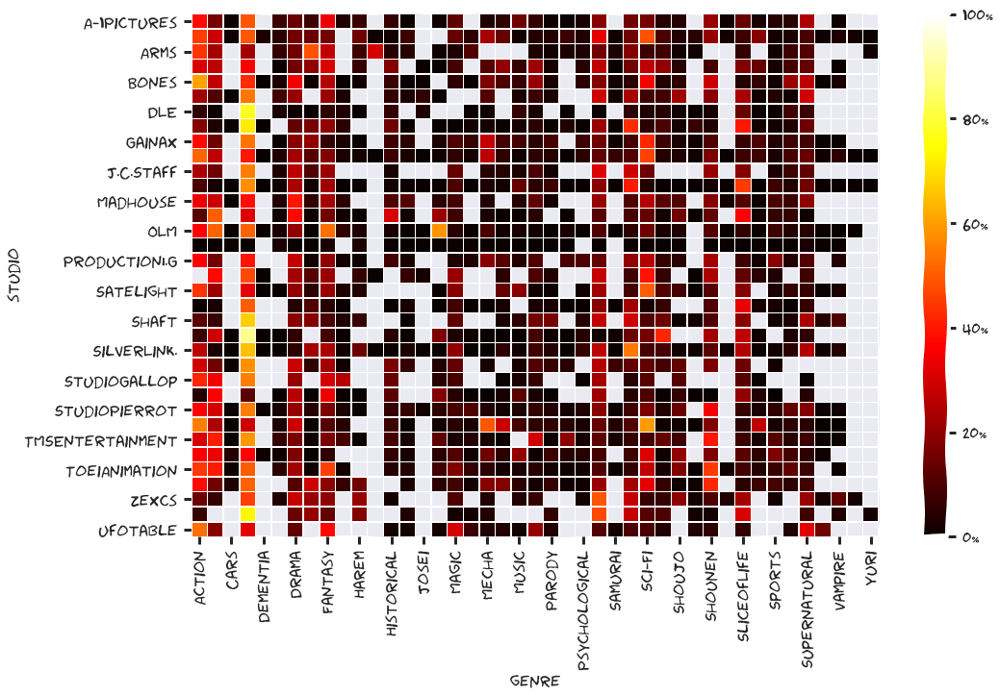

In [160]:
f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(studios_genres.div(studios_total, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})

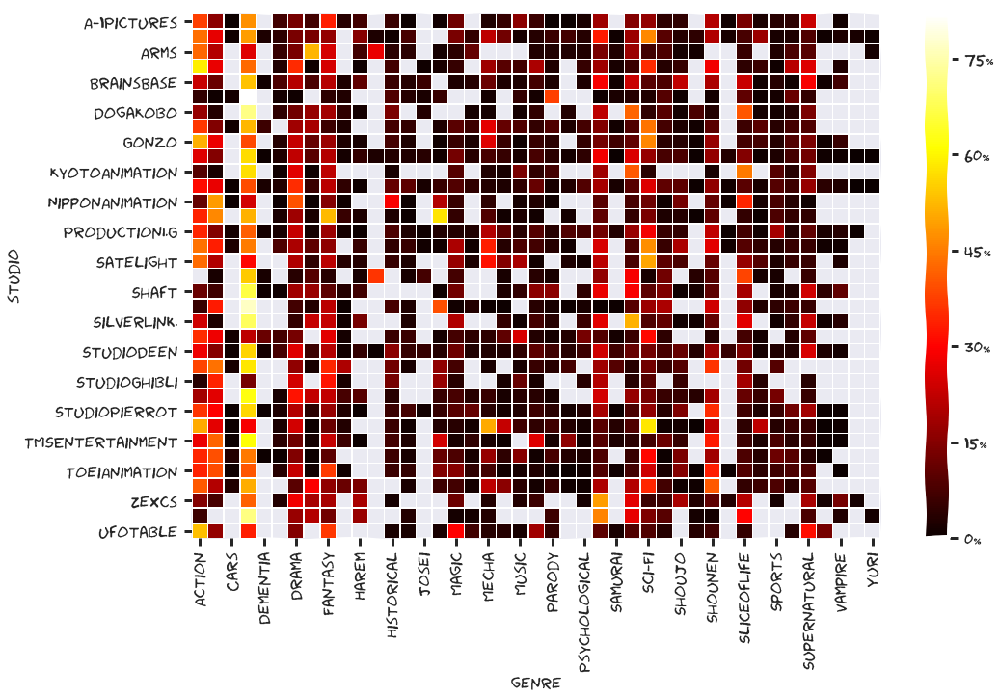

In [161]:
f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(studios_genres_all.div(studios_total_all, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})

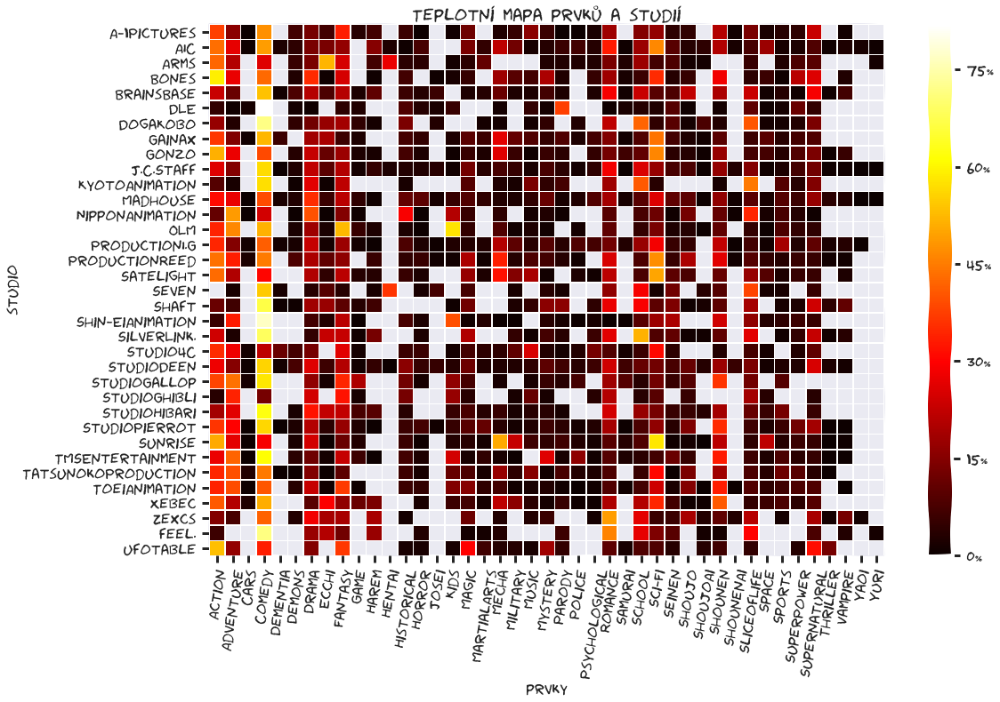

In [272]:
f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True
sns.heatmap(studios_genres_all.div(studios_total_all, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})
plt.title('Teplotní mapa prvků a studií')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/produkce-studii-prvky-heatmap.png', bbox_inches="tight")

In [163]:
# now try the histogram equalization on colormap to better show data
# histogram equalization taken from https://github.com/jobar8/graphics/blob/master/graphics.py and modified little bit
from skimage import exposure

def cmap_to_array(cmap,N=256):
    """
    Return a Nx3 array of RGB values generated from a colormap.
    """
    return cmap(np.linspace(0, 1, N))[:,:3] # remove alpha column

def equalize_colormap(cmap, data, name='EqualizedMap'):
    if type(data) is pd.DataFrame:
        data = data.as_matrix()
    data = data[~np.isnan(data)].flatten()
    cdf, bins = exposure.cumulative_distribution(data, nbins=256)
    # Using it for highly non-uniform data will cause high information loss for extreme values
    #So we do only half equalization, equalizing with histogram averaged with uniform histogram
    # and now the same for uniform distribution of same size
    cdf_u, bins_u = exposure.cumulative_distribution(np.linspace(data.min(), data.max(), data.shape[0]),nbins=256)
    cdf = (cdf + cdf_u) / 2
    '''
    Re-map a colormap according to a cumulative distribution. This is used to 
    perform histogram equalization of an image by changing the colormap 
    instead of the image. *This is not strickly speaking the equalization of the 
    colormap itself*.
    The cdf and bins should be calculated from an input image, as if carrying out
    the histogram equalization of that image. In effect, the cdf becomes integrated  
    to the colormap as a mapping function by redistributing the indices of the
    input colormap.
    
    Parameters
    ----------
    cmap : string or colormap object
        Input colormap to remap.
    bins : array
        Centers of bins.
    cdf : array
        Values of cumulative distribution function.
    '''
    
    # first retrieve the color table (lists of RGB values) behind the input colormap
    if cmap in mpl.cm.cmap_d: # matplotlib colormaps + plus the new ones (viridis, inferno, etc.)
        cmList = cmap_to_array(cm.cmap_d[cmap])
    else:
        try:
            # in case cmap is a colormap object
            cmList = cmap_to_array(cmap) 
        except:
            raise ValueError('Colormap {} has not been recognised'.format(cmap))
    
    # normalize the input bins to interval (0,1)
    bins_norm = (bins - bins.min())/np.float(bins.max() - bins.min())
    
    # calculate new indices by applying the cdf as a function on the old indices
    # which are initially regularly spaced. 
    old_indices = np.linspace(0,1,len(cmList))
    new_indices = np.interp(old_indices,cdf,bins_norm)
    
    # make sure indices start with 0 and end with 1
    new_indices[0] = 0.0
    new_indices[-1] = 1.0
    
    # remap the color table
    cdict = {'red': [], 'green': [], 'blue': []}
    for i,n in enumerate(new_indices):
        r1, g1, b1 = cmList[i]
        cdict['red'].append([n, r1, r1])
        cdict['green'].append([n, g1, g1])
        cdict['blue'].append([n, b1, b1])
        
    return mpl.colors.LinearSegmentedColormap(name, cdict)


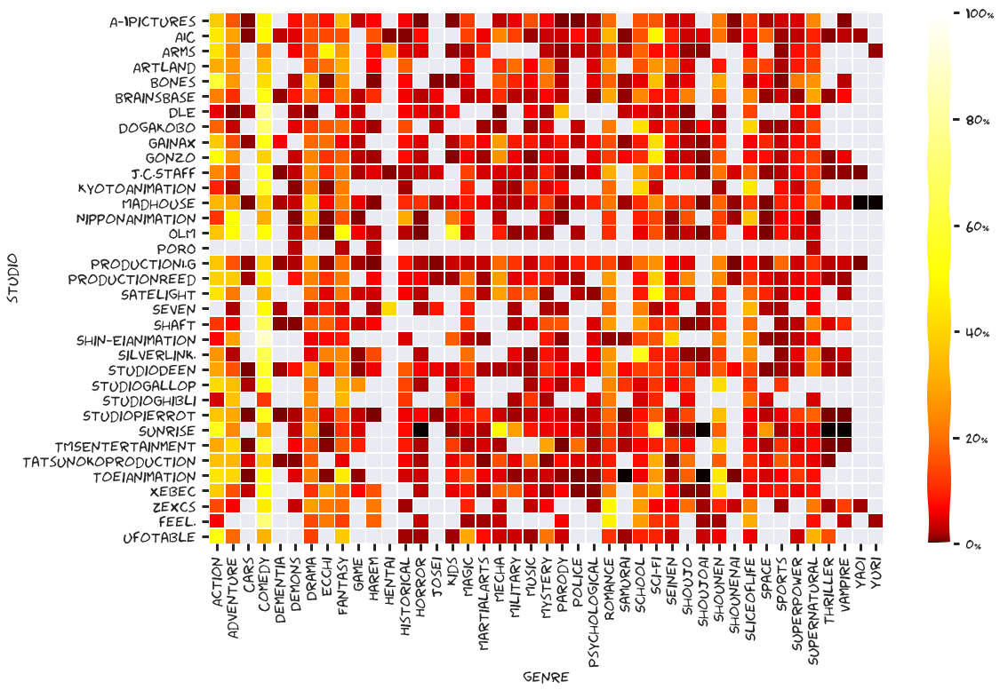

In [246]:
f, ax = plt.subplots(figsize=(17, 11))
data = studios_genres.div(studios_total, axis=0) * 100
cmap = equalize_colormap(plt.cm.hot, data)
mask = np.zeros_like(studios_genres, dtype=np.bool)
mask[studios_genres == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})

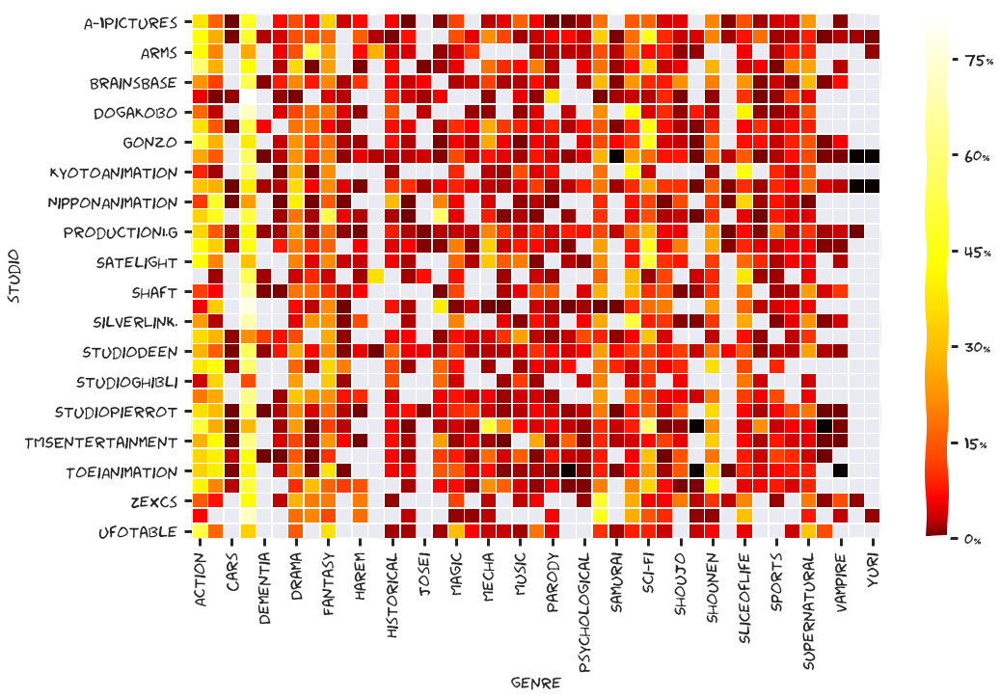

In [247]:
f, ax = plt.subplots(figsize=(16, 10))
data = studios_genres_all.div(studios_total_all, axis=0) * 100
cmap = equalize_colormap(plt.cm.hot, data)
mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})

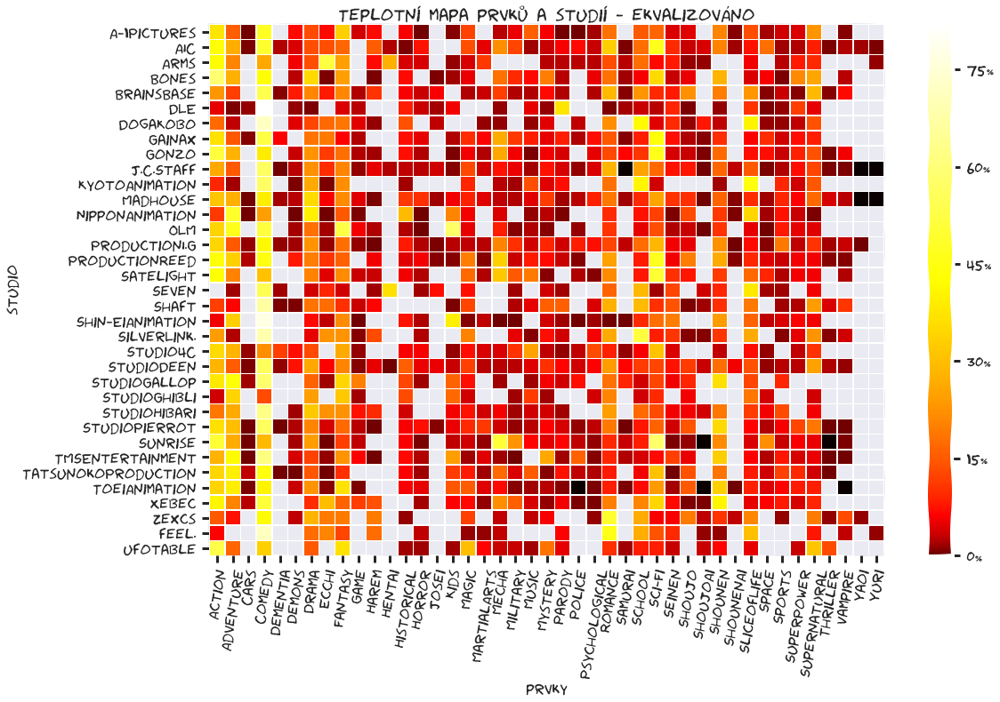

In [249]:
f, ax = plt.subplots(figsize=(17, 11))
data = studios_genres_all.div(studios_total_all, axis=0) * 100
cmap = equalize_colormap(plt.cm.hot, data)
mask = np.zeros_like(studios_genres_all, dtype=np.bool)
mask[studios_genres_all == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})
plt.title('Teplotní mapa prvků a studií - ekvalizováno')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/produkce-studii-prvky-heatmap-equalized.png', bbox_inches="tight")

### calculating embeddings to show topology of studio space

In [167]:
def dists_to_csv(nodes_name, edges_name, nodes_labels, dists):
    pairs = np.array(list(combinations(nodes_labels, 2)))
    
    nodes = pd.DataFrame({'id': nodes_labels, 'label': nodes_labels})
    edges = pd.DataFrame({'source': pairs[:, 0], 'target': pairs[:, 1], 'weight': dists})
    edges['type'] = 'undirected'
    
    nodes.to_csv(nodes_name, index=False, sep=',', encoding='utf-8')
    edges.to_csv(edges_name, index=False, sep=',', encoding='utf-8')

def dists_to_df(dists, names):
    dists_m = squareform(dists)
    dists_m[dists_m == np.inf] = 0  # infinities mess color scale

    dists_df = pd.DataFrame(dists_m)
    dists_df.columns = names
    dists_df.index = names
    return dists_df


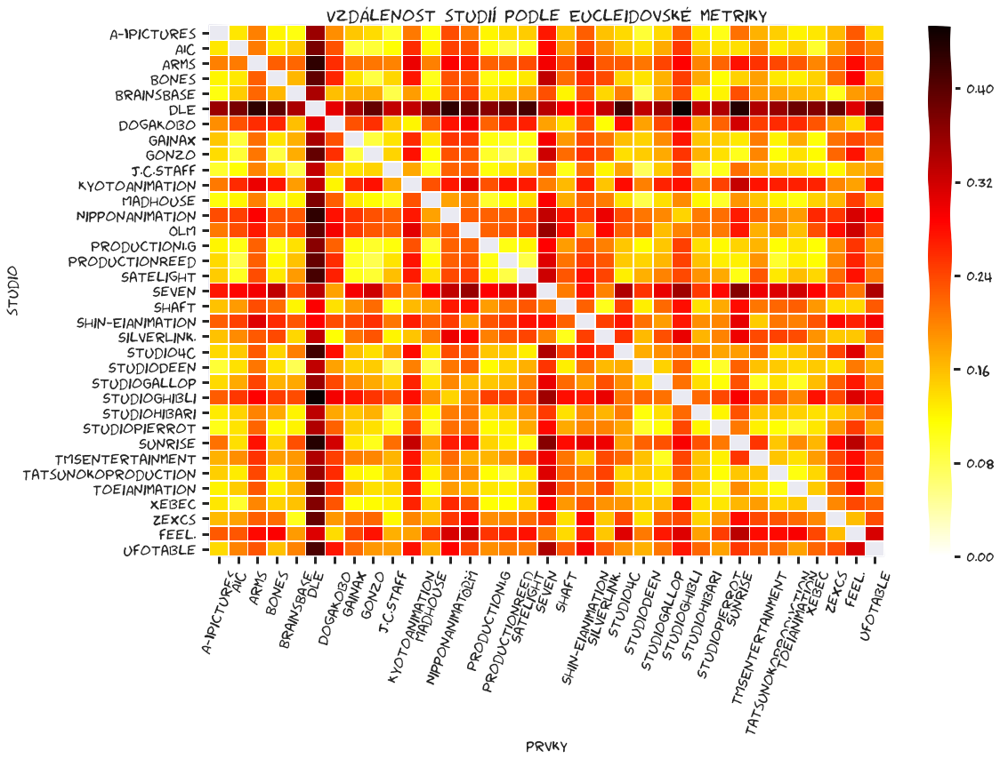

In [273]:
dists = pdist(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0), 'euclidean')
dists_to_csv('studios_nodes.csv', 'studios_edges_eucledian.csv', studios_genres_all.index, dists)
dists_df = dists_to_df(dists, studios_genres_all.index)

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.title('Vzdálenost studií podle Eucleidovské metriky')
plt.xticks(rotation=70)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/studia-vzdalenost-euclidean.png', bbox_inches="tight")

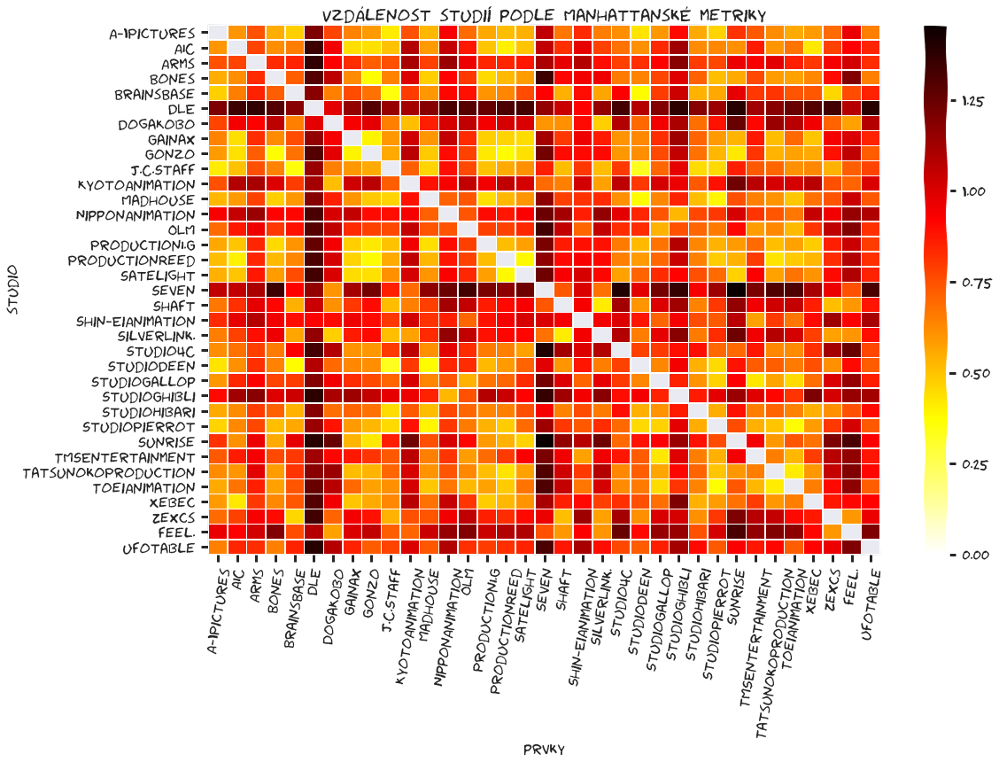

In [275]:
dists = pdist(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0), 'cityblock')
dists_to_csv('studios_nodes.csv', 'studios_edges_cityblock.csv', studios_genres_all.index, dists)
dists_df = dists_to_df(dists, studios_genres_all.index)

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.title('Vzdálenost studií podle Manhattanské metriky')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/studia-vzdalenost-manhattan.png', bbox_inches="tight")

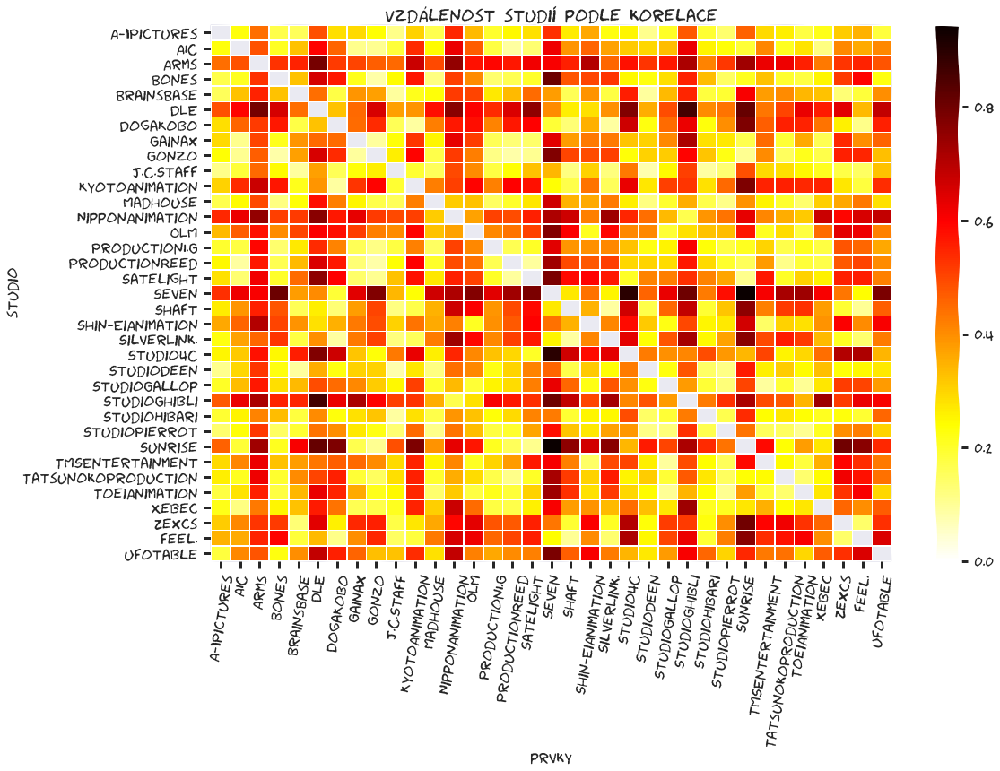

In [296]:
dists = pdist(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0), 'correlation')
dists_to_csv('studios_nodes.csv', 'studios_edges_correlation.csv', studios_genres_all.index, dists)
dists_df = dists_to_df(dists, studios_genres_all.index)

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.title('Vzdálenost studií podle korelace')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/studia-vzdalenost-corr.png', bbox_inches="tight")

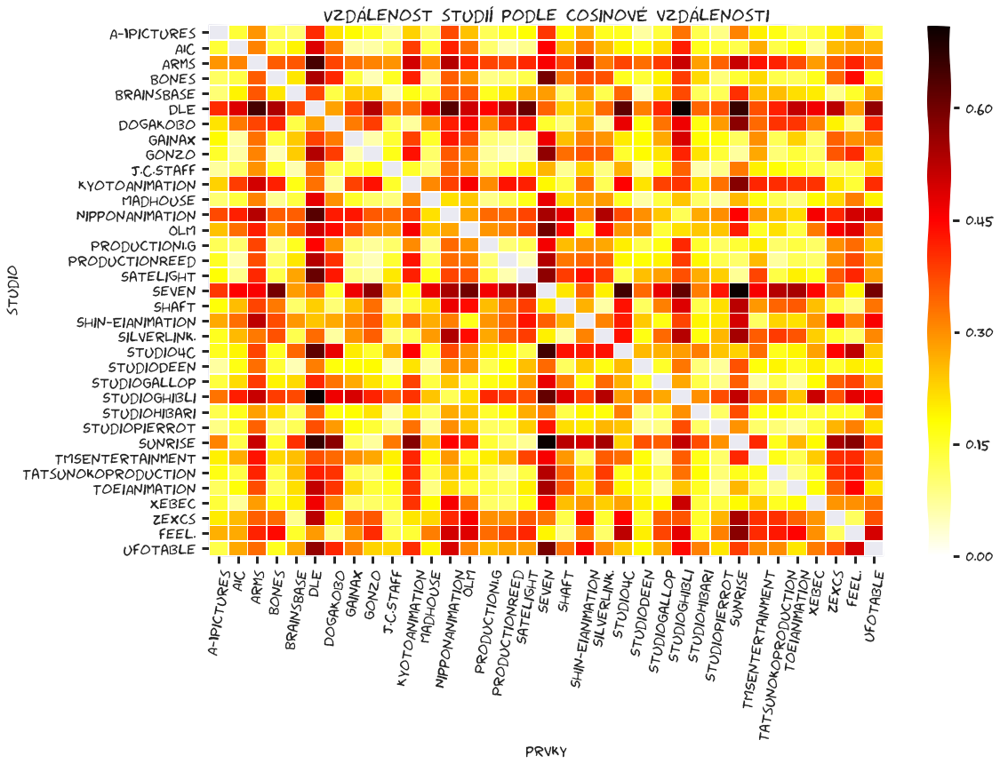

In [278]:
dists = pdist(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0), 'cosine')
dists_to_csv('studios_nodes.csv', 'studios_edges_cosine.csv', studios_genres_all.index, dists)
dists_df = dists_to_df(dists, studios_genres_all.index)

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.title('Vzdálenost studií podle cosinové vzdálenosti')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/studia-vzdalenost-cosine.png', bbox_inches="tight")

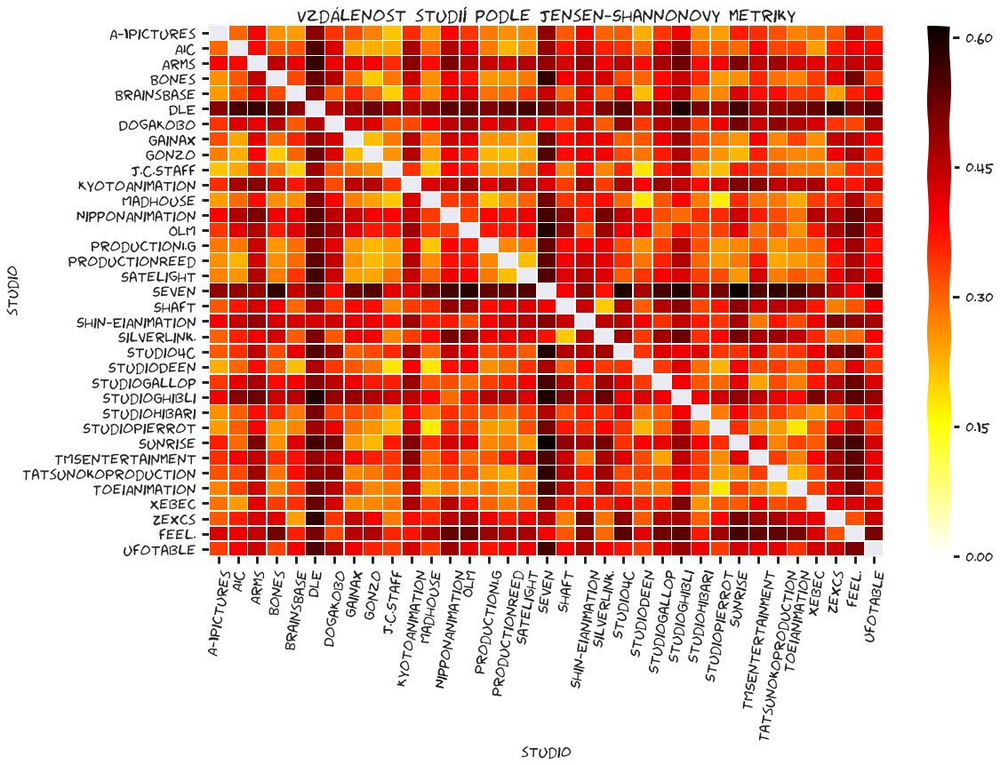

In [281]:
# using Jensen Shannon diverge, which is symeterized version of KL divergence
def js(p, q):
    p /= p.sum()
    q /= q.sum()
    m = (p + q) / 2
    return (entropy(p, m) + entropy(q, m)) / 2

def js_metric(p, q):
    # with square root it will satisfy triangle inequality
    return np.sqrt(js(p, q))

dists = pdist(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0), lambda x, y: js_metric(x, y))
dists_to_csv('studios_nodes.csv', 'studios_edges_js.csv', studios_genres_all.index, 1 / dists)  # gephi takes edge weight as similarity
dists_df = dists_to_df(dists, studios_genres_all.index)

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.title('Vzdálenost studií podle Jensen-Shannonovy metriky')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('studio')
plt.savefig('graphs/studia-vzdalenost-js.png', bbox_inches="tight")

Between Pierrot and Toei
cosine dist: 0.06819352948983148
euclidean dist: 0.06819352948983148
cityblock dist: 0.3714449152607356
correlation dist: 0.10464326007578906
js dist: 0.17752828850250715
Between Toei with hentai and Toei
cosine dist: 0.20659512572655414
euclidean dist: 0.20659512572655414
cityblock dist: 0.3333333333333333
correlation dist: 0.30583167919533605
js dist: 0.248103564309359


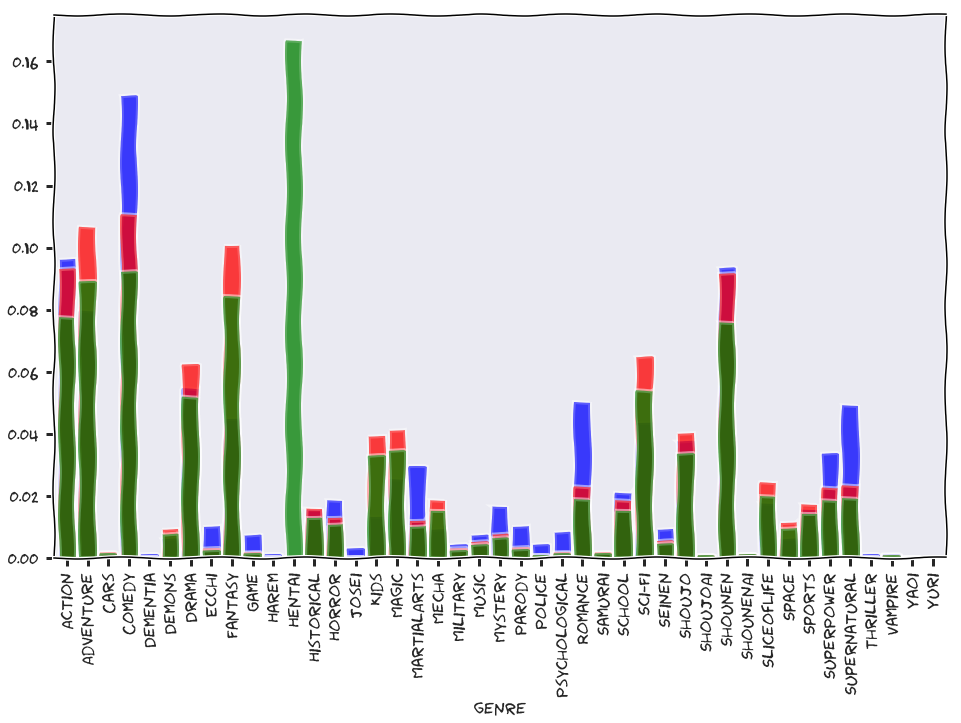

In [173]:
studios_genres_all_normed = studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0)
#display(studios_genres.loc['ToeiAnimation'])
#display(studios_genres.loc['StudioPierrot'])
#display(studios_genres_all.loc['ToeiAnimation'] - studios_genres_all.loc['StudioPierrot'])
#studios_genres_all.loc[['ToeiAnimation', 'StudioPierrot']].plot(kind='bar', stacked=False, figsize=(16, 10), width=0.8)
plt.figure(figsize=(16, 10))
ax = plt.gca()
studios_genres_all_normed.loc['StudioPierrot'].plot(kind='bar', stacked=False, ax=ax, width=0.8, color='blue', alpha=0.5)
studios_genres_all_normed.loc['ToeiAnimation'].plot(kind='bar', stacked=False, ax=ax, width=0.8, color='red', alpha=0.5)
# atificial, like Toei but with hentai
toei_hentai = studios_genres_all_normed.loc['ToeiAnimation'].copy()
toei_hentai['Hentai'] += 0.2
toei_hentai /= toei_hentai.sum()
toei_hentai.plot(kind='bar', stacked=False, ax=ax, width=0.8, color='green', alpha=0.5)
#studios_genres_all_normed.loc['Seven'].plot(kind='bar', stacked=False, ax=ax, width=0.8, color='green', alpha=0.5)
print('Between Pierrot and Toei')
print('cosine dist:', distance.cosine(studios_genres_all_normed.loc['StudioPierrot'], studios_genres_all_normed.loc['ToeiAnimation']))
print('euclidean dist:', distance.cosine(studios_genres_all_normed.loc['StudioPierrot'], studios_genres_all_normed.loc['ToeiAnimation']))
print('cityblock dist:', distance.cityblock(studios_genres_all_normed.loc['StudioPierrot'], studios_genres_all_normed.loc['ToeiAnimation']))
print('correlation dist:', distance.correlation(studios_genres_all_normed.loc['StudioPierrot'], studios_genres_all_normed.loc['ToeiAnimation']))
print('js dist:', js_metric(studios_genres_all_normed.loc['StudioPierrot'], studios_genres_all_normed.loc['ToeiAnimation']))
print('Between Toei with hentai and Toei')
print('cosine dist:', distance.cosine(toei_hentai, studios_genres_all_normed.loc['ToeiAnimation']))
print('euclidean dist:', distance.cosine(toei_hentai, studios_genres_all_normed.loc['ToeiAnimation']))
print('cityblock dist:', distance.cityblock(toei_hentai, studios_genres_all_normed.loc['ToeiAnimation']))
print('correlation dist:', distance.correlation(toei_hentai, studios_genres_all_normed.loc['ToeiAnimation']))
print('js dist:', js_metric(toei_hentai, studios_genres_all_normed.loc['ToeiAnimation']))


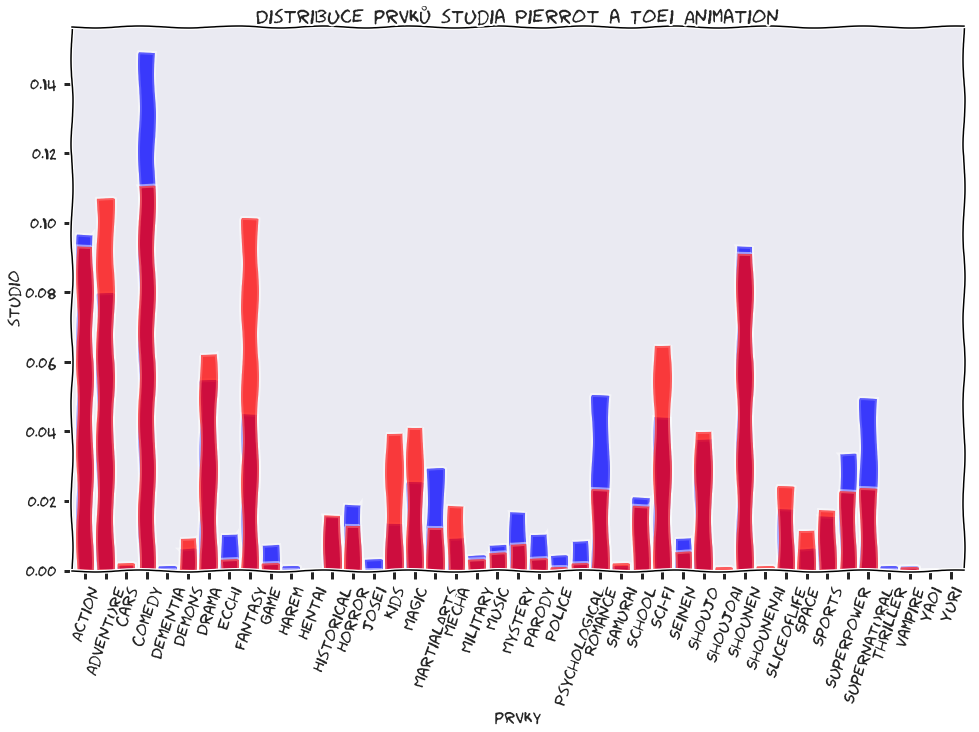

In [174]:
plt.figure(figsize=(16, 10))
ax = plt.gca()
studios_genres_all_normed.loc['StudioPierrot'].plot(kind='bar', stacked=False, ax=ax, width=0.8, color='blue', alpha=0.5)
studios_genres_all_normed.loc['ToeiAnimation'].plot(kind='bar', stacked=False, ax=ax, width=0.8, color='red', alpha=0.5)
plt.title('Distribuce prvků studia Pierrot a Toei Animation')
plt.xticks(rotation=70)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/toei-peirot-histogram.png', bbox_inches="tight")

### examining different metrics how they are affected by steadily increasing some genre production

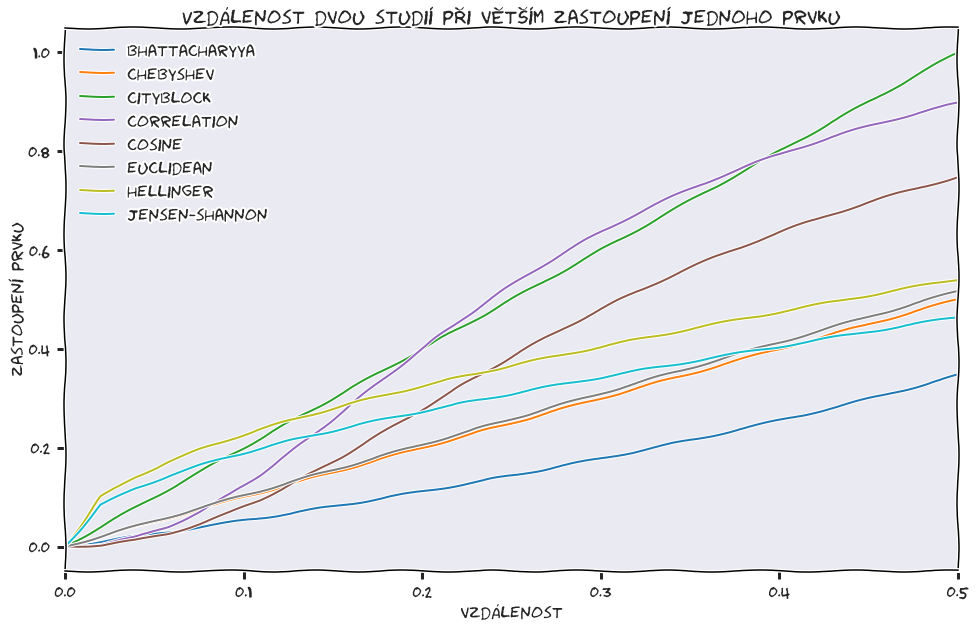

In [175]:
hentai_ratios = np.linspace(0, 1, 50)
# array of productions with different hentai ratios
toei_hentais = np.tile(np.array(studios_genres_all_normed.loc['ToeiAnimation']), (len(hentai_ratios), 1))
# hentai column
hentai_column = studios_genres_all_normed.columns.get_loc('Hentai')
toei_hentais[:, hentai_column] += hentai_ratios
toei_hentais /= toei_hentais.sum(axis=1)[:, None]

# implementations from https://gist.github.com/miku/1671b2014b003ee7b9054c0618c805f7 and https://gist.github.com/larsmans/3116927

dists = ['chebyshev', lambda x, y: np.sqrt(np.sum((np.sqrt(x) - np.sqrt(y)) ** 2)) / np.sqrt(2), lambda x, y: -np.log(sum((np.sqrt(u * w) for u, w in zip(x, y)))), 'euclidean', 'correlation', 'cosine', 'cityblock', lambda x, y: js_metric(x, y)]
dist_arrs = {'chebyshev': None, 'hellinger': None, 'bhattacharyya': None, 'euclidean': None, 'correlation': None, 'cosine': None, 'cityblock': None, 'jensen-shannon': None}
for dist_func, key in zip(dists, dist_arrs.keys()):
    dist_arrs[key] = distance.cdist(np.array([studios_genres_all_normed.loc['ToeiAnimation']]), toei_hentais, metric=dist_func)[0]
    

# for 1 genre change (and after normalization), braycurtis is same as chebyshev, and minkowski is same as euclidean
# thus I won't calculate them
# canberra has too fast growth, but otherwise same curve as euclidean and stuff, useless now
distances_df = pd.DataFrame(dist_arrs, index=toei_hentais[:, hentai_column])
distances_df.plot(figsize=(16, 10), title='Vzdálenost dvou studií při větším zastoupení jednoho prvku', colormap=plt.cm.tab10)
plt.ylabel('zastoupení prvku')
plt.xlabel('vzdálenost')
plt.savefig('graphs/studia-ukazka-metrik-big.png', bbox_inches="tight")

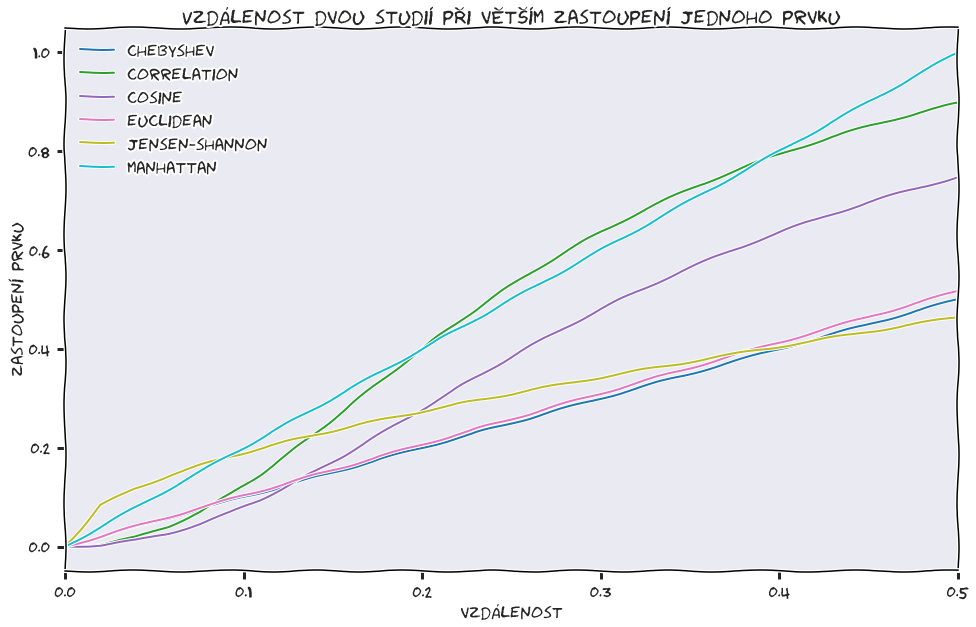

In [176]:
dists_small = ['chebyshev', 'euclidean', 'correlation', 'cosine', 'cityblock', lambda x, y: js_metric(x, y)]
dist_arrs_small = {'chebyshev': None, 'euclidean': None, 'correlation': None, 'cosine': None, 'manhattan': None, 'jensen-shannon': None}
for dist_func, key in zip(dists_small, dist_arrs_small.keys()):
    dist_arrs_small[key] = distance.cdist(np.array([studios_genres_all_normed.loc['ToeiAnimation']]), toei_hentais, metric=dist_func)[0]
    

# for 1 genre change (and after normalization), braycurtis is same as chebyshev, and minkowski is same as euclidean
# thus I won't calculate them
# canberra has too fast growth, but otherwise same curve as euclidean and stuff, useless now
distances_df = pd.DataFrame(dist_arrs_small, index=toei_hentais[:, hentai_column])
distances_df.plot(figsize=(16, 10), title='Vzdálenost dvou studií při větším zastoupení jednoho prvku', colormap=plt.cm.tab10)
plt.ylabel('zastoupení prvku')
plt.xlabel('vzdálenost')
plt.savefig('graphs/studia-ukazka-metrik.png', bbox_inches="tight")

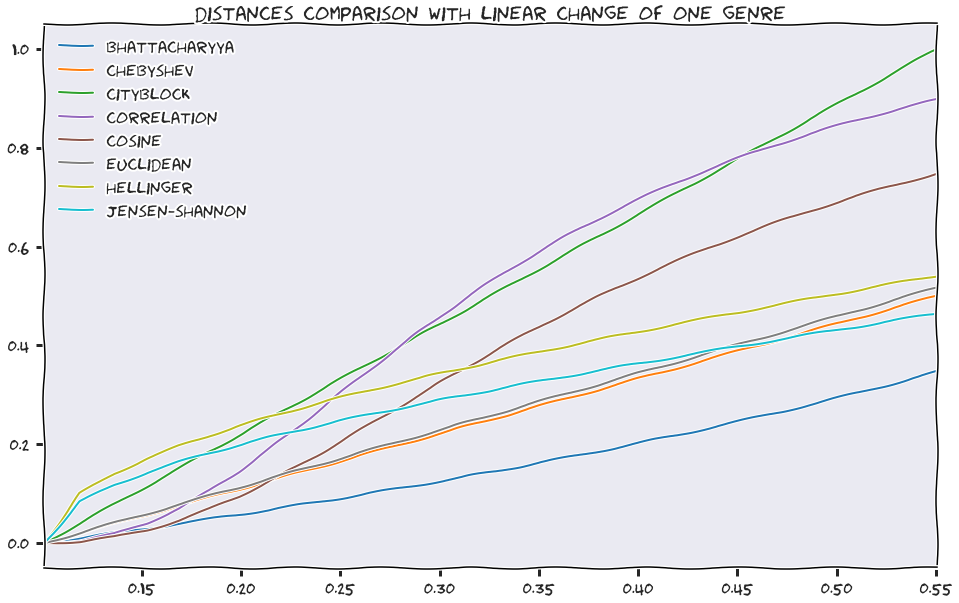

In [177]:
# now, the same for fantasy, to see if there is difference between starting on 0% production and 10% of production
fantasy_ratios = np.linspace(0, 1, 50)
toei_fantasies = np.tile(np.array(studios_genres_all_normed.loc['ToeiAnimation']), (len(hentai_ratios), 1))
fantasy_column = studios_genres_all_normed.columns.get_loc('Fantasy')
toei_fantasies[:, fantasy_column] += fantasy_ratios
toei_fantasies /= toei_fantasies.sum(axis=1)[:, None]

for dist_func, key in zip(dists, dist_arrs.keys()):
    dist_arrs[key] = distance.cdist(np.array([studios_genres_all_normed.loc['ToeiAnimation']]), toei_hentais, metric=dist_func)[0]
    
distances_df = pd.DataFrame(dist_arrs, index=toei_fantasies[:, fantasy_column])
distances_df.plot(figsize=(16, 10), title='distances comparison with linear change of one genre', colormap=plt.cm.tab10)

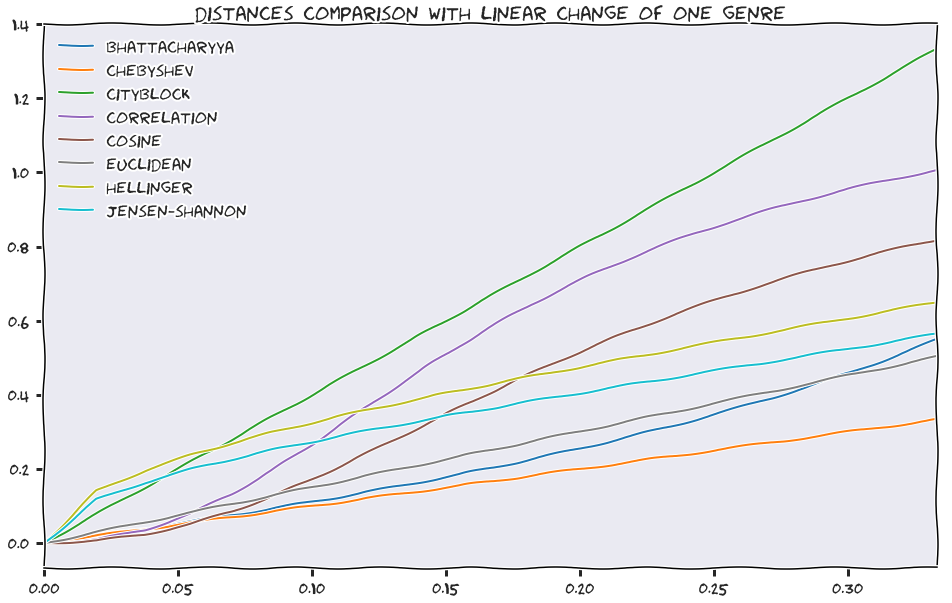

In [178]:
# changing two genres at once, yaoi and yuri
ratios = np.linspace(0, 1, 50)
toei_ys = np.tile(np.array(studios_genres_all_normed.loc['ToeiAnimation']), (len(ratios), 1))
yaoi_column = studios_genres_all_normed.columns.get_loc('Yaoi')
yuri_column = studios_genres_all_normed.columns.get_loc('Yuri')
toei_ys[:, yaoi_column] += ratios
toei_ys[:, yuri_column] += ratios
toei_ys /= toei_ys.sum(axis=1)[:, None]

for dist_func, key in zip(dists, dist_arrs.keys()):
    dist_arrs[key] = distance.cdist(np.array([studios_genres_all_normed.loc['ToeiAnimation']]), toei_ys, metric=dist_func)[0]
    
distances_df = pd.DataFrame(dist_arrs, index=toei_ys[:, yuri_column])
distances_df.plot(figsize=(16, 10), title='distances comparison with linear change of one genre', colormap=plt.cm.tab10)

In [179]:
# just showing small part of data for presentation
studios_genres_all.iloc[0:5, 0:5]

genre,Action,Adventure,Cars,Comedy,Dementia
studio,,,,,
A-1Pictures,71,30,1,90,0
AIC,51,32,1,58,3
Arms,31,15,0,19,0
Bones,69,32,0,50,0
BrainsBase,20,10,0,46,1


6

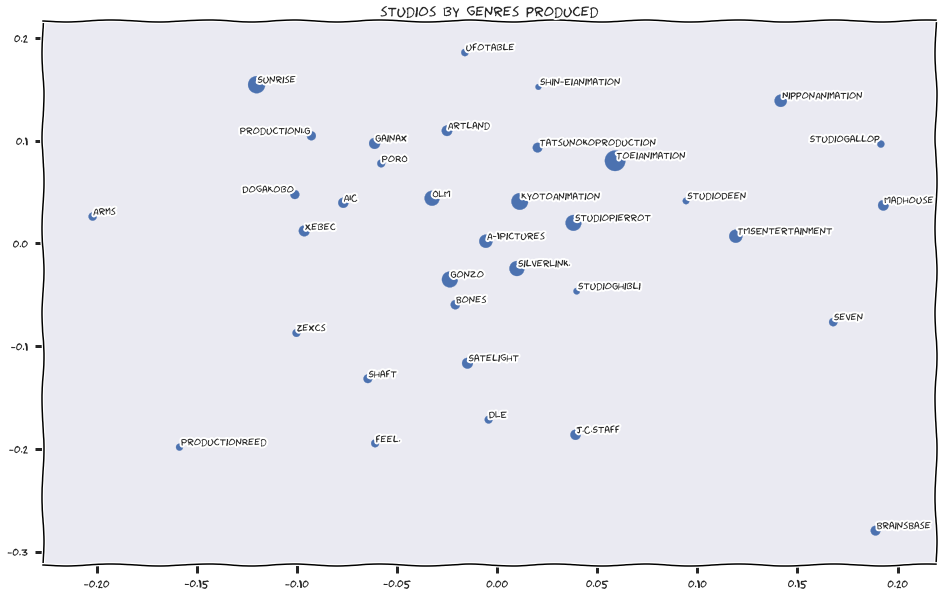

In [180]:
%matplotlib inline

# using manifold embedding to represent studios in 2D: http://scikit-learn.org/stable/auto_examples/manifold/plot_compare_methods.html
# using https://github.com/Phlya/adjustText to adjust text labels so they don't overlap
embedder = manifold.MDS(2, max_iter=1000, n_init=5)
embeddings = embedder.fit_transform(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0))
# need to agregate animes_studios because it does not contain duplicities because of genres
studio_sizes = animes_studios[animes_studios['studio'].isin(known_studios_all)]['studio'].value_counts().sort_index()
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1], s=studio_sizes)
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(studios_genres.index)]
adjust_text(texts)


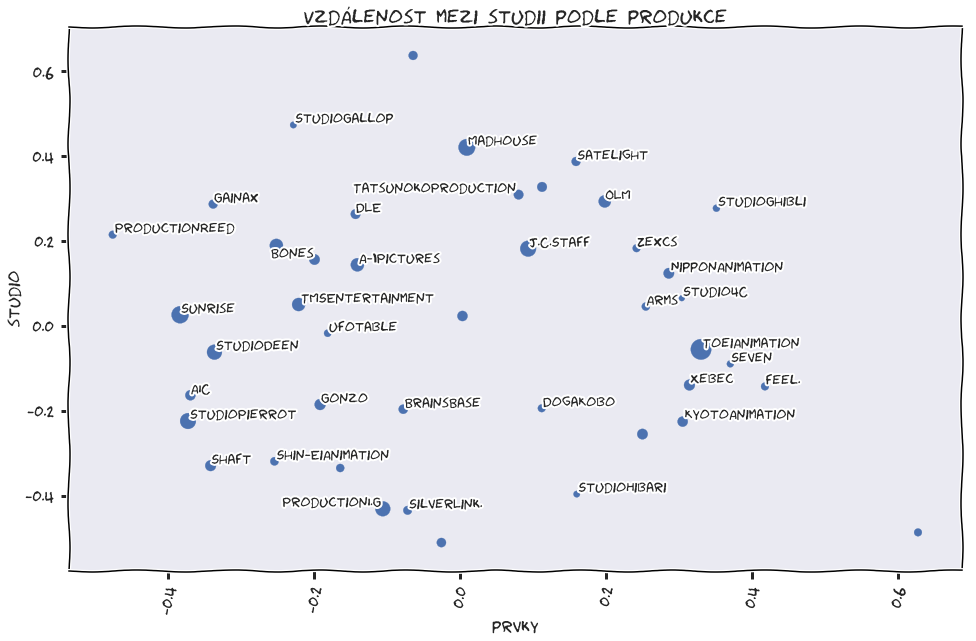

In [282]:
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1], s=studio_sizes)
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(studios_genres_all.index)]
adjust_text(texts)
plt.title('Vzdálenost mezi studii podle produkce')
plt.xticks(rotation=80)
plt.ylabel('studio')
plt.xlabel('prvky')
plt.savefig('graphs/produkce-studii-prvky-embedding.png', bbox_inches="tight")

<IPython.core.display.Javascript object>


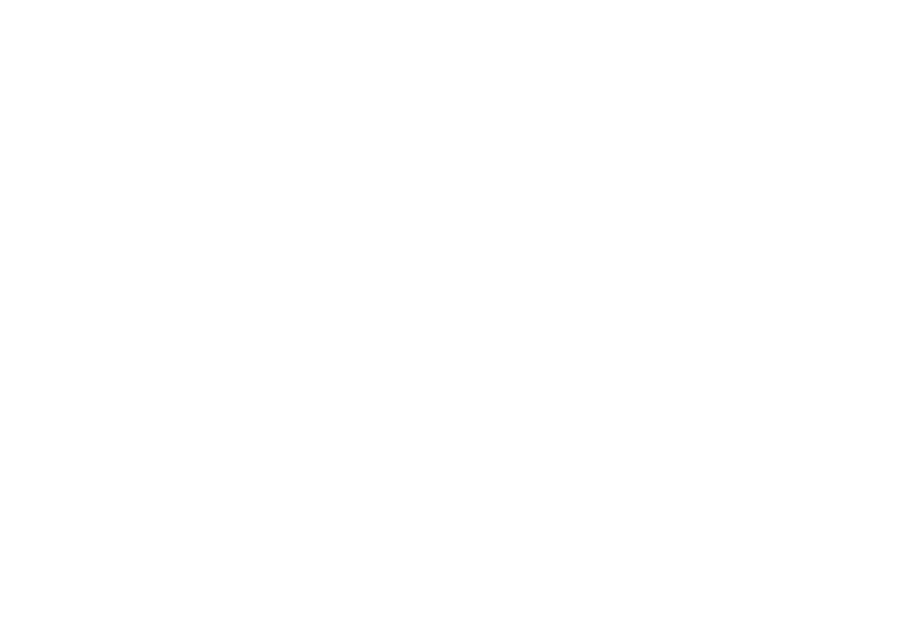

<IPython.core.display.Javascript object>


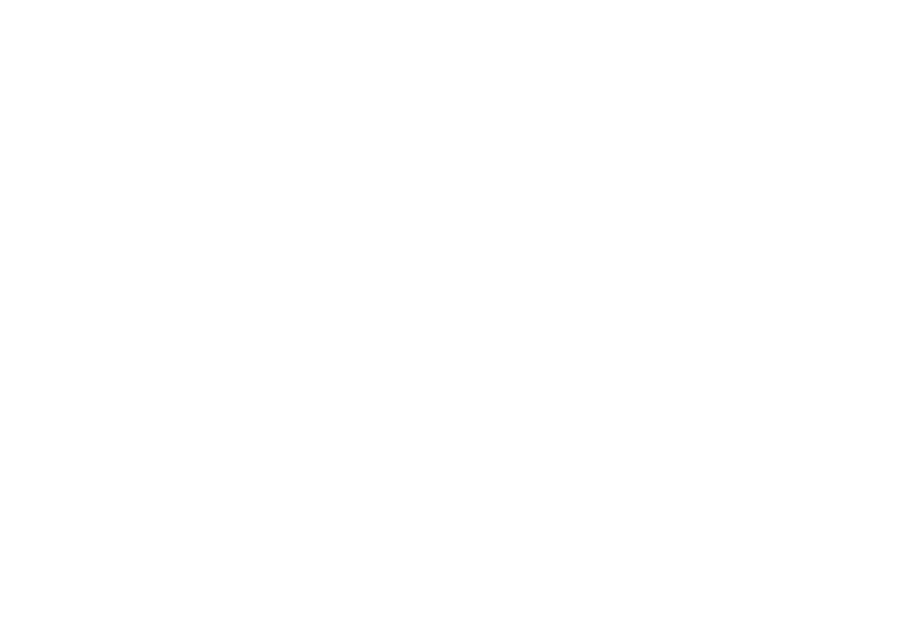

In [283]:
%matplotlib notebook

embedder = manifold.MDS(3, max_iter=1000, n_init=10)
embeddings = embedder.fit_transform(studios_genres_all.div(studios_genres_all.sum(axis=1), axis=0))
plt.figure(figsize=(10, 7))

ax = plt.axes(projection='3d')
ax.scatter3D(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2], s=studio_sizes)
plt.title("studios by genres produced in 3D")
for i, txt in enumerate(studios_genres.index):
    ax.text(embeddings[i, 0], embeddings[i, 1], embeddings[i, 2], txt)

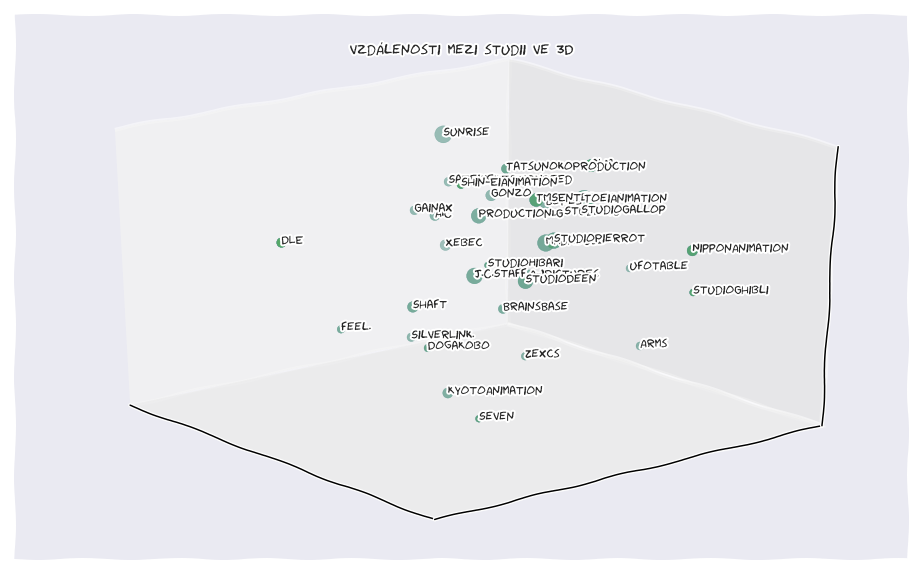

In [285]:
%matplotlib inline

def init(sizes):
    def my_init():
        ax.scatter3D(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2], s=sizes)
        return fig,
    return my_init

def animate(i):
    ax.azim = ax.azim - 2
    ax.view_init(ax.elev, ax.azim)
    return fig,

def points_3d_to_gif(embeddings, labels, gif_filename, ax, sizes):
    for i, txt in enumerate(labels):
        #ax.text(embeddings[i, 0], embeddings[i, 1], embeddings[i, 2], txt)
        ax.text(embeddings[i, 0], embeddings[i, 1], embeddings[i, 2], txt, size='large')

    #plt.axis('off')
    #ax.grid(False)
    ax.grid(True)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])

    ax.elev = 25.
    ax.azim = 321.
    ax.dist = 11.

    # Animate, interval in ms, frames == # of frames in animation
    anim = animation.FuncAnimation(fig, animate, init_func=init(sizes),
                                   frames=180, interval=80, blit=True)
    # Save
    anim.save('images/{}.gif'.format(gif_filename), dpi=80, writer='imagemagick')

fig = plt.figure(figsize=(16, 10))
ax = plt.axes(projection='3d')
plt.title("vzdálenosti mezi studii ve 3D")
points_3d_to_gif(embeddings, studios_genres_all.index, 'studios-genres-MDS', ax, studio_sizes)

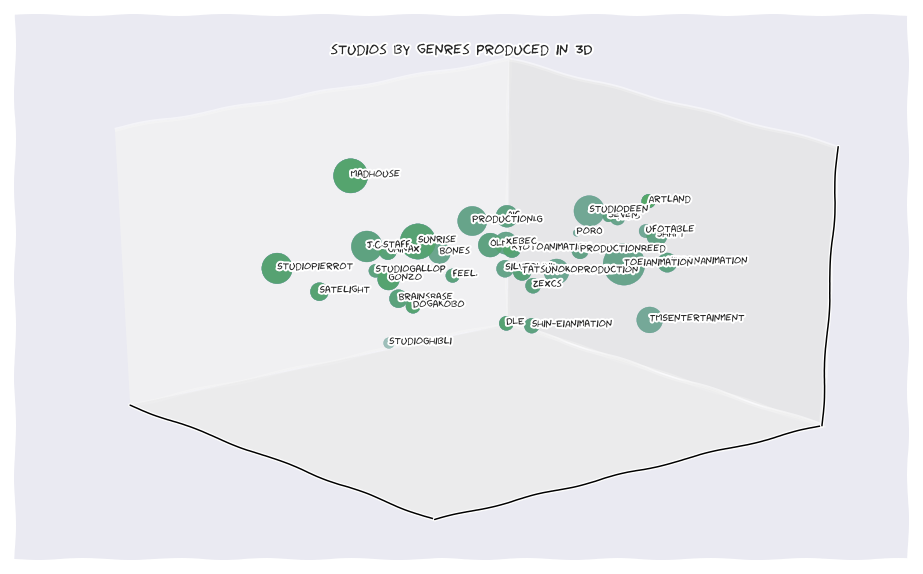

In [184]:
embedder = manifold.TSNE(3, n_iter=1000, n_iter_without_progress=300, init='pca')
embeddings = embedder.fit_transform(studios_genres.div(studios_genres.sum(axis=1), axis=0))

fig = plt.figure(figsize=(16, 10))
ax = plt.axes(projection='3d')
plt.title("studios by genres produced in 3D")
points_3d_to_gif(embeddings, studios_genres.index, 'studios-genres-TSNE', ax, studios_genres.sum(axis=1))

### inspecting genres in time

In [185]:
years_genres = pd.crosstab(animes_genres['aired_from_year'], animes_genres['genre'])
years_genres_all = pd.crosstab(animes_genres_all['aired_from_year'].dropna().astype(np.int), animes_genres_all['genre'])
years_genres_all.index = years_genres_all.index.astype(np.int)


In [186]:
years_total = animes['aired_from_year'].value_counts()
years_total_all = animes_all['aired_from_year'].dropna().astype(np.int).value_counts()


In [187]:
years_genres

genre,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,Game,...,ShounenAi,SliceofLife,Space,Sports,SuperPower,Supernatural,Thriller,Vampire,Yaoi,Yuri
aired_from_year,,,,,,,,,,,,,,,,,,,,,
1942.0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1943.0,0,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1944.0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1945.0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1957.0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1958.0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1959.0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1960.0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1961.0,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


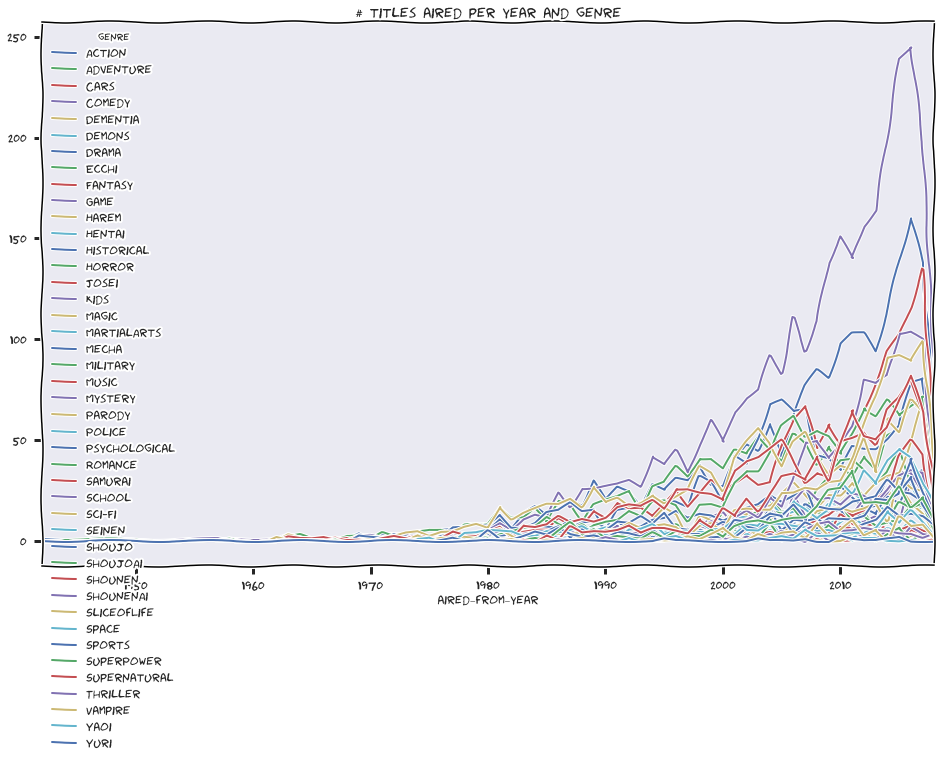

In [188]:
years_genres.plot(figsize=(16, 10), title='# titles aired per year and genre')

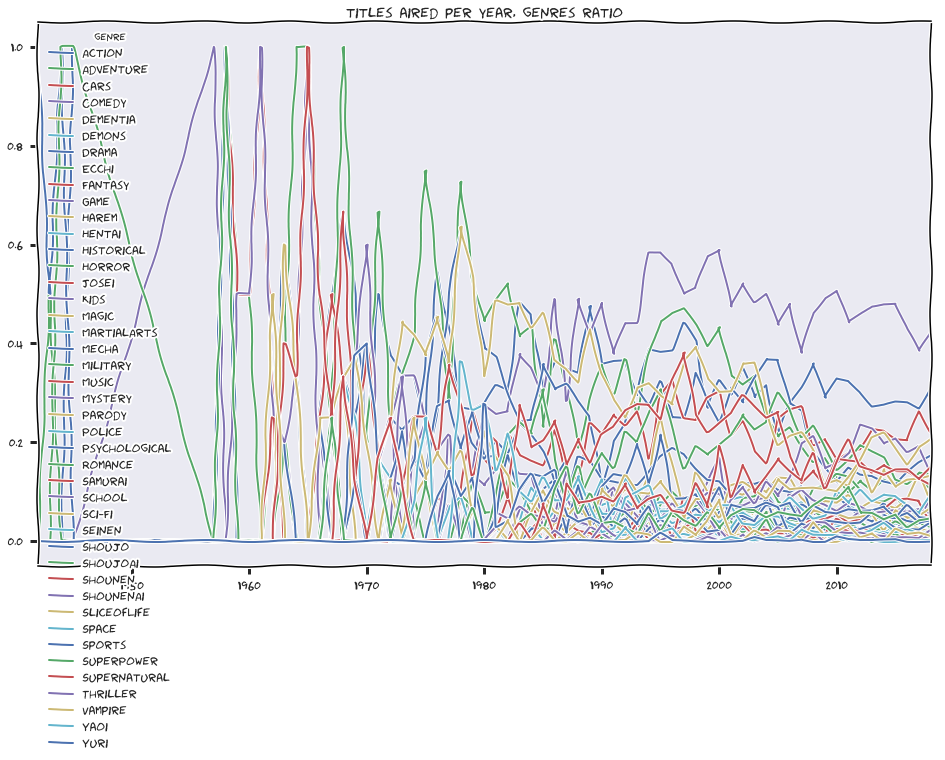

In [189]:
years_genres.div(years_total, axis=0).plot(figsize=(16, 10), title='titles aired per year, genres ratio')

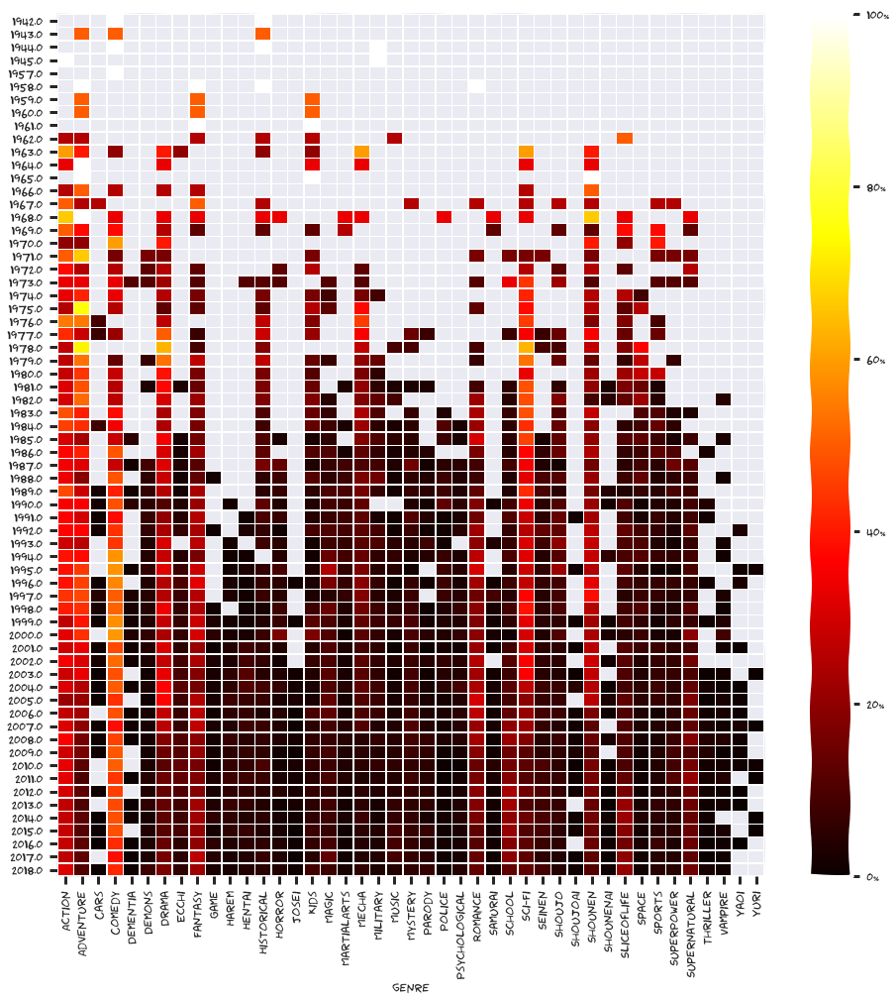

In [190]:
f, ax = plt.subplots(figsize=(16, 16))
mask = np.zeros_like(years_genres, dtype=np.bool)
mask[years_genres == 0] = True
sns.heatmap(years_genres.div(years_total, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})


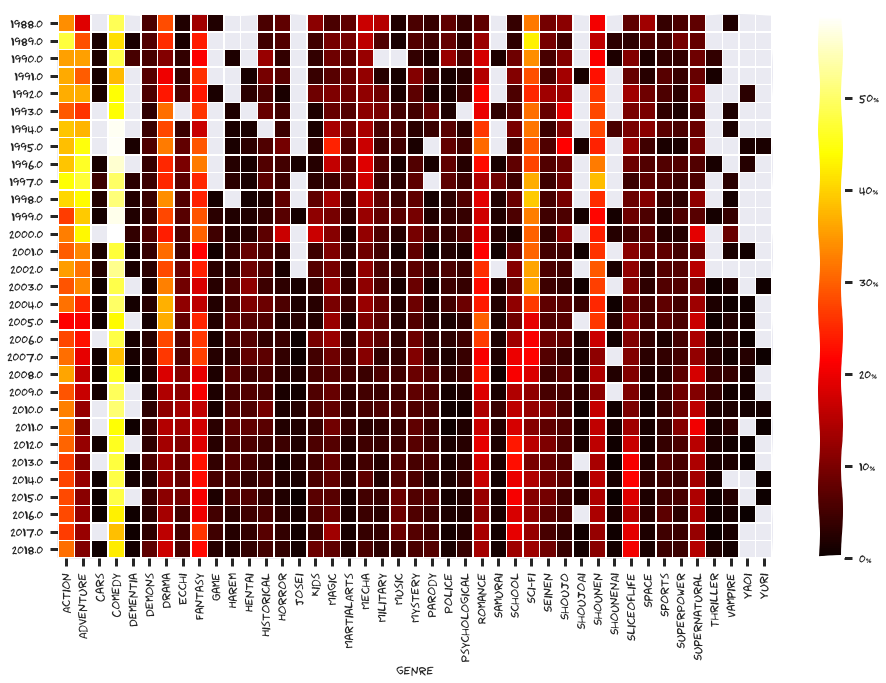

In [191]:
years_genres = years_genres[years_genres.index >= 1988]
years_total = years_total[years_total.index >= 1988]

f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(years_genres, dtype=np.bool)
mask[years_genres == 0] = True
sns.heatmap(years_genres.div(years_total, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})


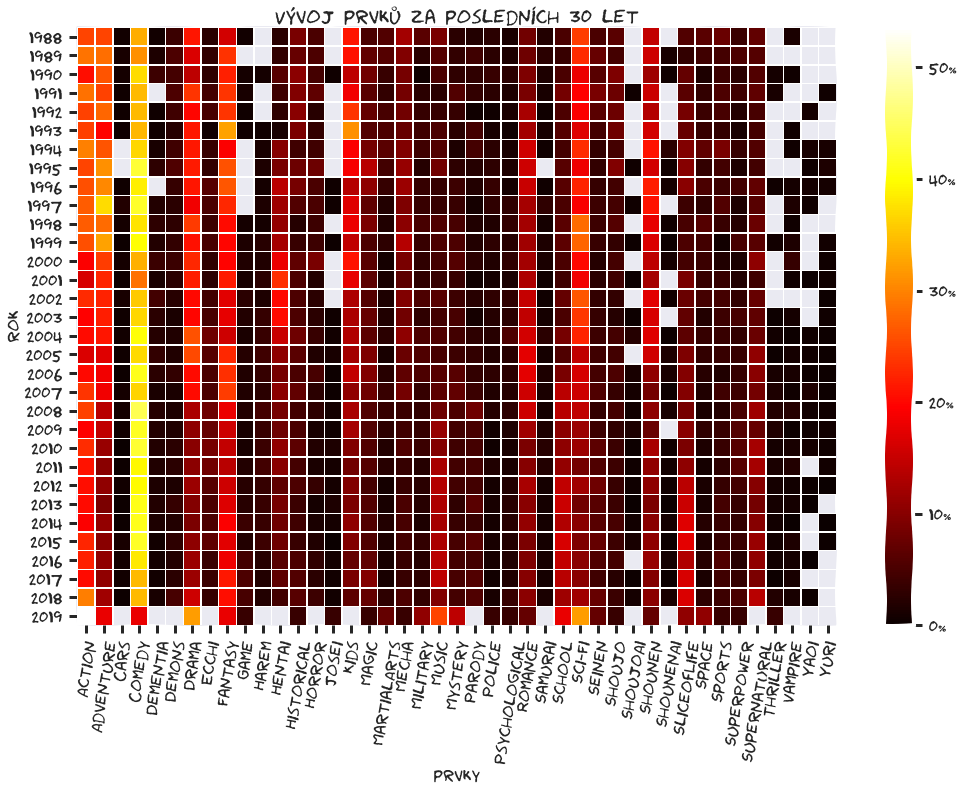

In [258]:
years_genres_all = years_genres_all[years_genres_all.index >= 1988]
years_total_all = years_total_all[years_total_all.index >= 1988]

f, ax = plt.subplots(figsize=(17, 11))
mask = np.zeros_like(years_genres_all, dtype=np.bool)
mask[years_genres_all == 0] = True
sns.heatmap(years_genres_all.div(years_total_all, axis=0) * 100, mask=mask, linewidths=.5, cmap=plt.cm.hot, cbar_kws={'format': '%.0f%%'})
plt.title('Vývoj prvků za posledních 30 let')
plt.xticks(rotation=80)
plt.ylabel('rok')
plt.xlabel('prvky')
plt.savefig('graphs/zanry-cas-1988.png', bbox_inches="tight")

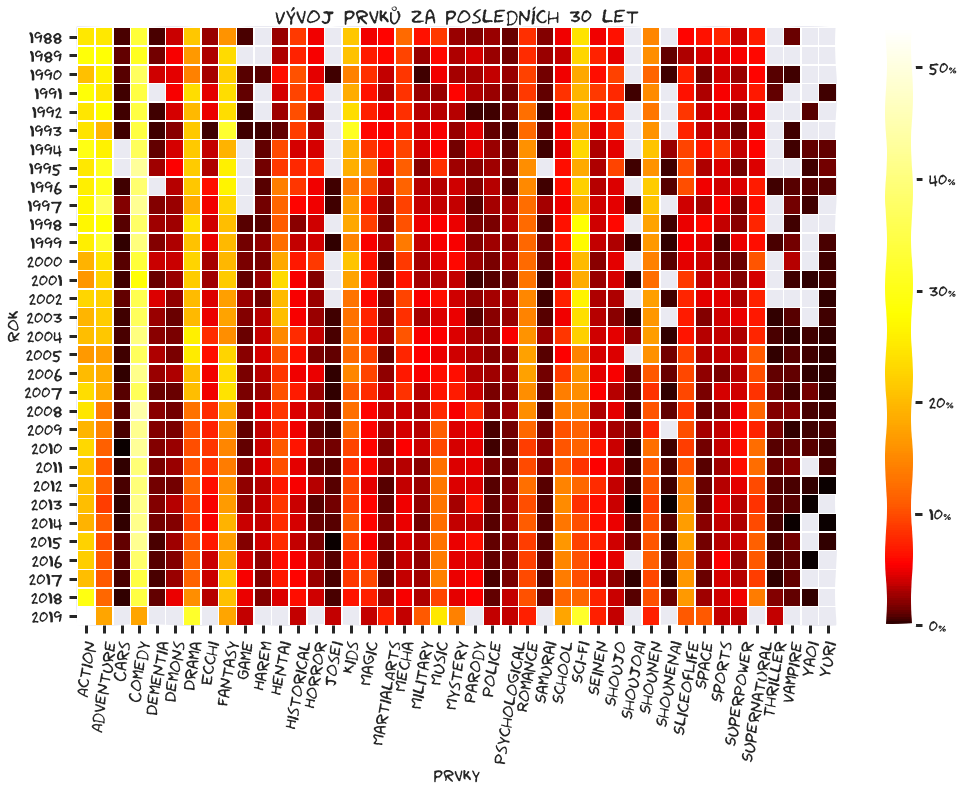

In [259]:
f, ax = plt.subplots(figsize=(17, 11))
data = years_genres_all.div(years_total_all, axis=0) * 100
cmap = equalize_colormap(plt.cm.hot, data)
mask = np.zeros_like(years_genres_all, dtype=np.bool)
mask[years_genres_all == 0] = True
sns.heatmap(data, mask=mask, cmap=cmap, linewidths=.5, cbar_kws={'format': '%.0f%%'})
plt.title('Vývoj prvků za posledních 30 let')
plt.xticks(rotation=80)
plt.ylabel('rok')
plt.xlabel('prvky')
plt.savefig('graphs/zanry-cas-1988-equalized.png', bbox_inches="tight")

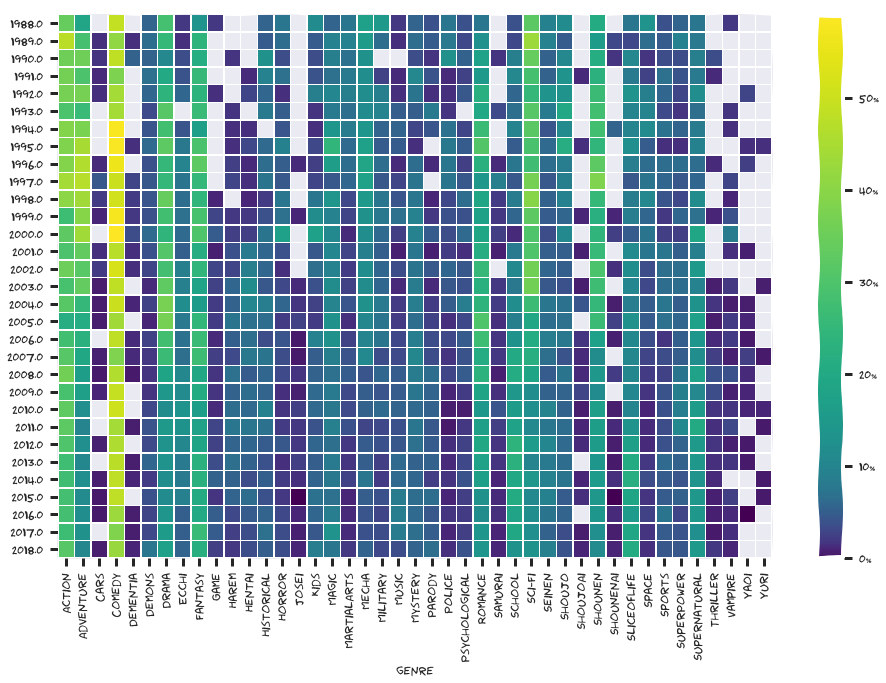

In [194]:
years_genres = years_genres[years_genres.index >= 1988]

f, ax = plt.subplots(figsize=(16, 10))
data = years_genres.div(years_total, axis=0) * 100
cmap = equalize_colormap(plt.cm.viridis, data)
mask = np.zeros_like(years_genres, dtype=np.bool)
mask[years_genres == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})

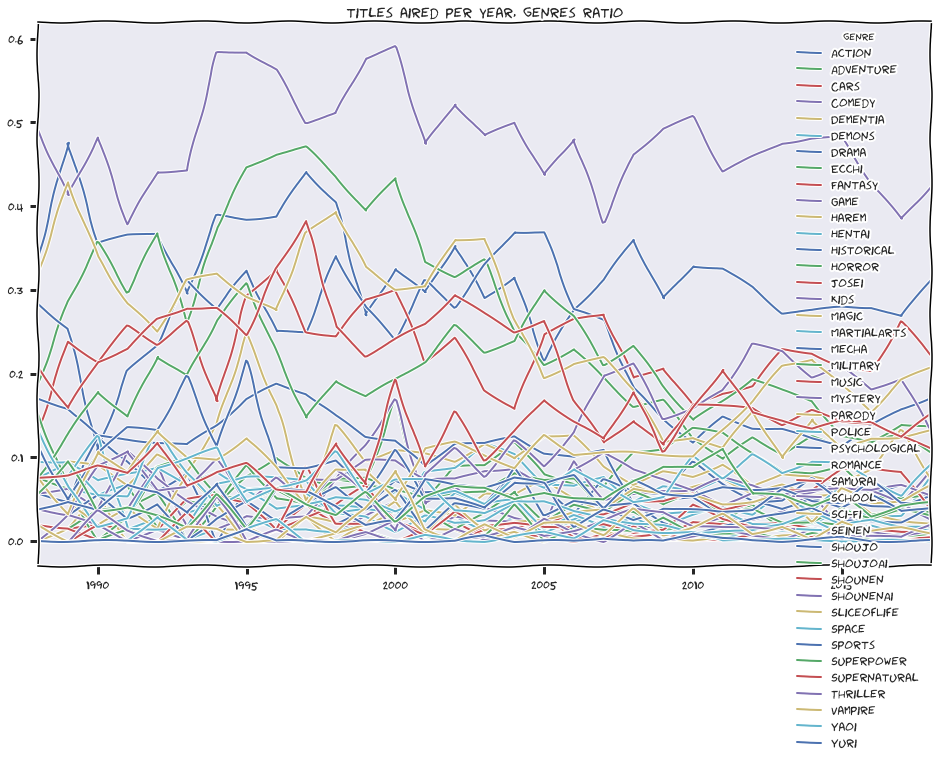

In [195]:
years_genres.div(years_total, axis=0).plot(figsize=(16, 10), title='titles aired per year, genres ratio')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34]), <a list of 35 Text xticklabel objects>)

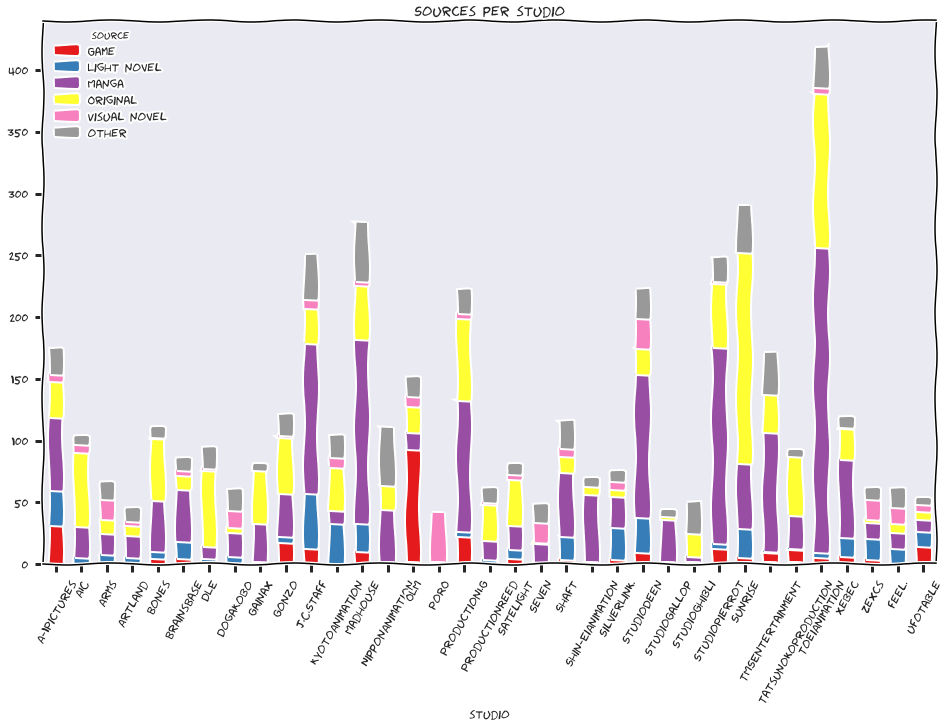

In [196]:
studios_sources = pd.crosstab(animes_studios['studio'], animes_studios['source'])
# keeping only interesting sources
interesting_sources = ['Game', 'Light novel', 'Manga', 'Original', 'Visual novel']
other_sources = list(set(studios_sources.columns) - set(interesting_sources))
studios_sources['other'] = studios_sources[other_sources].sum(axis=1)
studios_sources = studios_sources.drop(other_sources, axis=1)

studios_sources = studios_sources[studios_sources.index.isin(known_studios)]

colors = plt.cm.Set1(np.linspace(0, 1, studios_sources.shape[1]))
studios_sources.plot.bar(stacked=True, figsize=(16, 10), title='Sources per studio', color=colors)
plt.xticks(rotation=60)

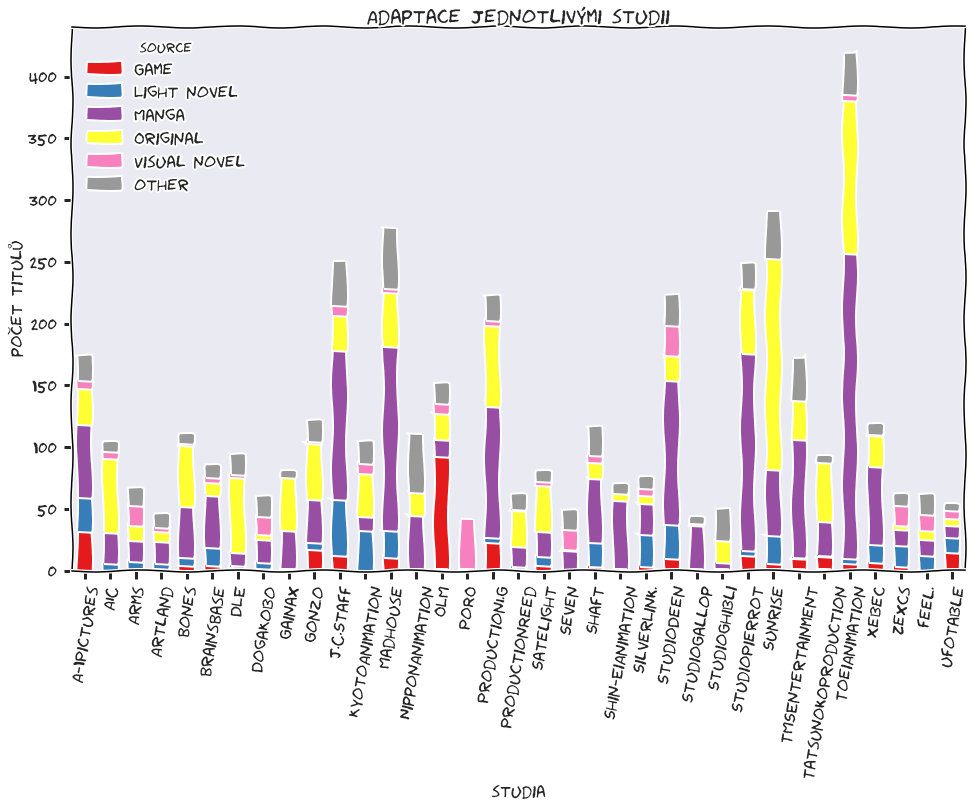

In [262]:
studios_sources_all = pd.crosstab(animes_studios_all['studio'], animes_studios_all['source'])
# keeping only interesting sources
interesting_sources = ['Game', 'Light novel', 'Manga', 'Original', 'Visual novel']
other_sources = list(set(studios_sources_all.columns) - set(interesting_sources))
studios_sources_all['other'] = studios_sources_all[other_sources].sum(axis=1)
studios_sources_all = studios_sources_all.drop(other_sources, axis=1)

studios_sources_all = studios_sources_all[studios_sources_all.index.isin(known_studios)]

colors = plt.cm.Set1(np.linspace(0, 1, studios_sources_all.shape[1]))
studios_sources.plot.bar(stacked=True, figsize=(16, 10), title='Zdroje adaptací jednotlivých studií', color=colors)
plt.xticks(rotation=80)
plt.title('Adaptace jednotlivými studii')
plt.ylabel('počet titulů')
plt.xlabel('studia')
plt.savefig('graphs/adaptace-studia-known.png', bbox_inches="tight")

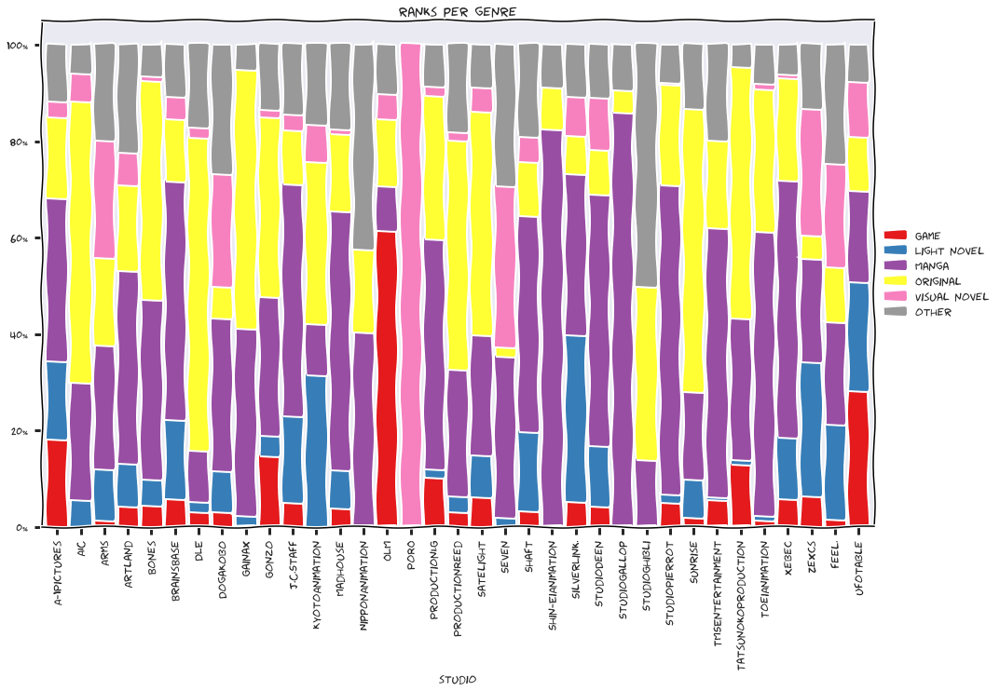

In [198]:
studios_sources.div(studios_sources.sum(axis=1), axis=0).plot(kind='bar', stacked=True, figsize=(16, 10), title='ranks per genre', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

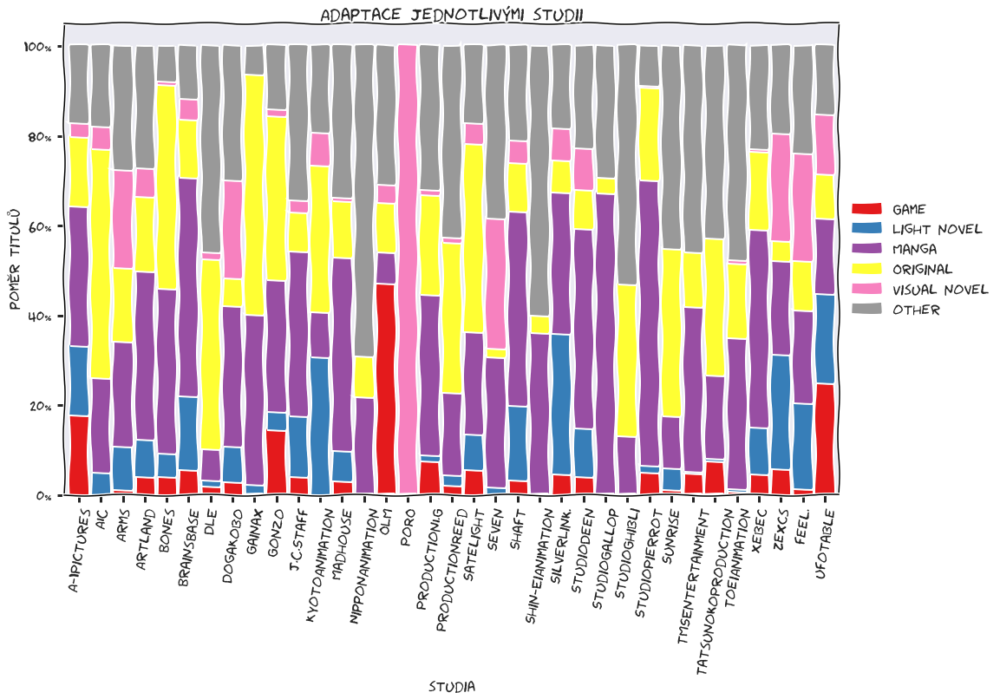

In [263]:
studios_sources_all.div(studios_sources_all.sum(axis=1), axis=0).plot(kind='bar', stacked=True, figsize=(16, 10), title='Zdroje adaptací jednotlivých studií', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xticks(rotation=80)
plt.title('Adaptace jednotlivými studii')
plt.ylabel('poměr titulů')
plt.xlabel('studia')
plt.savefig('graphs/adaptace-studia-known-normed.png', bbox_inches="tight")

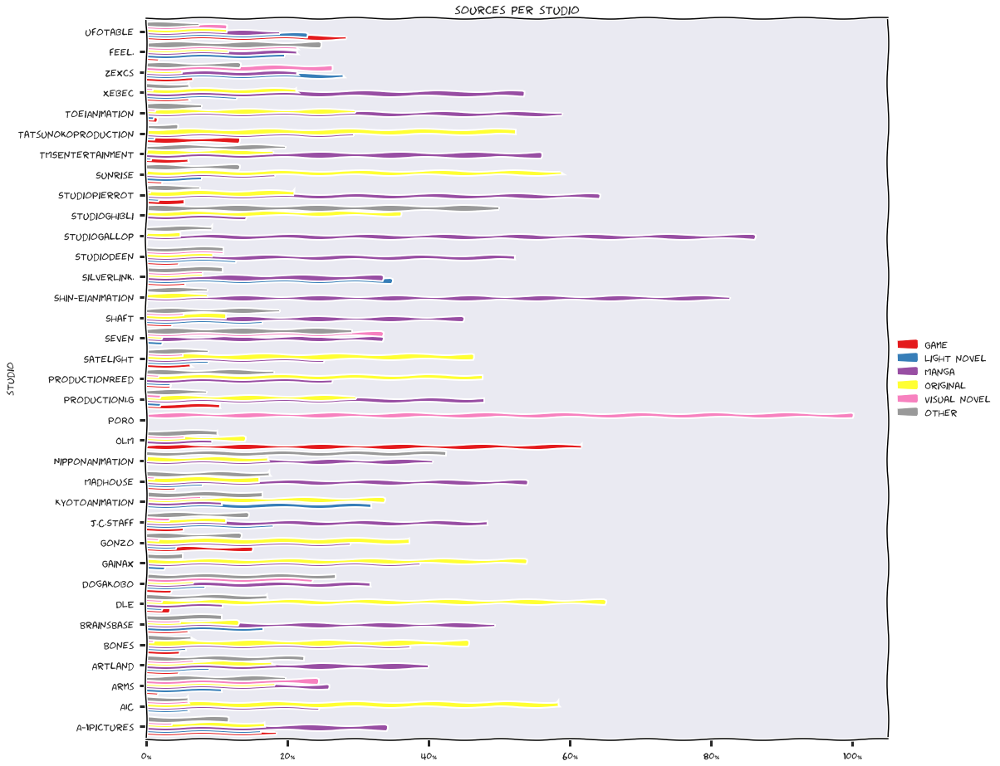

In [200]:
studios_sources.div(studios_sources.sum(axis=1), axis=0).plot(kind='barh', stacked=False, figsize=(16, 16), title='sources per studio', color=colors, width=0.8)
plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.gca().xaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 

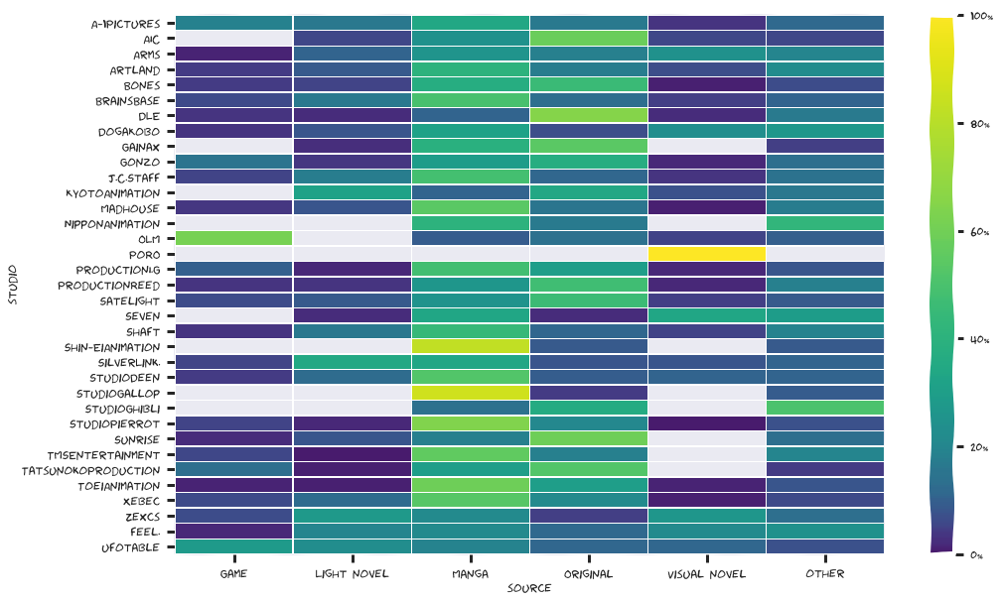

In [201]:
f, ax = plt.subplots(figsize=(16, 10))
data = studios_sources.div(studios_sources.sum(axis=1), axis=0) * 100
cmap = equalize_colormap(plt.cm.viridis, data)
mask = np.zeros_like(studios_sources, dtype=np.bool)
mask[studios_sources == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})

In [202]:
# using all soutces because they fit into the heatmap
studios_sources_all = pd.crosstab(animes_studios_all['studio'], animes_studios_all['source'])
studios_sources_all = studios_sources_all[studios_sources_all.index.isin(known_studios)]

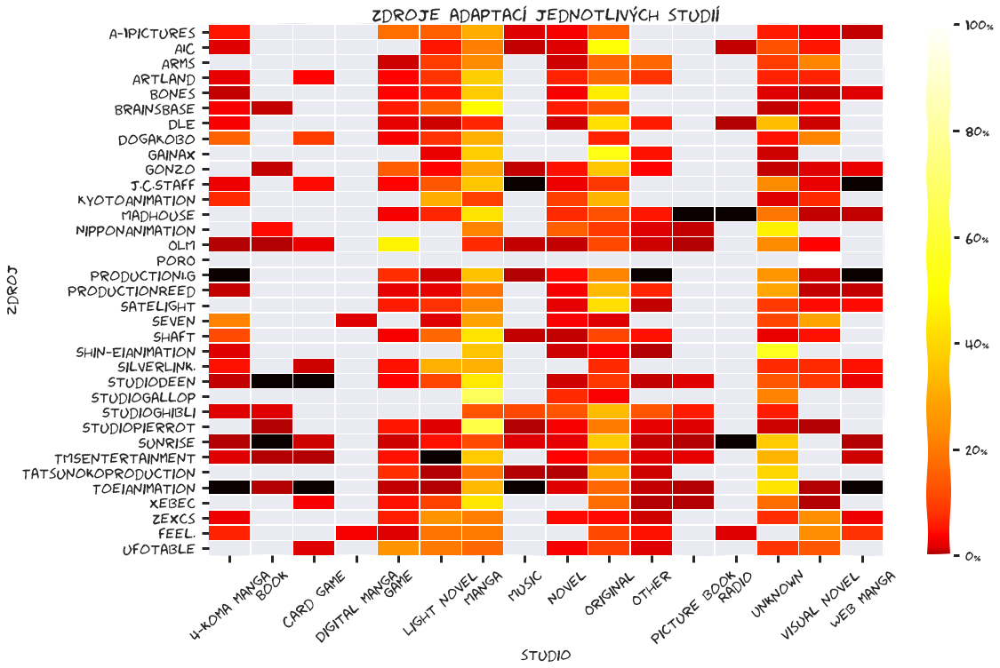

In [245]:
f, ax = plt.subplots(figsize=(17, 11))
data = studios_sources_all.div(studios_sources_all.sum(axis=1), axis=0) * 100
cmap = equalize_colormap(plt.cm.hot, data)
mask = np.zeros_like(studios_sources_all, dtype=np.bool)
mask[studios_sources_all == 0] = True
sns.heatmap(data, mask=mask, linewidths=.5, cmap=cmap, cbar_kws={'format': '%.0f%%'})
plt.xticks(rotation=40)
plt.title('Zdroje adaptací jednotlivých studií')
plt.ylabel('zdroj')
plt.xlabel('studio')
plt.savefig('graphs/adaptace-studia-heatmap.png', bbox_inches="tight")

#### genres similarity based on in how many anime they appear together


In [204]:
genres_animes = pd.crosstab(animes_genres['genre'], animes_genres.index.get_level_values('anime_id'))

In [205]:
genres_animes.head()

col_0,1,5,6,7,8,15,16,17,18,19,...,37802,37814,37858,37859,37860,37886,37888,37894,37895,37896
genre,,,,,,,,,,,,,,,,,,,,,
Action,1,1,1,1,0,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
Adventure,1,0,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Cars,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
Comedy,1,0,1,0,0,1,1,1,0,0,...,0,0,1,1,1,0,0,0,0,0
Dementia,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [206]:
genres_animes.iloc[0:5, 0:5].rename(columns=animes[animes.index.isin(genres_animes.columns[0:5])]['title'].to_dict())



col_0,Cowboy Bebop,Cowboy Bebop: Tengoku no Tobira,Trigun,Witch Hunter Robin,Beet the Vandel Buster
genre,,,,,
Action,1,1,1,1,0
Adventure,1,0,1,0,1
Cars,0,0,0,0,0
Comedy,1,0,1,0,0
Dementia,0,0,0,0,0


17

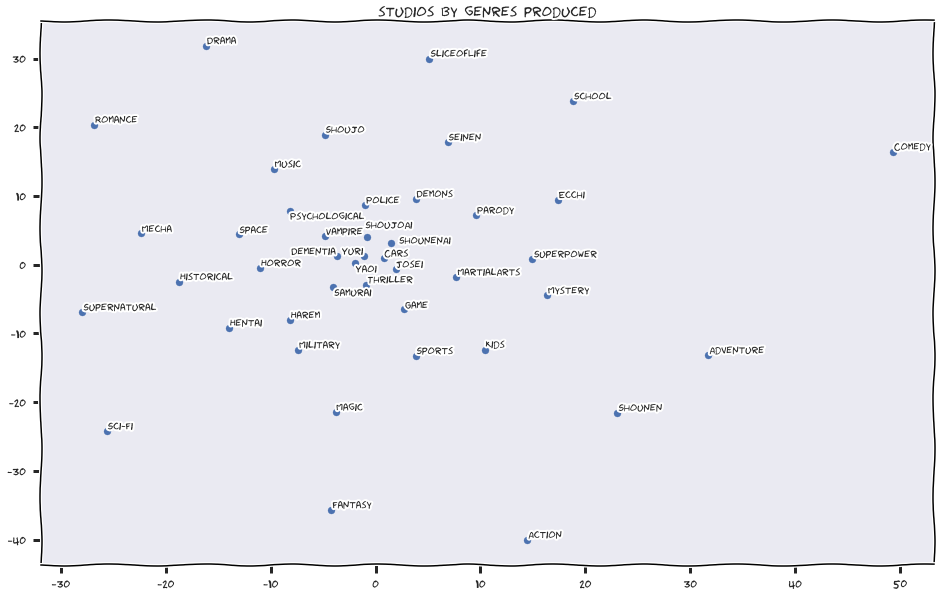

In [207]:
embedder = manifold.MDS(2, max_iter=2000, n_init=5)
embeddings = embedder.fit_transform(genres_animes)
# need to agregate animes_studios because it does not contain duplicities because of genres
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1])
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

<IPython.core.display.Javascript object>


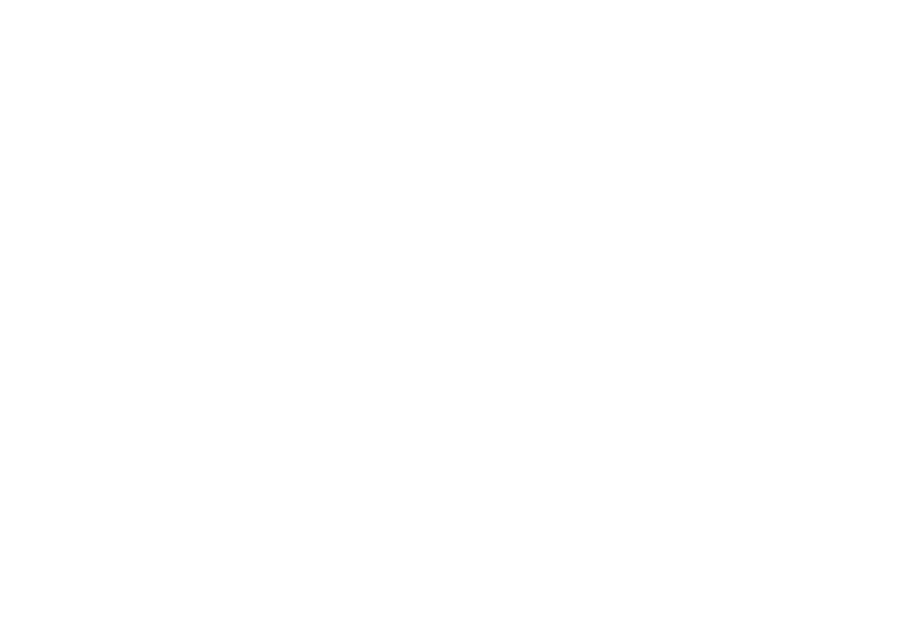

<IPython.core.display.Javascript object>


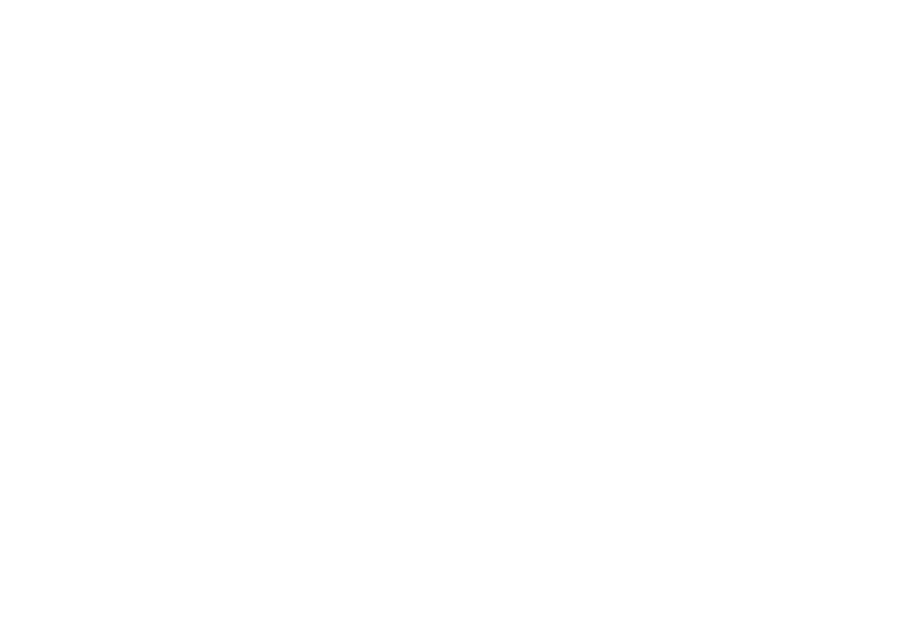

In [208]:
%matplotlib notebook

embedder = manifold.MDS(3, max_iter=2000, n_init=10)
embeddings = embedder.fit_transform(genres_animes)
plt.figure(figsize=(10, 7))
ax = plt.axes(projection='3d')
ax.scatter3D(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2])
#for i, txt in enumerate(genres_animes.index):
#    ax.text(embeddings[i, 0], embeddings[i, 1], embeddings[i, 2], txt)
plt.show()

In [209]:
embeddings

array([[ 2.55451899e+01, -3.42416888e+00,  3.27793389e+01],
       [ 3.96002872e+00, -1.99231487e+01,  2.63126363e+01],
       [ 1.25847281e+00,  3.77908789e+00, -1.26950097e+00],
       [ 1.94444220e+00, -5.07546682e+01, -4.73705709e+00],
       [-7.95395657e-01,  6.63238658e+00, -2.55669984e+00],
       [-5.81200833e+00,  1.43662902e+00,  1.05491282e+01],
       [ 2.71139937e+01, -1.40523636e+00, -2.06439440e+01],
       [ 6.24769767e+00, -1.51688191e+01, -5.83777092e+00],
       [-1.88753481e+01, -1.93726208e+01,  2.27771248e+01],
       [-4.66250727e+00,  7.73911411e-01, -9.90252380e+00],
       [-1.40355508e+00, -9.07204488e+00, -7.22627285e+00],
       [-1.01831044e+01,  1.83040123e+01, -2.16258797e+00],
       [-8.63978152e+00, -1.27547773e+01,  4.61641670e+00],
       [-5.81627218e+00,  1.15020097e+01,  7.97019744e+00],
       [ 6.20299926e-01,  1.41493561e+00, -4.77804702e+00],
       [-1.85658580e+01, -5.15250614e+00, -5.31489332e-01],
       [-2.09759215e+01,  6.53363246e-02

In [210]:
dists = pdist(genres_animes, 'euclidean')
dists_m = squareform(dists)
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index
dists_df

genre,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,Game,...,ShounenAi,SliceofLife,Space,Sports,SuperPower,Supernatural,Thriller,Vampire,Yaoi,Yuri
genre,,,,,,,,,,,,,,,,,,,,,
Action,0.000000,46.151923,45.210618,60.991803,45.628938,45.254834,50.626080,47.212287,47.539457,45.793013,...,45.694639,54.000000,44.721360,47.106263,42.848571,46.486557,45.519227,45.310043,45.552168,45.354162
Adventure,46.151923,0.000000,37.121422,56.480085,37.389838,38.078866,46.162756,41.940434,39.038443,37.775654,...,37.496667,46.818800,38.209946,40.533936,39.064050,43.646306,37.762415,37.934153,37.188708,36.945906
Cars,45.210618,37.121422,0.000000,55.226805,9.380832,16.248077,36.891733,23.388031,38.496753,14.456832,...,9.797959,31.080541,16.970563,18.027756,20.199010,30.016662,10.954451,11.874342,8.306624,7.141428
Comedy,60.991803,56.480085,55.226805,0.000000,55.226805,55.497748,59.674115,52.905576,57.183914,55.668663,...,54.899909,52.971691,56.338264,55.181519,55.063600,56.771472,55.533774,55.090834,55.072679,55.018179
Dementia,45.628938,37.389838,9.380832,55.226805,0.000000,16.370706,36.810325,23.430749,38.392708,14.662878,...,10.000000,31.176915,17.088007,19.621417,20.346990,29.681644,10.862780,12.124356,8.660254,7.549834
Demons,45.254834,38.078866,16.248077,55.497748,16.370706,0.000000,38.820098,26.134269,38.157568,19.467922,...,16.673332,33.882149,21.633308,23.685439,23.664319,28.372522,17.320508,17.406895,15.842980,15.264338
Drama,50.626080,46.162756,36.891733,59.674115,36.810325,38.820098,0.000000,41.833001,47.318073,38.470768,...,36.510273,42.508823,37.483330,38.626416,40.137264,42.473521,36.891733,37.309516,36.523965,36.715120
Ecchi,47.212287,41.940434,23.388031,52.905576,23.430749,26.134269,41.833001,0.000000,41.460825,25.651511,...,23.685439,37.242449,27.110883,28.530685,28.195744,34.641016,24.186773,24.124676,23.108440,22.494444
Fantasy,47.539457,39.038443,38.496753,57.183914,38.392708,38.157568,47.318073,41.460825,0.000000,38.639358,...,38.470768,46.583259,40.938979,42.059482,40.398020,42.320208,38.832976,38.613469,38.327536,38.039453


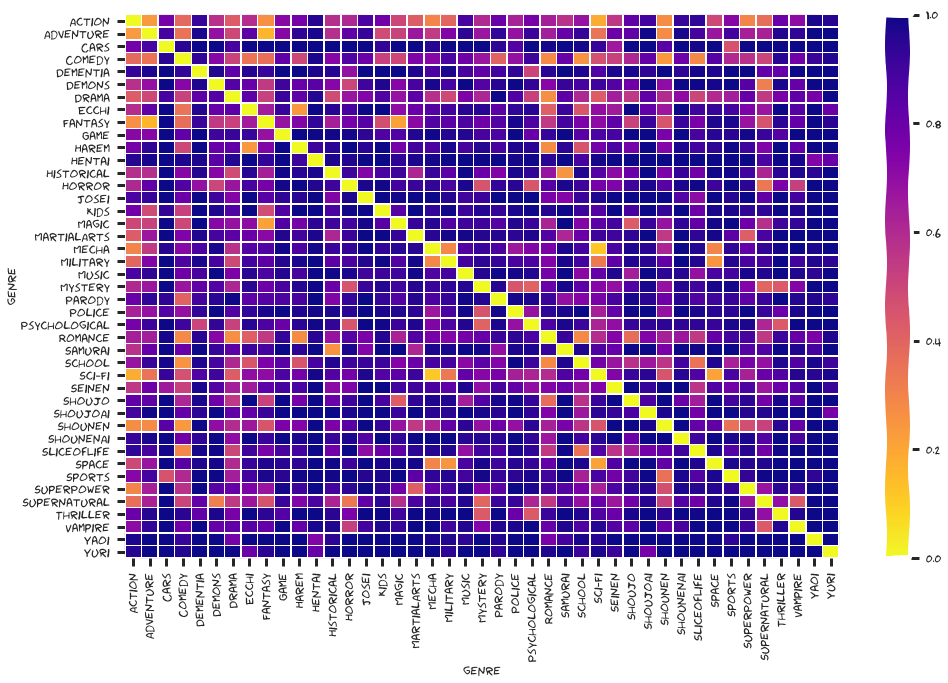

In [211]:
%matplotlib inline
dists = pdist(genres_animes, 'cosine')
dists_m = squareform(dists) ** 3
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(dists_df, linewidths=.5, cmap=plt.cm.plasma_r)

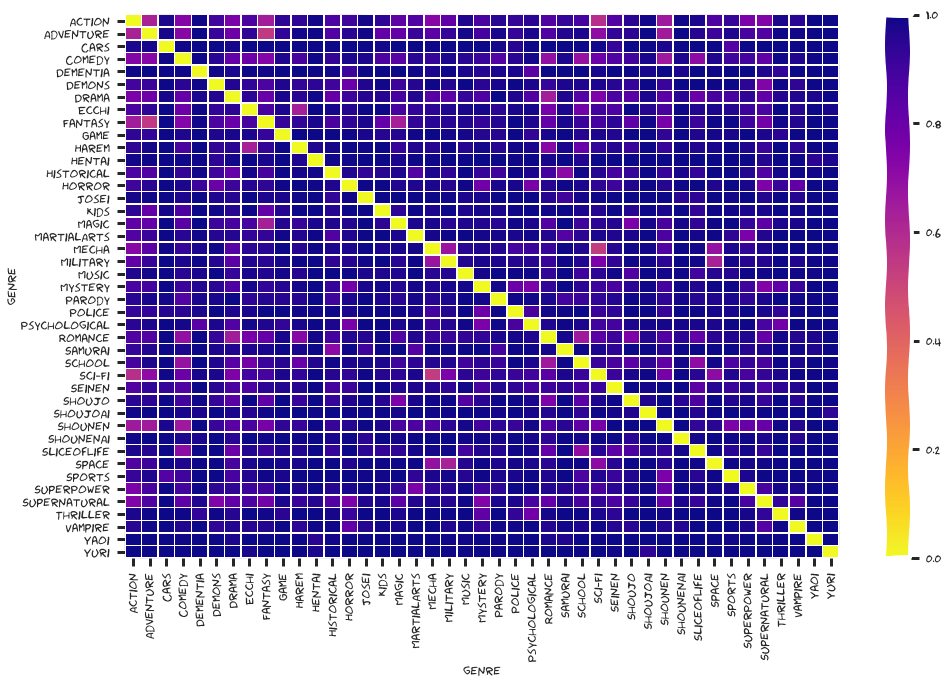

In [212]:
%matplotlib inline
dists = pdist(genres_animes, 'dice')
dists_m = squareform(dists)
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(dists_df, linewidths=.5, cmap=plt.cm.plasma_r)

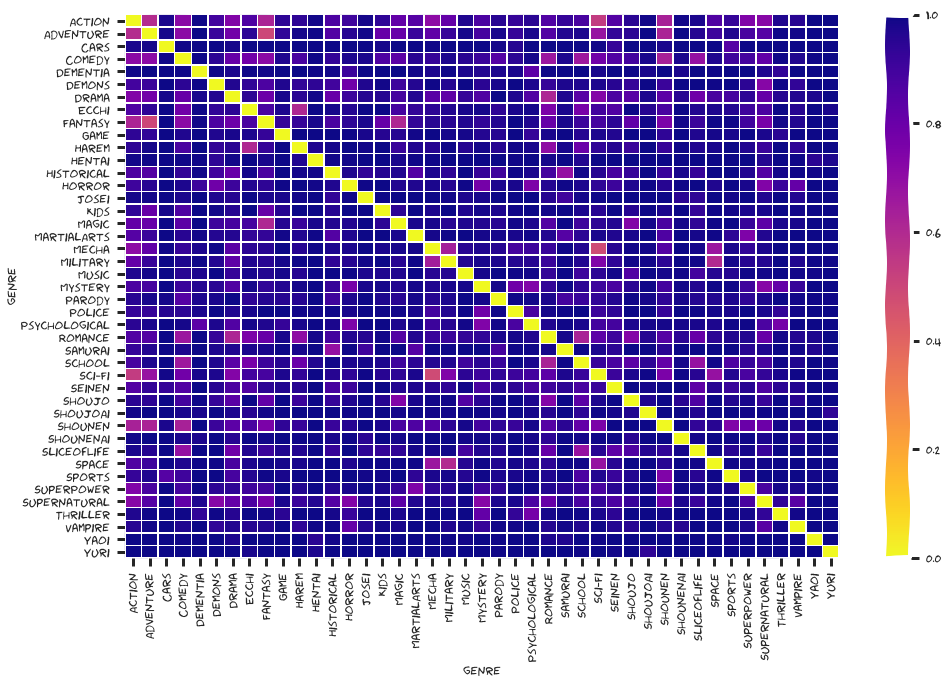

In [213]:
%matplotlib inline
dists = pdist(genres_animes, lambda x, y: 1 - (x & y).sum() / (x | y).sum())
dists_m = squareform(dists) ** 2
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(dists_df, linewidths=.5, cmap=plt.cm.plasma_r)

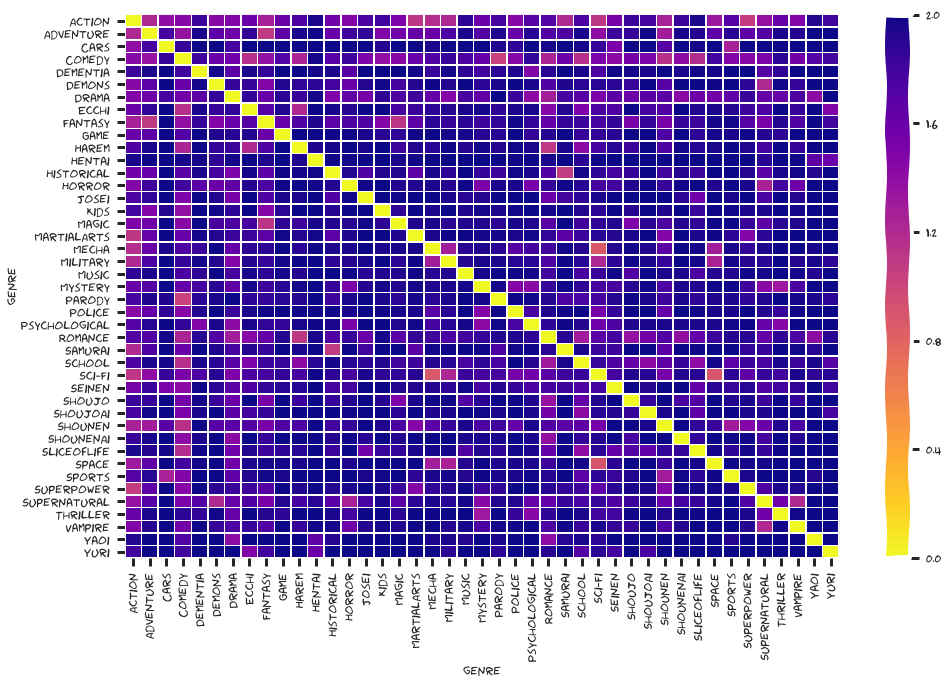

In [214]:
%matplotlib inline
dists = pdist(genres_animes, lambda x, y: 2 - ((x & y).sum() / x.sum() + (x & y).sum() / y.sum()))
dists_m = squareform(dists)
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(dists_df, linewidths=.5, cmap=plt.cm.plasma_r)

## using normalized social distance
by Šlerka http://databoutique.cz/

![title](http://stromateis.eu/dbblog/nsd.png)
well, basically it is the normalized web distance
Interesting fact is that it gives infinite distance for disjunctive genres, allowing to produce sparse graph for embedding

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


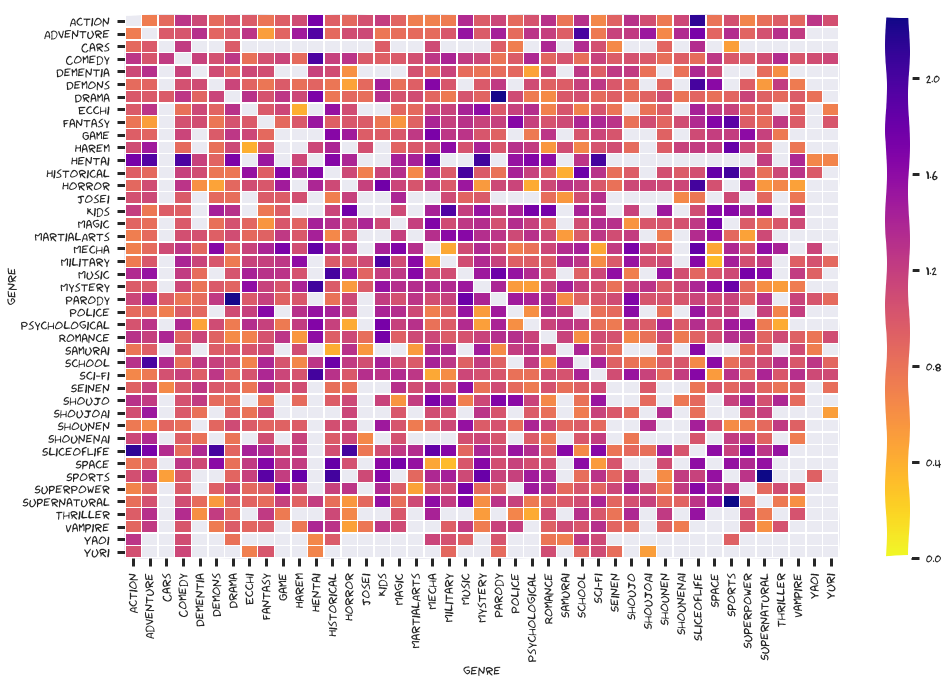

In [215]:
def nsd(x, y):
    return (max(np.log(x.sum()), np.log(y.sum())) - np.log((x & y).sum())) / (np.log(x.size) - min(np.log(x.sum()), np.log(y.sum())))

%matplotlib inline
dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 0  # infinities mess color scale

dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(16, 10))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.plasma_r)

In [216]:
dists_df

genre,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,Game,...,ShounenAi,SliceofLife,Space,Sports,SuperPower,Supernatural,Thriller,Vampire,Yaoi,Yuri
genre,,,,,,,,,,,,,,,,,,,,,
Action,0.000000,0.733085,0.873721,1.270502,1.119555,0.853234,0.998188,0.979937,0.785457,0.955087,...,1.131686,2.125247,0.795772,1.067753,0.673571,0.829852,0.960262,0.889257,1.266921,1.066295
Adventure,0.733085,0.000000,0.984959,1.022117,1.315700,0.898558,0.979856,1.272230,0.513456,0.907579,...,1.358811,1.726163,0.894931,1.339183,0.905997,1.058894,1.313467,1.222134,0.000000,0.000000
Cars,0.873721,0.984959,0.000000,1.222098,0.000000,0.000000,0.982479,0.000000,0.000000,0.000000,...,0.000000,1.341992,0.000000,0.496417,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Comedy,1.270502,1.022117,1.222098,0.000000,1.173947,1.061614,1.260870,0.820884,1.059894,1.142961,...,0.954601,0.844581,1.263455,0.991839,0.976698,1.082901,1.337963,1.012583,1.084358,1.125857
Dementia,1.119555,1.315700,0.000000,1.173947,0.000000,1.091404,0.906456,1.116880,1.075258,0.000000,...,0.808855,1.378987,1.112036,0.000000,0.000000,0.846126,0.602131,0.000000,0.000000,0.000000
Demons,0.853234,0.898558,0.000000,1.061614,1.091404,0.000000,1.148880,0.909852,0.773761,0.982313,...,0.000000,2.010993,1.621695,0.000000,0.941132,0.536443,1.219197,0.739310,0.000000,0.000000
Drama,0.998188,0.979856,0.982479,1.260870,0.906456,1.148880,0.000000,1.299016,1.043055,1.259059,...,0.791666,0.894900,0.819135,0.897939,1.155106,0.935623,0.871861,0.967645,0.808868,0.000000
Ecchi,0.979937,1.272230,0.000000,0.820884,1.116880,0.909852,1.299016,0.000000,0.984079,1.126771,...,0.000000,1.433882,1.222824,1.180134,0.884055,0.906962,0.000000,0.891012,0.000000,0.710116
Fantasy,0.785457,0.513456,0.000000,1.059894,1.075258,0.773761,1.043055,0.984079,0.000000,0.872881,...,1.082655,1.357639,1.663487,1.899644,0.964349,0.845808,1.235919,0.965449,0.000000,1.012005


In [217]:
x = genres_animes.loc['Mecha']
y = genres_animes.loc['Sci-Fi']
y = genres_animes.loc['Mecha']
print(1 - (x & y).sum() / (x | y).sum())
print((x & y).sum() / (x | y).sum())


0.0
1.0


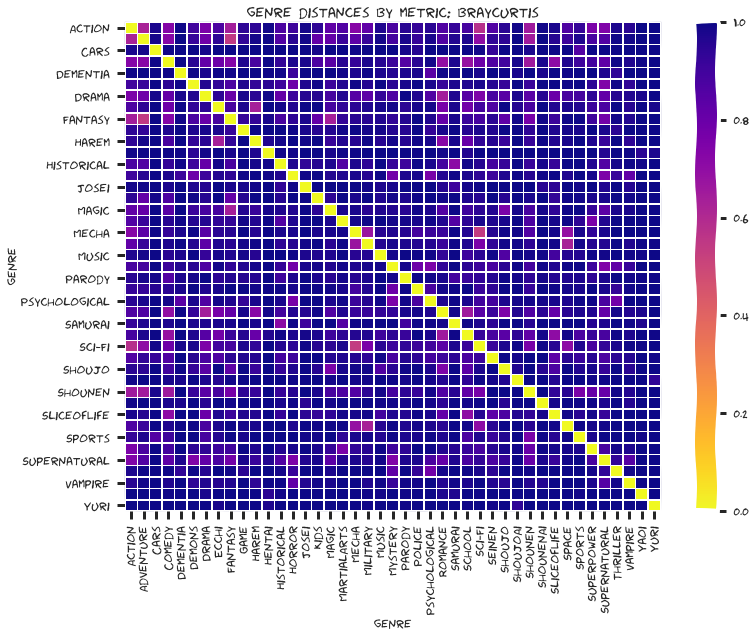

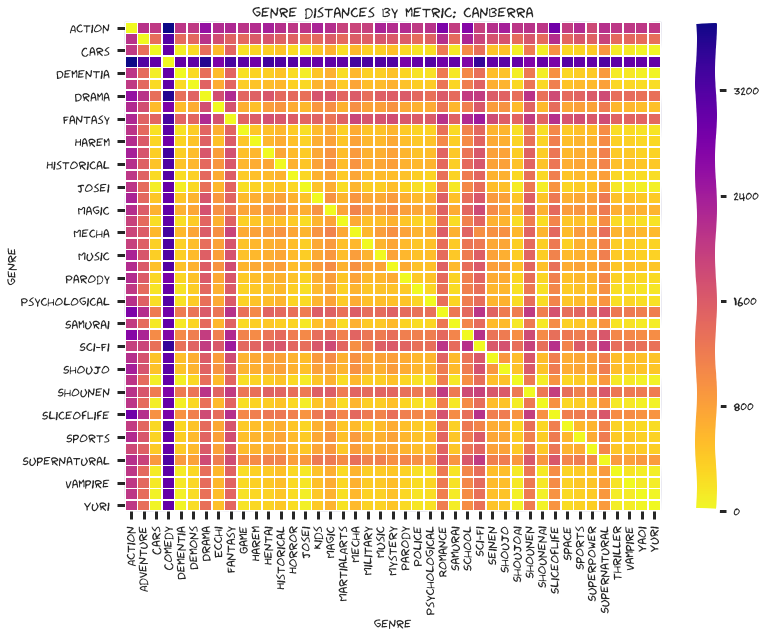

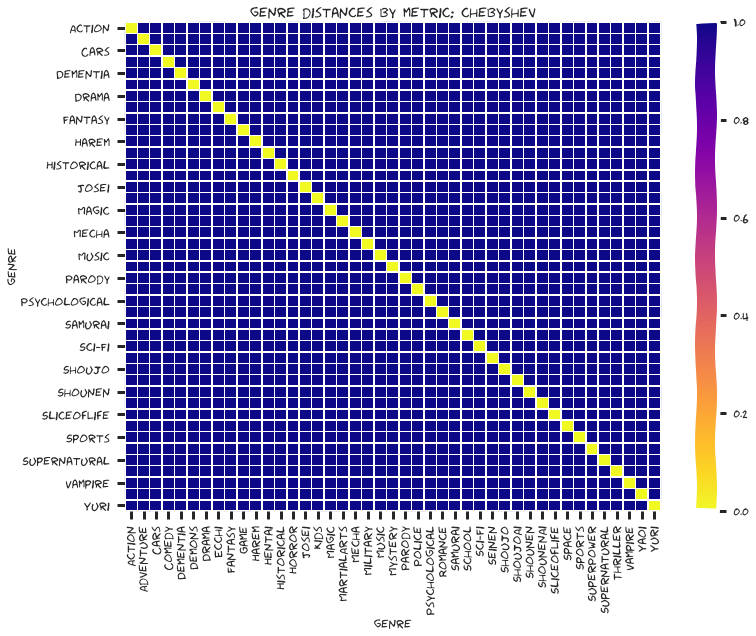

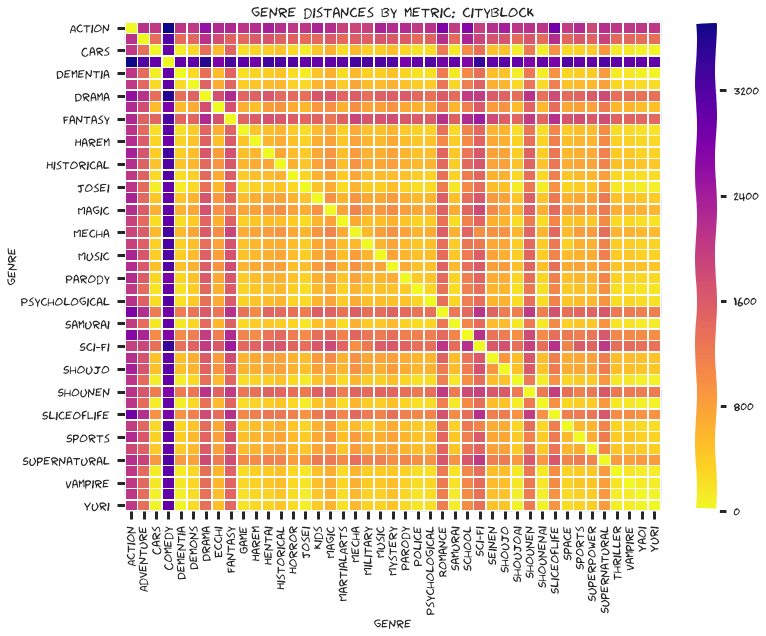

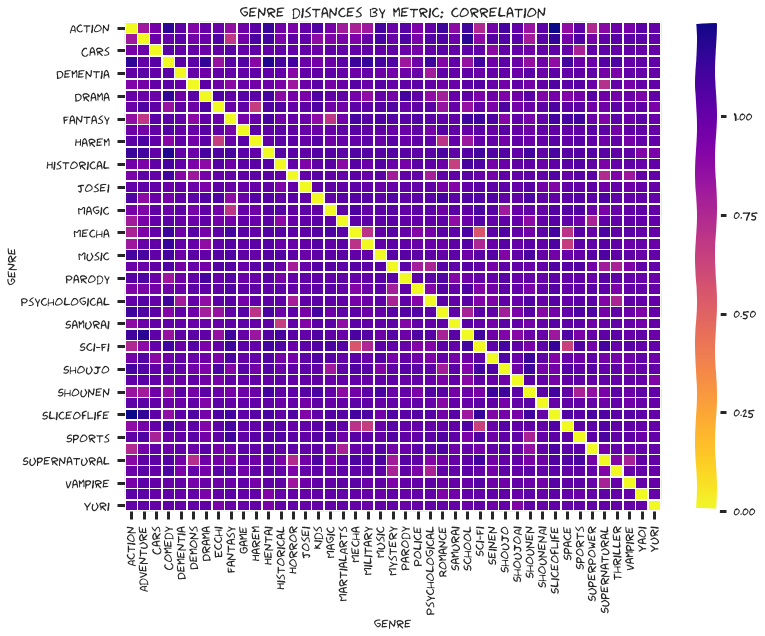

...

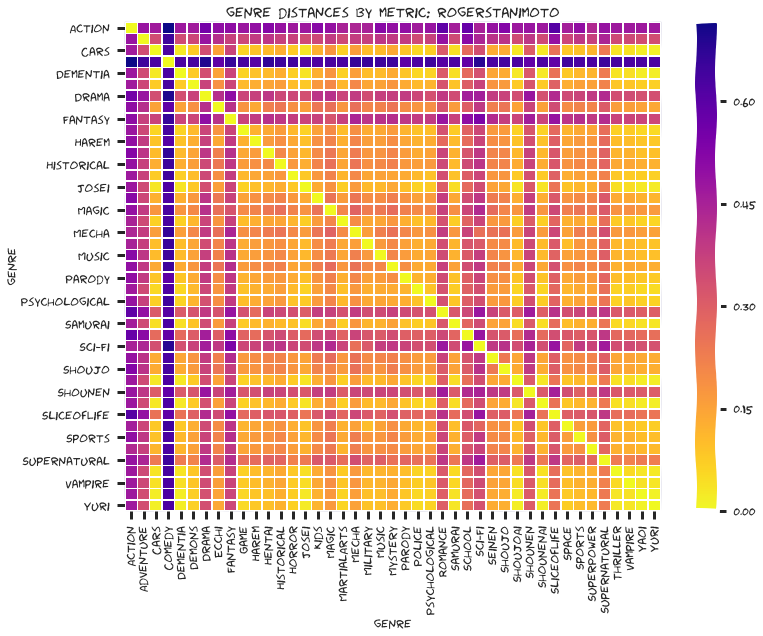

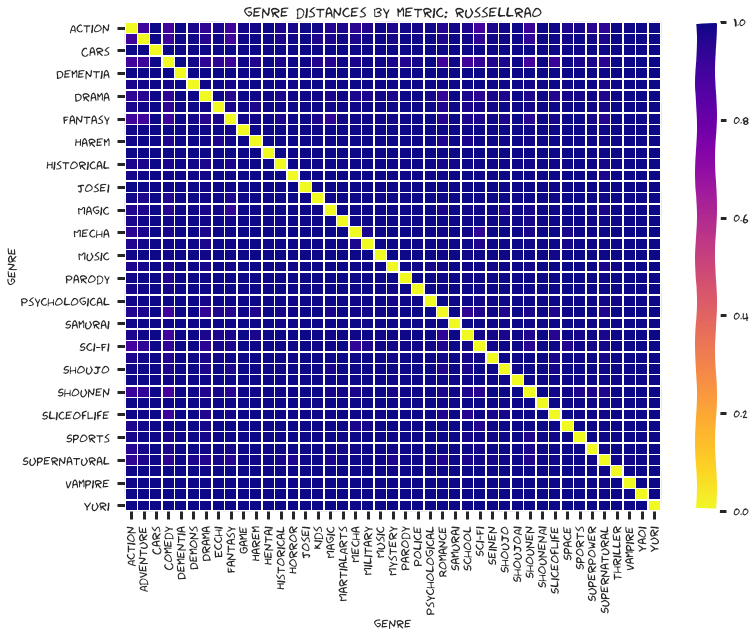

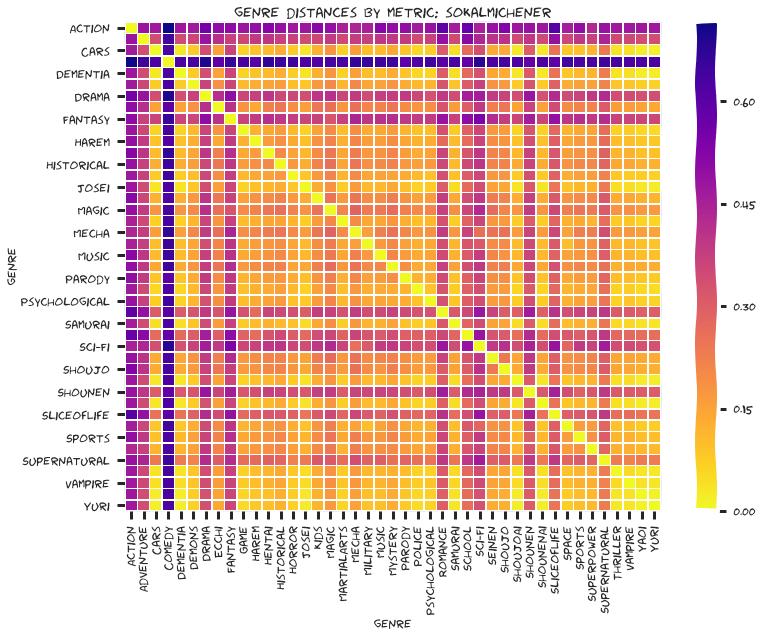

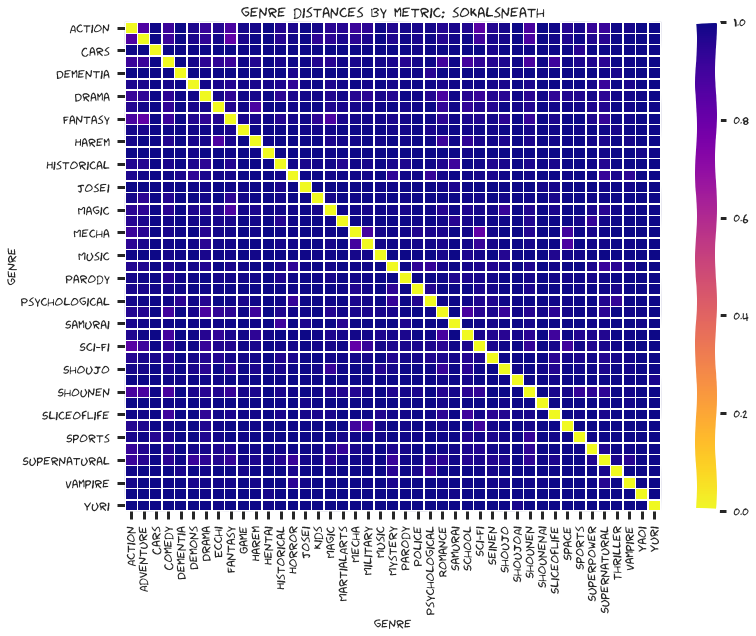

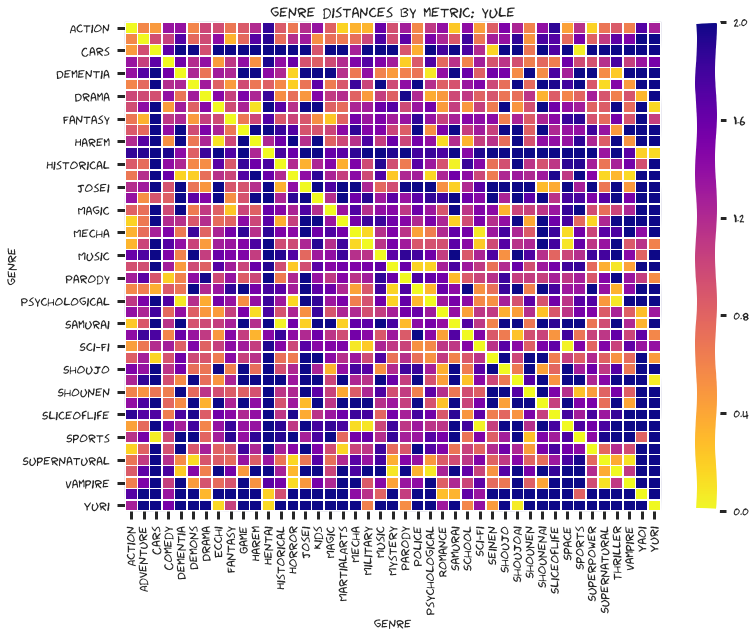

In [218]:
def show_distances(metric):
    dists = pdist(genres_animes, metric)
    dists_m = squareform(dists)
    dists_df = pd.DataFrame(dists_m)
    dists_df.columns = genres_animes.index
    dists_df.index = genres_animes.index

    f, ax = plt.subplots(figsize=(12, 9))
    plt.title('genre distances by metric: {}'.format(metric))
    sns.heatmap(dists_df, linewidths=.5, cmap=plt.cm.plasma_r)
    plt.show()
    
metrics = ['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine', 'euclidean', 'minkowski', 
        'seuclidean', 'sqeuclidean', 'dice', 'hamming', 'jaccard', 'kulsinski', 'rogerstanimoto', 'russellrao',
        'sokalmichener', 'sokalsneath', 'yule']

for metric in metrics:
    show_distances(metric)

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


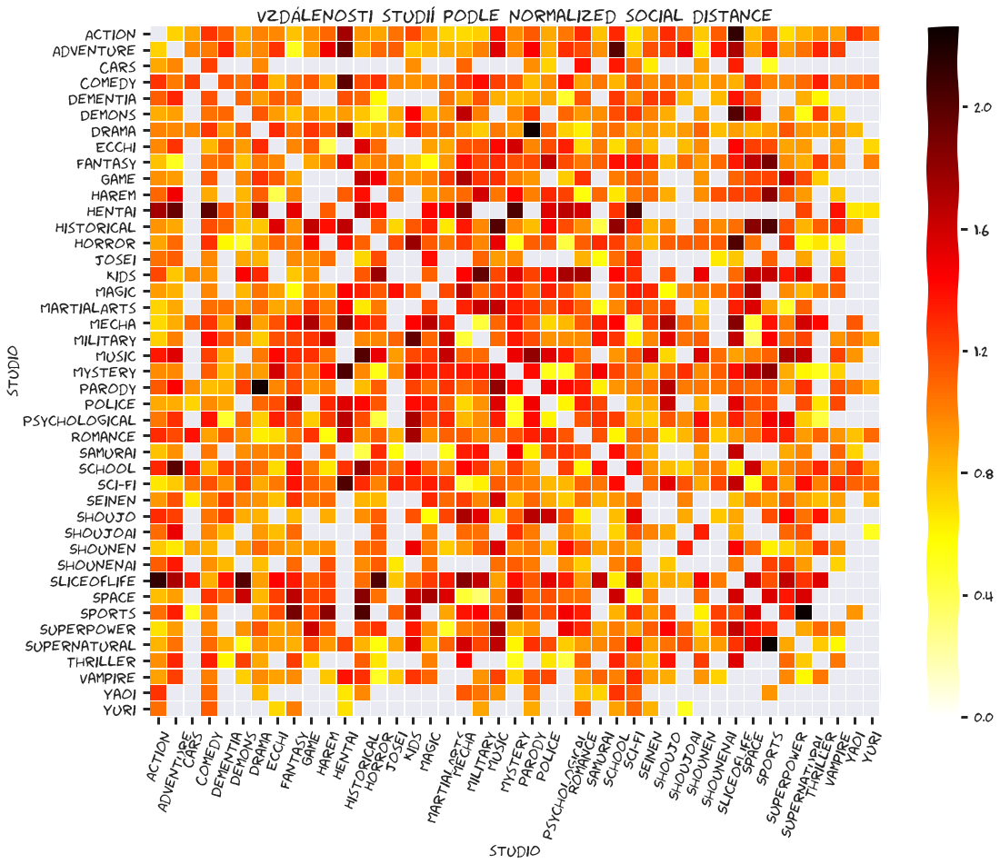

In [298]:
dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 0  # infinities mess color scale

dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

f, ax = plt.subplots(figsize=(18, 14))
mask = np.zeros_like(dists_df, dtype=np.bool)
mask[dists_df == 0] = True
sns.heatmap(dists_df, mask=mask, linewidths=.5, cmap=plt.cm.hot_r)
plt.xticks(rotation=70)
plt.title('Vzdálenosti studií podle normalized social distance')
plt.ylabel('studio')
plt.xlabel('studio')
plt.savefig('graphs/prvky-vzdalenosti-heatmap-NSD.png', bbox_inches="tight")

6

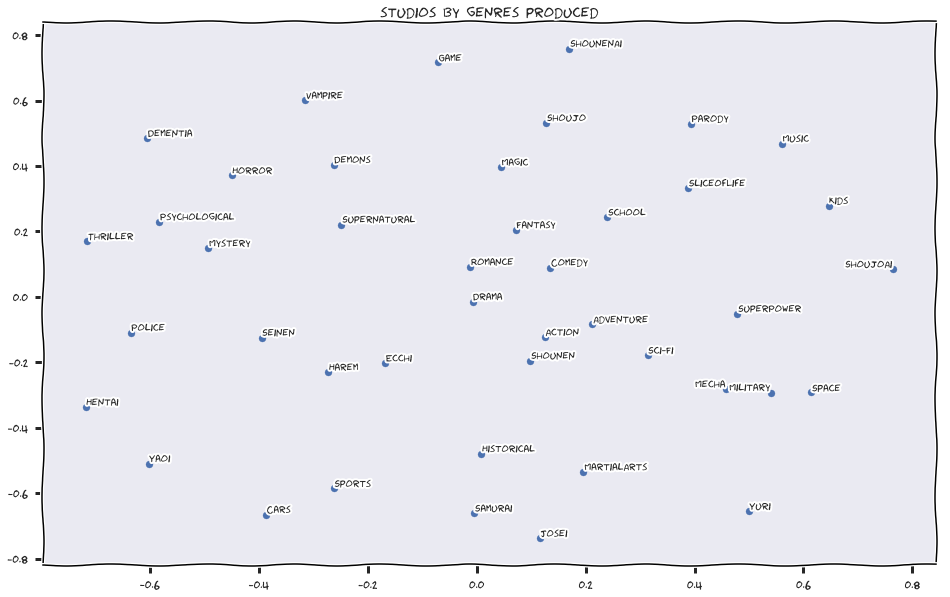

In [303]:
%matplotlib inline

dists = pdist(genres_animes, 'cosine')
dists_m = squareform(dists) ** 3
embedder = manifold.MDS(2, max_iter=2000, n_init=5, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)
# need to agregate animes_studios because it does not contain duplicities because of genres
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1])
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

6

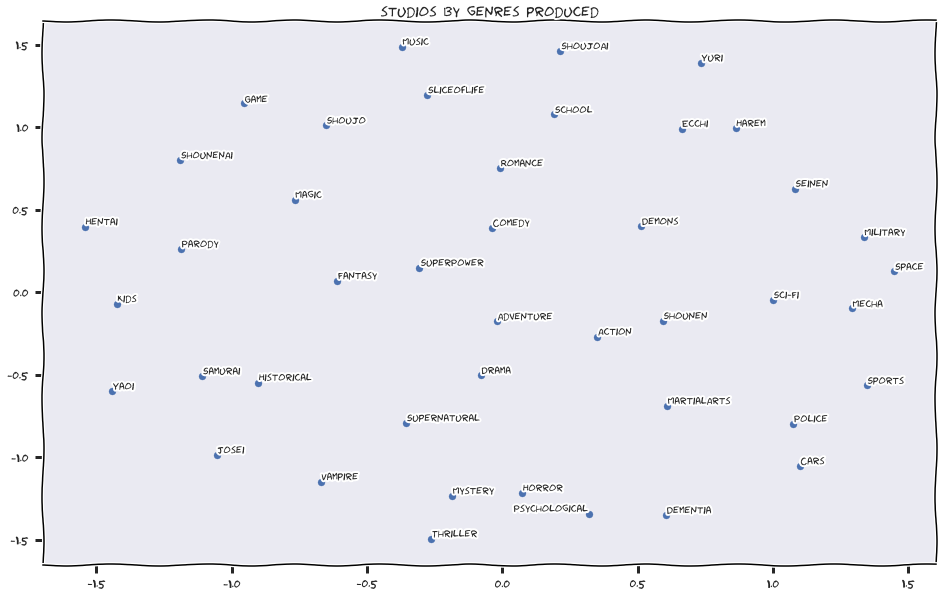

In [221]:
%matplotlib inline

dists = pdist(genres_animes, lambda x, y: 2 - ((x & y).sum() / x.sum() + (x & y).sum() / y.sum()))
dists_m = squareform(dists)
embedder = manifold.MDS(2, max_iter=2000, n_init=5, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)
# need to agregate animes_studios because it does not contain duplicities because of genres
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1])
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

<IPython.core.display.Javascript object>


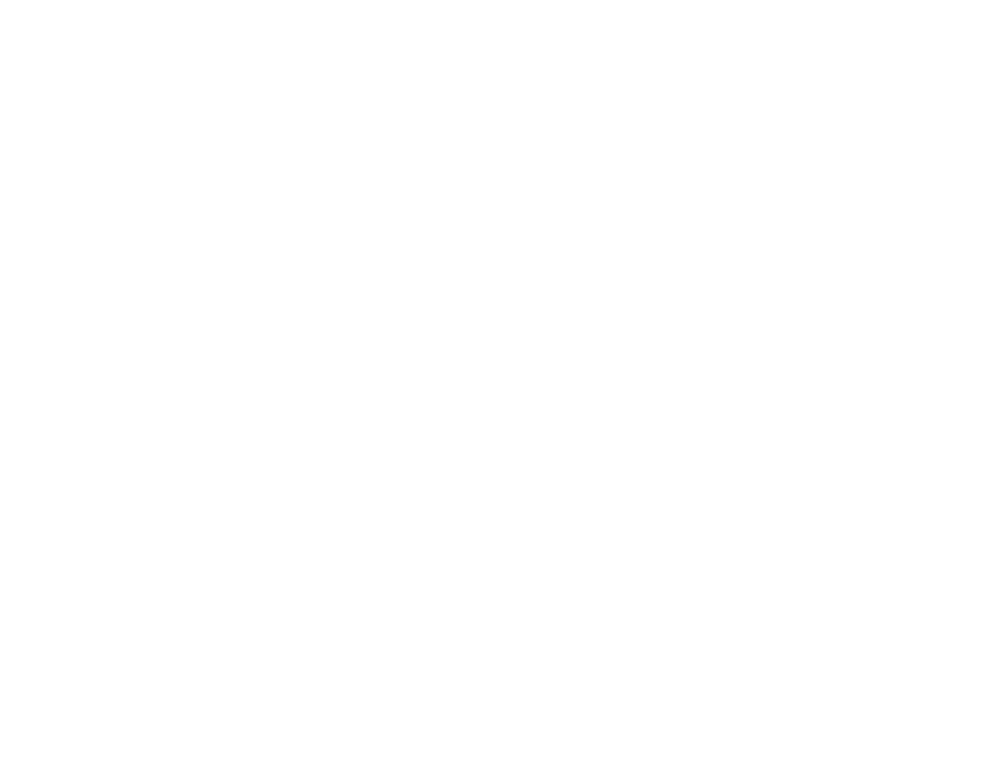

<IPython.core.display.Javascript object>


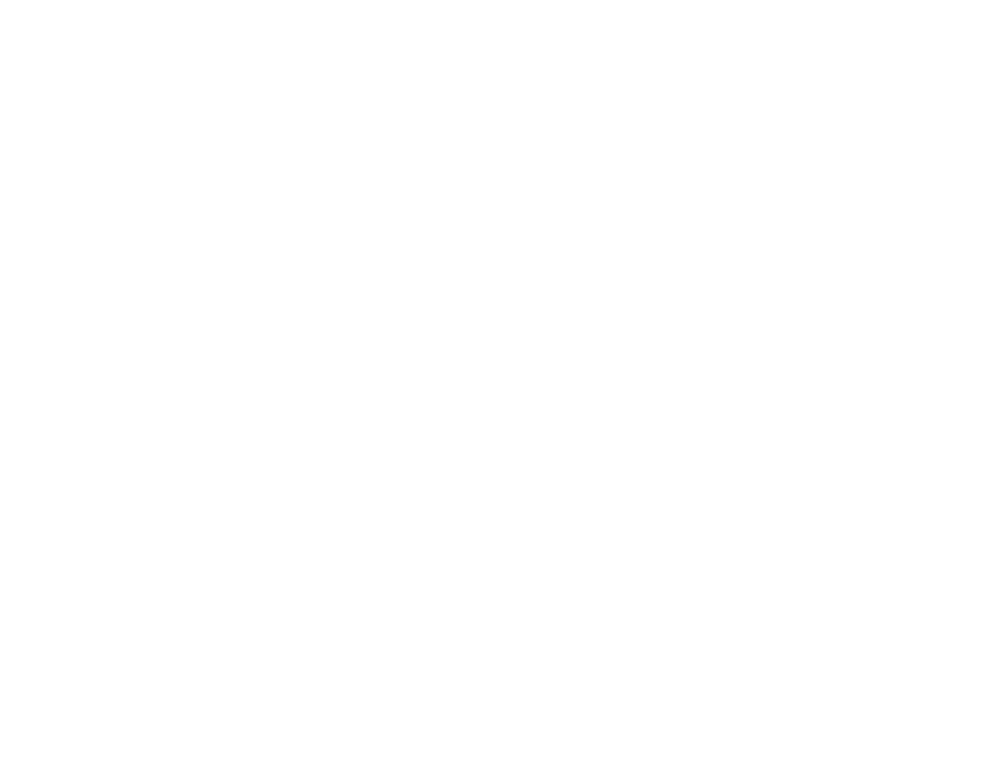

In [222]:
%matplotlib notebook

embedder = manifold.MDS(3, max_iter=2000, n_init=10, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)

plt.figure(figsize=(13, 10))

ax = plt.axes(projection='3d')
ax.scatter3D(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2])
for i, txt in enumerate(genres_animes.index):
    ax.text(embeddings[i, 0], embeddings[i, 1], embeddings[i, 2], txt)
plt.show()

In [223]:
embeddings

array([[-0.28321967, -0.46694201,  0.32883454],
       [-0.09313968, -0.83790077,  0.63561241],
       [-1.02667785,  0.60596712,  0.7539849 ],
       [ 0.22470649,  0.34570603,  0.29723143],
       [-0.56031117, -0.92937701, -0.88735199],
       [ 0.29089497, -1.21345467, -0.31083186],
       [ 0.03356786,  0.02391191, -0.61963852],
       [ 0.40652971,  0.55412259,  1.02586077],
       [ 0.51961919, -0.64787463,  0.51810409],
       [-0.18223093, -1.38357804,  0.23278706],
       [ 0.8830621 ,  0.45669659,  0.85447959],
       [-0.61726229,  1.02636402, -0.83889355],
       [ 0.92052737, -0.83622904, -0.25522224],
       [-0.09378307, -0.63315711, -1.11499822],
       [ 0.7831783 ,  0.47514308, -0.98750114],
       [-0.18585279,  1.02343958,  0.89221739],
       [ 0.92240526, -0.43595145,  0.7635041 ],
       [ 0.31300653, -0.43352274,  1.25060312],
       [-1.18215559, -0.27106344,  0.38821955],
       [-0.96809847, -0.86186276,  0.01608139],
       [ 1.3442819 ,  0.41565667, -0.260

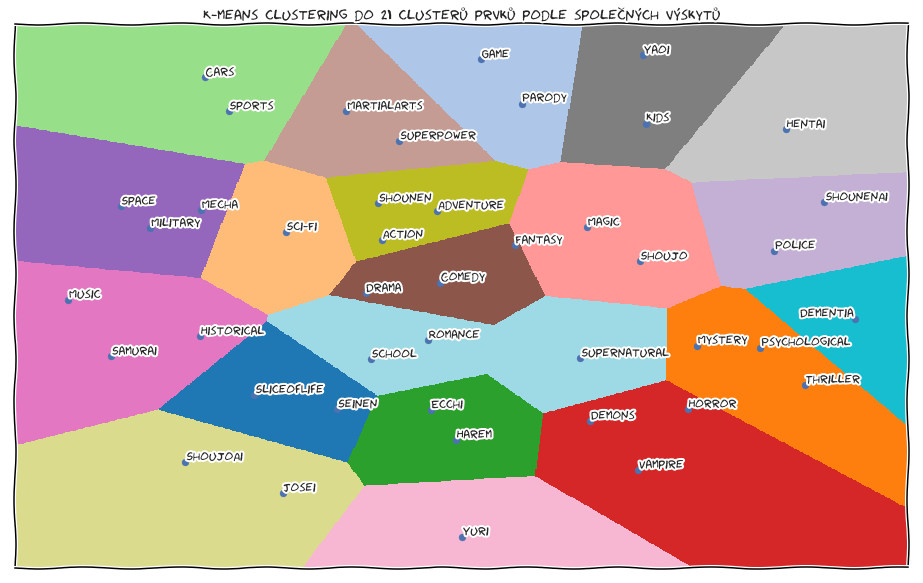

In [309]:
%matplotlib inline
from sklearn.cluster import KMeans

dists = pdist(genres_animes, 'cosine')
dists_m = squareform(dists) ** 3

embedder = manifold.MDS(2, max_iter=2000, n_init=5, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)

kmeans = KMeans(init='k-means++', n_clusters=21, n_init=10)
kmeans.fit(embeddings)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = .002     # point in the mesh [x_min, x_max]x[y_min, y_max].

# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = embeddings[:, 0].min() - 0.1, embeddings[:, 0].max() + 0.1
y_min, y_max = embeddings[:, 1].min() - 0.1, embeddings[:, 1].max() + 0.1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(16, 10))
plt.clf()
plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap=plt.cm.tab20,
           aspect='auto', origin='lower')

plt.scatter(embeddings[:, 0], embeddings[:, 1])
#plt.plot(embeddings[:, 0], embeddings[:, 1], 'k.', markersize=2)
# Plot the centroids as a white X
plt.title('K-means clustering on genres')

texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt, size='large') for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.title('K-means clustering do 21 clusterů prvků podle společných výskytů')
plt.savefig('graphs/prvky-vzdalenosti-kmeans.png', bbox_inches="tight")

In [313]:
from scipy.cluster.hierarchy import dendrogram, linkage

# generate the linkage matrix 
# squareform transfers between condensed and redundant distance form
dists = pdist(genres_animes, 'cosine')
dists_m = squareform(dists) ** 3
Z = linkage(squareform(dists_m), 'ward')

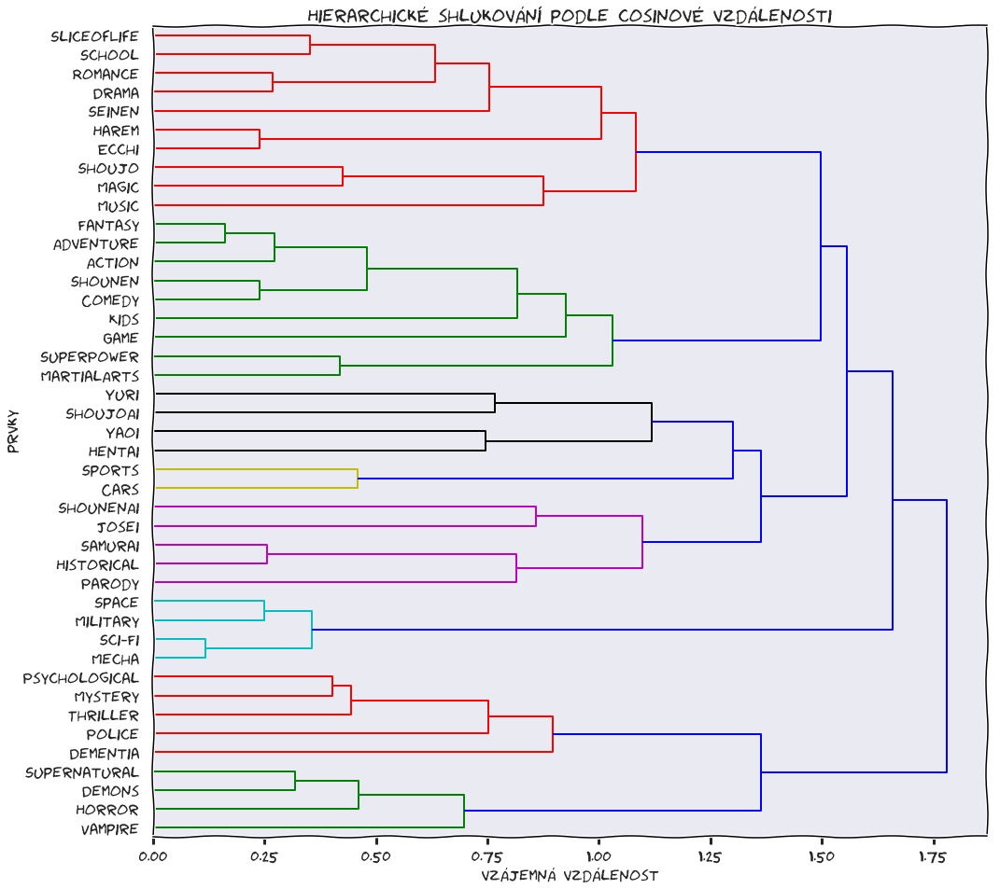

In [318]:
# calculate full dendrogram
plt.figure(figsize=(16, 16))
plt.title('Hierarchické shlukování podle cosinové vzdálenosti')
plt.xlabel('vzájemná vzdálenost')
plt.ylabel('prvky')
dendrogram(
    Z,
#    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size='large',  # font size for the x axis labels
    orientation='right',
    labels=genres_animes.index
)
plt.savefig('graphs/prvky-vzdalenosti-hierarchical.png', bbox_inches="tight")

In [227]:
np.log(0)

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


-inf

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


6

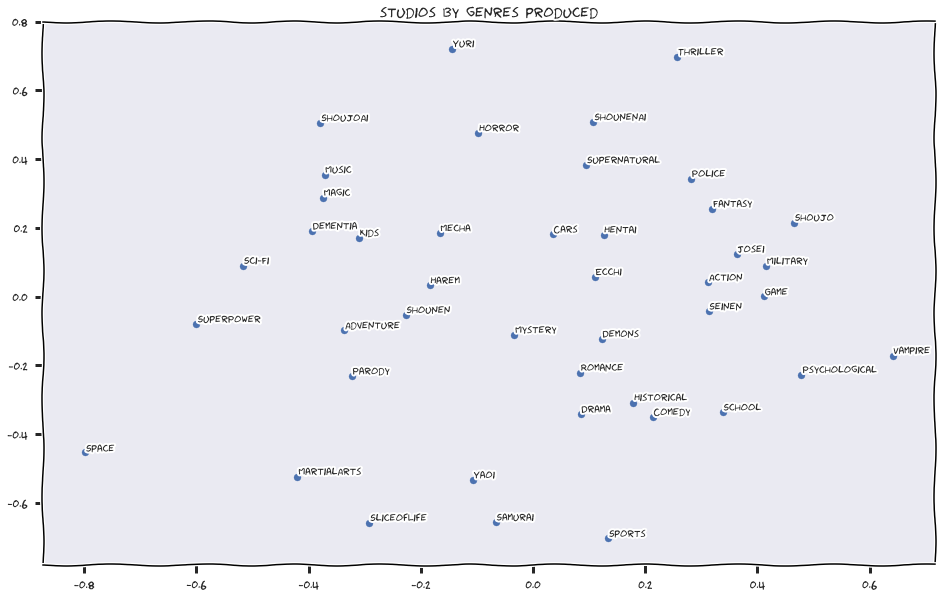

In [228]:
%matplotlib inline

dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 0  # I need to set infinities to zeros, then it handles infinities as missing data, which is wanted
embedder = manifold.MDS(2, metric=False, max_iter=2000, n_init=5, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)
# need to agregate animes_studios because it does not contain duplicities because of genres
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1])
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


469

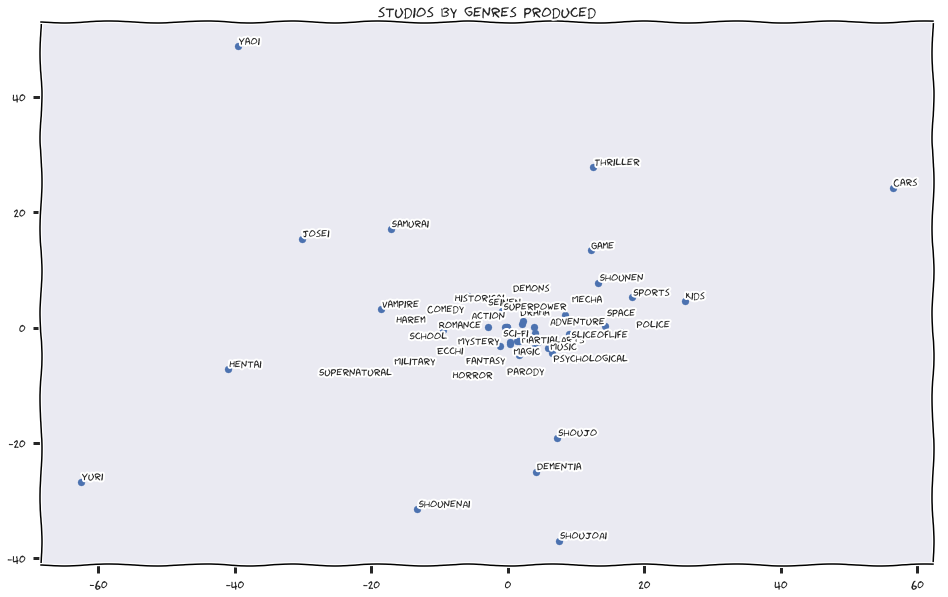

In [229]:
%matplotlib inline

dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 100
embedder = manifold.MDS(2, metric=True, max_iter=2000, n_init=5, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)
# need to agregate animes_studios because it does not contain duplicities because of genres
plt.figure(figsize=(16, 10))
plt.scatter(embeddings[:, 0], embeddings[:, 1])
plt.title("studios by genres produced")
texts = [plt.text(embeddings[i, 0], embeddings[i, 1], txt) for i, txt in enumerate(genres_animes.index)]
adjust_text(texts)

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


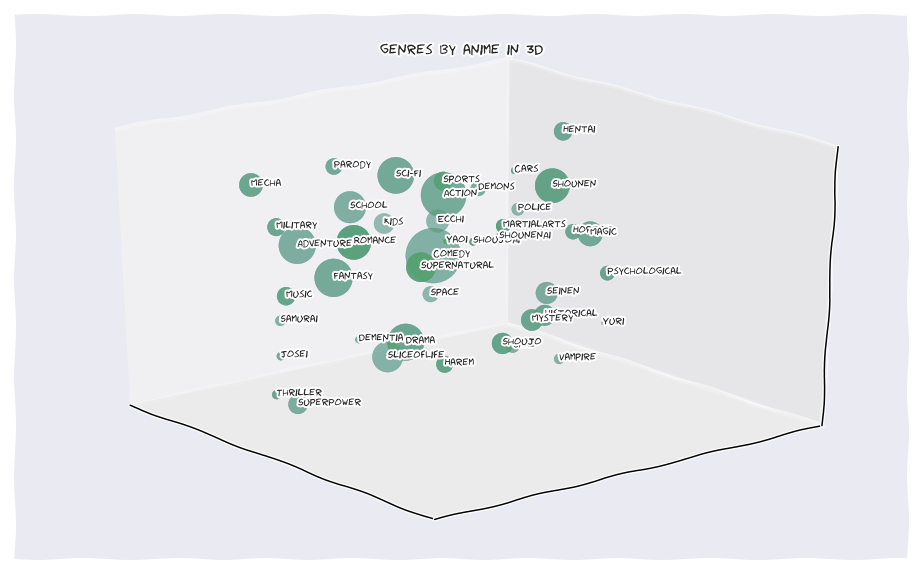

In [230]:
%matplotlib inline

dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 0  # I need to set infinities to zeros, then it handles infinities as missing data, which is wanted
embedder = manifold.MDS(3, metric=False, max_iter=2000, n_init=10, dissimilarity='precomputed')
embeddings = embedder.fit_transform(dists_m)

fig = plt.figure(figsize=(16, 10))
ax = plt.axes(projection='3d')
plt.title("genres by anime in 3D")
points_3d_to_gif(embeddings, genres_animes.index, 'genres-NSD-MSD', ax, genres_animes.sum(axis=1))

In [231]:
# now using networkx to visualize it
#df = pd.DataFrame(ints, columns=['weight', 'cost'])
dists = pdist(genres_animes, lambda x, y: nsd(x, y))
pairs = np.array(list(combinations(genres_animes.index, 2)))

#nodes = pd.DataFrame({'id': studios_genres.index, 'label': studios_genres.index})
edges = pd.DataFrame({'source': pairs[:, 0], 'target': pairs[:, 1], 'weight': dists})
edges = edges[edges['weight'] != np.inf]

G = nx.from_pandas_dataframe(edges, 'source', 'target', 'weight')

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


/home.others/eb/easybuild/software/scikit-image/0.13.1-goolfc-2018a-Python-3.6.4/lib/python3.6/site-packages/networkx-1.11-py3.6.egg/networkx/drawing/nx_pylab.py:126: MatplotlibDeprecationWarning: pyplot.hold is deprecated.
    Future behavior will be consistent with the long-time default:
    plot commands add elements without first clearing the
    Axes and/or Figure.
  b = plt.ishold()
/home.others/eb/easybuild/software/scikit-image/0.13.1-goolfc-2018a-Python-3.6.4/lib/python3.6/site-packages/networkx-1.11-py3.6.egg/networkx/drawing/nx_pylab.py:522: MatplotlibDeprecationWarning: The is_string_like function was deprecated in version 2.1.
  if not cb.is_string_like(edge_color) \
/home.others/eb/easybuild/software/scikit-image/0.13.1-goolfc-2018a-Python-3.6.4/lib/python3.6/site-packages/networkx-1.11-py3.6.egg/networkx/drawing/nx_pylab.py:543: MatplotlibDeprecationWarning: The is_string_like function was deprecated in version 2.1.
  if cb.is_string_like(edge_color) or len(edge_color) =

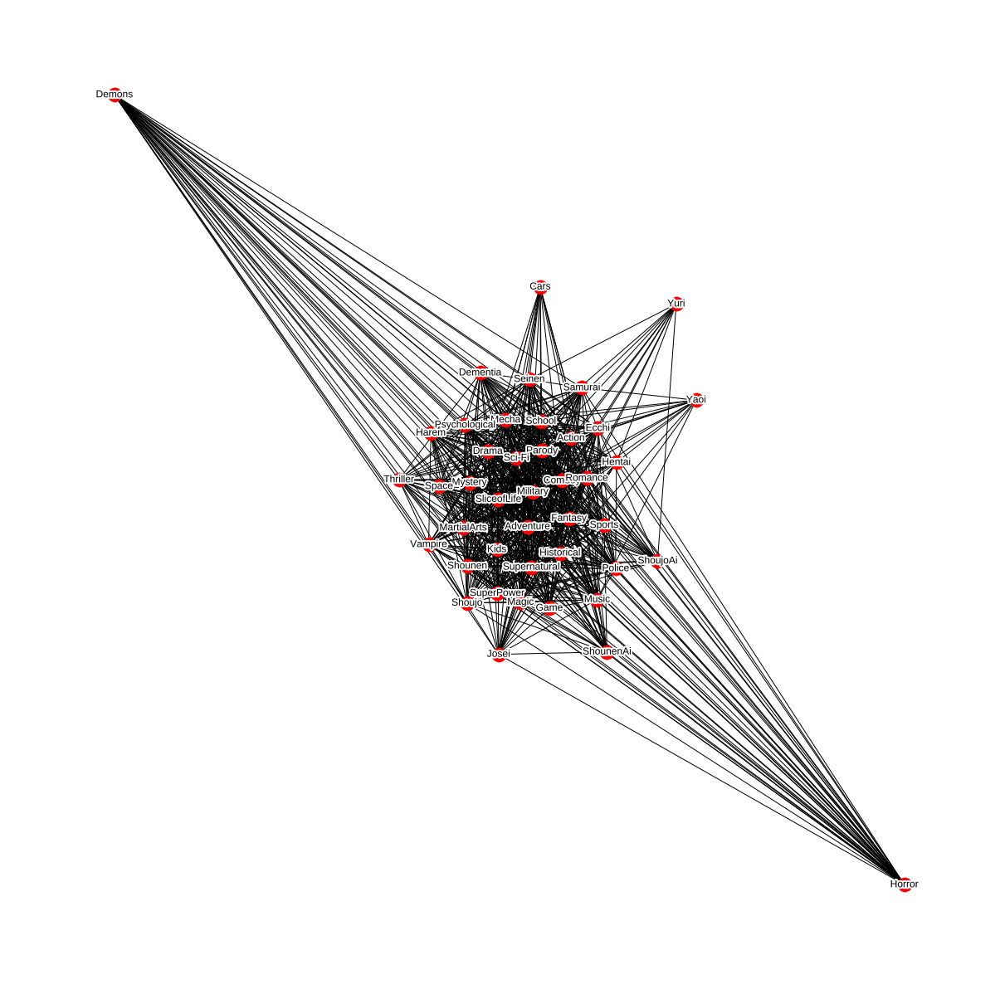

In [232]:
pos = nx.fruchterman_reingold_layout(G, dim=2, weight='weight', iterations=5000)
plt.figure(figsize=(16, 16))
nx.draw(G, pos, with_labels=True)
plt.show()

In [233]:
G['Action']['Adventure']['weight']

0.7330849073516265

In [234]:
nodes = pd.DataFrame({'id': genres_animes.index, 'label': genres_animes.index})
edges['type'] = 'undirected'
    
nodes.to_csv('genres_animes_nodes.csv', index=False, sep=',', encoding='utf-8')
edges.to_csv('genres_animes_edges_NSD.csv', index=False, sep=',', encoding='utf-8')

/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  
/home.stud/racinmat/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  if __name__ == '__main__':


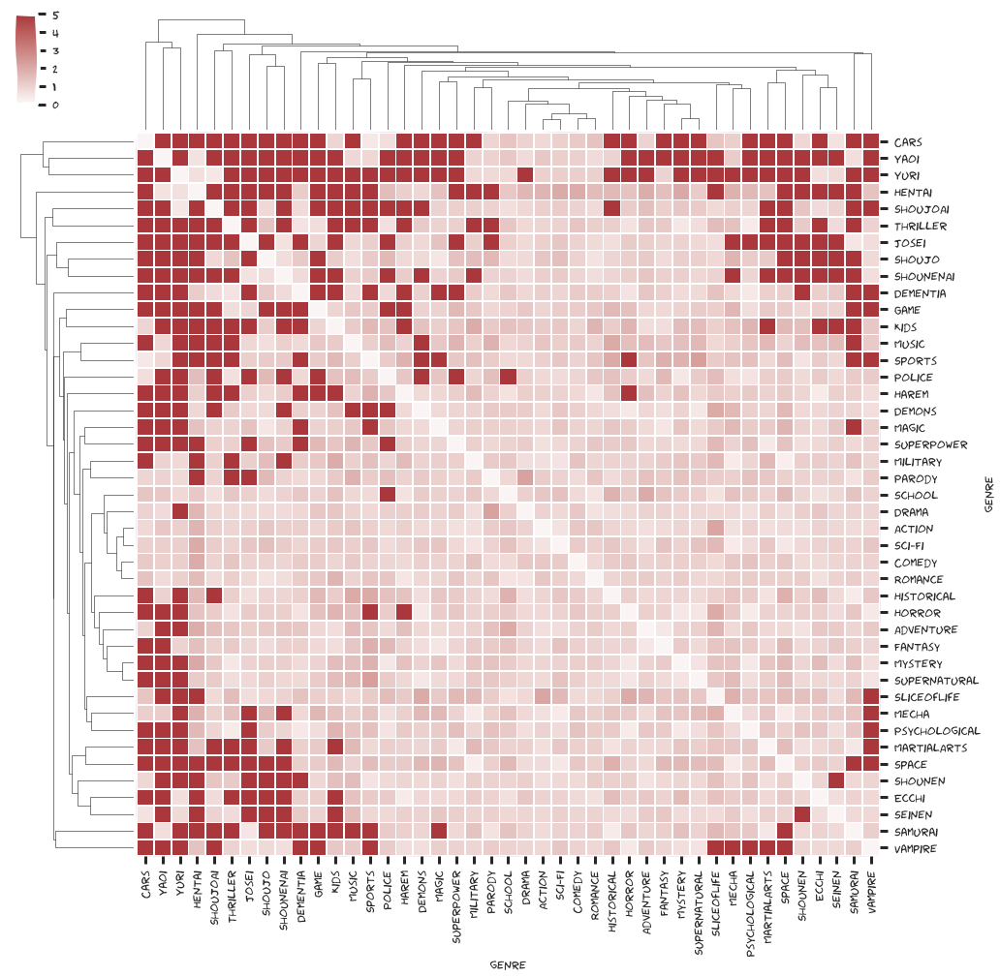

In [235]:
# using precomputed distance matrix https://stackoverflow.com/questions/38705359/how-to-give-sns-clustermap-a-precomputed-distance-matrix
dists = pdist(genres_animes, lambda x, y: nsd(x, y))
dists_m = squareform(dists)
dists_m[dists_m == np.inf] = 5
dists_df = pd.DataFrame(dists_m)
dists_df.columns = genres_animes.index
dists_df.index = genres_animes.index

linkage = linkage(dists_m, method='average')

sns.clustermap(dists_df, center=0, cmap="vlag", row_linkage=linkage, col_linkage=linkage,
               linewidths=.75, figsize=(16, 16))

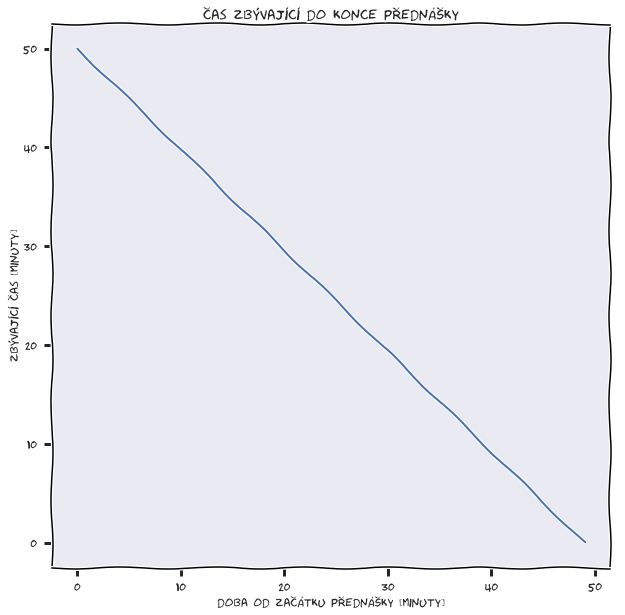

In [292]:
plt.figure(figsize=(10, 10))
plt.plot(50 - np.linspace(0, 50, 50))
plt.title('čas zbývající do konce přednášky')
plt.ylabel('zbývající čas [minuty]')
plt.xlabel('doba od začátku přednášky [minuty]')
plt.savefig('graphs/graf-konec-rednasky.png', bbox_inches="tight")